In [1]:
# mount the drive for latter importing the datasets
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Dictionaries

In [2]:
!pip install statannotations

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 292.8/292.8 kB 11.9 MB/s eta 0:00:00
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.12.2
    Uninstalling seaborn-0.12.2:
      Successfully uninstalled seaborn-0.12.2


In [3]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.6/572.6 kB 18.1 MB/s eta 0:00:00


In [4]:
#basic
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import statsmodels.formula.api as smf

#Random Forest + NN_utils
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor, XGBClassifier
import shap
from sklearn.metrics import r2_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from keras.utils import np_utils
from sklearn.preprocessing import LabelEncoder
from sklearn import metrics
from sklearn.feature_selection import mutual_info_classif
from tensorflow.keras.layers import Dropout
from itertools import combinations
from statannotations.Annotator import Annotator

#NN
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
import keras

#Load the datasets

In [5]:
patients = ["135_S_4356", "135_S_4309", "135_S_4281", "131_S_0123", "129_S_4422", "129_S_4396", "129_S_4371", "129_S_4369", "129_S_4287", "129_S_2347", "129_S_2332", "129_S_0778", "127_S_5266", "127_S_5228", "127_S_5185", "127_S_5132", "127_S_5095", "127_S_5067", "127_S_5058", "127_S_5056", "127_S_5028", "127_S_4992", "127_S_4940", "127_S_4928", "127_S_4844", "127_S_4843", "127_S_4765", "127_S_4645", "127_S_4624", "127_S_4604", "127_S_4500", "127_S_4301", "127_S_4240", "127_S_4210", "127_S_4198", "127_S_4197", "127_S_4148", "127_S_2234", "127_S_2213", "126_S_5243", "126_S_5214", "126_S_4896", "126_S_4891", "126_S_4712", "126_S_4686", "126_S_4675", "126_S_4514", "126_S_4507", "126_S_4494", "126_S_4458", "126_S_2407", "126_S_2405", "126_S_2360", "109_S_4594", "109_S_4531", "109_S_4499", "109_S_4455", "109_S_4380", "109_S_2200", "099_S_4565", "099_S_4498", "099_S_4480", "099_S_4463", "099_S_4205", "099_S_4157", "099_S_4104", "099_S_4086", "099_S_4076", "099_S_2146", "099_S_2063", "098_S_4506", "098_S_4275", "098_S_4215", "098_S_4201", "098_S_4018", "098_S_4003", "098_S_2079", "098_S_2052", "098_S_2047", "094_S_4858", "094_S_4649", "094_S_4630", "094_S_4560", "094_S_4503", "094_S_4282", "094_S_4234", "094_S_4162", "094_S_4089", "094_S_2367", "094_S_2238", "094_S_2216", "094_S_2201", "057_S_5292", "057_S_4909", "057_S_4897", "057_S_4888", "057_S_2398", "057_S_0934", "052_S_5062", "052_S_4959", "052_S_4945", "052_S_4944", "052_S_4885", "052_S_4807", "052_S_4626", "052_S_2249", "052_S_1352", "052_S_1346", "052_S_0671", "029_S_5219", "029_S_5166", "029_S_5158", "029_S_4652", "029_S_4585", "029_S_4385", "029_S_4384", "029_S_4307", "029_S_4290", "029_S_4279", "027_S_5277", "027_S_5197", "027_S_5169", "027_S_5127", "027_S_5118", "027_S_5110", "027_S_5109", "027_S_5093", "027_S_5083", "027_S_5079", "027_S_4964", "027_S_4962", "027_S_4955", "027_S_4938", "027_S_4936", "027_S_4926", "027_S_4919", "027_S_4873", "027_S_4869", "027_S_4802", "027_S_4801", "027_S_4757", "027_S_4729", "027_S_2336", "027_S_2245", "027_S_2219", "027_S_2183", "021_S_5237", "021_S_5236", "021_S_5194", "021_S_5177", "021_S_5129", "021_S_5099", "021_S_4924", "021_S_4857", "021_S_4744", "021_S_4718", "021_S_4659", "021_S_4558", "021_S_4421", "021_S_4419", "021_S_4402", "021_S_4335", "021_S_4276", "021_S_4254", "021_S_4245", "021_S_2142", "021_S_2125", "021_S_2124", "021_S_2100", "021_S_2077", "016_S_5251", "016_S_5057", "016_S_5032", "016_S_5031", "016_S_5007", "016_S_4952", "016_S_4951", "016_S_4902", "016_S_4887", "016_S_4688", "016_S_4646", "016_S_4638", "016_S_4591", "016_S_4584", "016_S_4583", "016_S_4353", "016_S_4121", "016_S_4097", "016_S_4009", "016_S_2031", "007_S_5265", "007_S_5196", "007_S_4911", "007_S_4637", "007_S_4620", "007_S_4568", "007_S_4516", "007_S_4488", "007_S_4467", "007_S_4387", "007_S_4272", "007_S_2394", "007_S_2106", "005_S_5119", "005_S_5038", "005_S_4910", "005_S_4707", "005_S_4185", "005_S_4168", "005_S_2390", "005_S_0610", "003_S_5187", "003_S_5165", "003_S_5130", "003_S_4900", "003_S_4892", "003_S_4872", "003_S_4644", "003_S_4555", "003_S_4441", "003_S_4373", "003_S_4350", "003_S_4288", "003_S_4136", "003_S_4119", "003_S_4081", "003_S_2374", "003_S_1074", "003_S_0908"]

patients_create_dict = ["021_S_2142", "021_S_5177", "021_S_5194", "021_S_5236", "027_S_5169", "052_S_1346", "057_S_5292"]

patients_2 = ["131_S_0123", "129_S_0778", "052_S_0671", "052_S_1346", "052_S_4807", "052_S_4945", "127_S_2234", "016_S_4121", "003_S_4288", "052_S_1352", "127_S_4500", "007_S_4568", "094_S_4089", "126_S_4494", "003_S_1074", "027_S_2219", "027_S_2245", "098_S_2079", "057_S_0934", "005_S_0610", "127_S_4148", "098_S_4003"]

cn_ad = ["131_S_0123", "129_S_0778"]
mci_ad = ["052_S_0671", "052_S_1346", "052_S_4807", "052_S_4945", "016_S_4902", "027_S_4729", "027_S_4757", "027_S_4936", "052_S_4885", "057_S_2398", "126_S_4675", "126_S_4458", "098_S_2047", "094_S_2216", "007_S_2106", "021_S_4402", "016_S_5031", "057_S_4888", "016_S_4584", "094_S_4162", "021_S_4857", "126_S_4712", "127_S_4240", "127_S_4928"]
cn_mci = ["127_S_2234", "016_S_4121", "003_S_4288", "052_S_1352", "099_S_2146", "127_S_4624", "029_S_4652", "005_S_4168", "021_S_4419", "029_S_4385", "029_S_5166", "098_S_4506", "109_S_4380", "126_S_5214"]
ad = ["127_S_4500", "007_S_4568", "094_S_4089", "126_S_4494", "127_S_4940", "021_S_4718", "003_S_4136", "027_S_4938", "052_S_4959", "127_S_5056", "027_S_4962", "027_S_4802", "127_S_4992", "127_S_5058", "007_S_4911", "127_S_5067", "005_S_4910", "005_S_4707", "005_S_5038", "016_S_4591", "027_S_4964", "127_S_5095", "003_S_4892", "005_S_5119", "127_S_5028", "126_S_4686", "016_S_5032", "027_S_4801", "029_S_4307", "052_S_5062", "016_S_5057", "016_S_4887", "003_S_5165", "021_S_4924", "003_S_5187", "007_S_5196", "016_S_4009", "016_S_4583", "016_S_5251", "098_S_4201", "098_S_4215", "003_S_4373", "094_S_4282", "016_S_4353"]
mci = ["003_S_2374", "021_S_2124", "021_S_4744", "021_S_5099", "027_S_4955", "057_S_4897", "109_S_4531", "057_S_4909", "094_S_4858", "094_S_4630", "003_S_1074", "027_S_2219", "027_S_2245", "098_S_2079", "127_S_4197", "027_S_2336", "129_S_2332", "021_S_2100", "135_S_4281", "135_S_4309", "003_S_0908", "126_S_2405", "021_S_2125", "021_S_2077", "094_S_2238", "052_S_4626", "098_S_2052", "126_S_4891", "127_S_2213", "007_S_4272", "127_S_4210", "005_S_4185", "129_S_2347", "099_S_2063", "126_S_2407", "027_S_4926", "052_S_2249", "052_S_4944", "127_S_4301", "099_S_4480", "099_S_4157", "099_S_4205", "126_S_2360", "126_S_4896", "099_S_4565", "109_S_4455", "127_S_4765", "126_S_4514", "099_S_4498", "099_S_4463", "021_S_4659", "027_S_4873", "007_S_2394", "007_S_4467", "027_S_4919", "027_S_2183", "005_S_2390", "027_S_4869", "135_S_4356", "016_S_5007", "021_S_4245", "129_S_4287", "021_S_2142", "016_S_4646", "127_S_4844", "094_S_2367", "109_S_2200", "109_S_4594", "016_S_2031", "126_S_4507"]
cn = ["021_S_5194", "021_S_5177", "021_S_5236", "027_S_5169", "057_S_5292", "007_S_5265", "016_S_4688", "021_S_5129", "027_S_5197", "027_S_5277", "029_S_4279", "029_S_5158", "126_S_5243", "127_S_5266", "029_S_5219", "057_S_0934",  "005_S_0610",  "127_S_4148",  "098_S_4003",  "098_S_4018",  "099_S_4086",  "099_S_4076",  "094_S_2201",  "021_S_4276",  "021_S_4254",  "129_S_4422",  "021_S_4335",  "021_S_4421",  "016_S_4952",  "099_S_4104",  "027_S_5109",  "027_S_5093",  "027_S_5079",  "127_S_4198",  "127_S_4604",  "029_S_4290",  "098_S_4275",  "127_S_4645",  "094_S_4560",  "007_S_4516",  "003_S_4441",  "007_S_4620",  "003_S_4350",  "094_S_4649",  "129_S_4371",  "003_S_4555",  "094_S_4503",  "003_S_4119",  "109_S_4499",  "027_S_5083",  "029_S_4585",  "027_S_5127",  "127_S_4843",  "003_S_4872",  "029_S_4384",  "016_S_4638",  "027_S_5118",  "007_S_4637",  "016_S_4951",  "129_S_4396",  "129_S_4369",  "094_S_4234",  "021_S_4558",  "003_S_4900",  "007_S_4488",  "007_S_4387",  "027_S_5110",  "016_S_4097",  "003_S_5130",  "003_S_4644",  "021_S_5237",  "003_S_4081",  "127_S_5185",  "127_S_5228",  "127_S_5132"]

matrices = pd.DataFrame()
counter = 0
for i in patients:
  try:
    docs_path = 'drive/MyDrive/TFG/matrices_correct_2/matrix' + i + '.csv'
    dataframe = pd.read_csv(docs_path, delimiter=',')
    matrices.loc[counter, "Subject"] = i

    matrices.loc[counter, "Centre"] = i[:3]

    if i in cn_ad:
      matrices.loc[counter, "group"] = "cn-ad"
      matrices.loc[counter, "group_int"] = 3
    elif i in mci_ad:
      matrices.loc[counter, "group"] = "mci-ad"
      matrices.loc[counter, "group_int"] = 4
    elif i in cn_mci:
      matrices.loc[counter, "group"] = "cn-mci"
      matrices.loc[counter, "group_int"] = 1
    elif i in ad:
      matrices.loc[counter, "group"] = "ad"
      matrices.loc[counter, "group_int"] = 5
    elif i in mci:
      matrices.loc[counter, "group"] = "mci"
      matrices.loc[counter, "group_int"] = 2
    elif i in cn:
      matrices.loc[counter, "group"] = "cn"
      matrices.loc[counter, "group_int"] = 0
  except:
    pass

  for j in dataframe.columns:
    if j != "Subject":
      matrices.loc[counter, j] = dataframe.loc[0, j]
  counter += 1

matrices = matrices.dropna()
pd.set_option('display.max_columns', None)
matrices = matrices.drop("Unnamed: 0", axis=1)
matrices.head()

,Subject,Centre,group,group_int,Comm_ratio,SC_L_avg_spl,SC_L_avg_eff,SC_R_avg_spl,SC_R_avg_eff,SC_avg_spl,SC_avg_eff,CC_Sag_area,CC_Posterior,CC_Mid_Posterior,CC_Central,CC_Mid_Anterior,CC_Anterior,BrainSegVol,EstimatedTotalIntraCranialVol,CC_ratio,SC_spl_full,SC_eff_full,Full_CC,Comm_ratio_approx,CC_ratio_area,CC_Sag_area_sqrt,TIV_cubicroot
0,135_S_4356,135,mci,2.0,0.006775,0.010360,141.689894,0.009421,154.597540,0.018272,93.302077,805.0,963.7,460.4,674.0,444.2,904.0,1090297.0,1.485182e+06,0.114634,0.009890,148.143717,3446.3,0.002320,0.275666,1.452898,2.012515
1,135_S_4309,135,mci,2.0,0.008357,0.010312,144.408852,0.009581,154.800871,0.016742,97.184456,678.0,1122.0,507.2,439.9,480.8,761.7,1079355.0,1.440140e+06,0.099371,0.009947,149.604862,3311.6,0.002299,0.253840,1.415615,2.011055
2,135_S_4281,135,mci,2.0,0.008055,0.010741,144.049697,0.010362,146.446568,0.016747,95.388819,657.0,1048.8,523.2,724.9,392.6,963.1,1059017.0,1.363123e+06,0.042419,0.010551,145.248133,3652.6,0.002680,0.251467,1.408783,2.008301
3,131_S_0123,131,cn-ad,3.0,0.007845,0.021894,140.133826,0.010600,148.266048,0.025403,89.537448,541.0,782.3,367.9,378.2,358.0,642.8,971390.0,1.257108e+06,0.084856,0.016247,144.199937,2529.2,0.002012,0.234856,1.366599,1.995798
4,129_S_4422,129,cn,0.0,0.009723,0.010512,142.240193,0.010098,143.212629,0.017725,91.866091,662.0,1025.7,460.5,401.8,387.9,822.5,1090419.0,1.293493e+06,0.110108,0.010305,142.726411,3098.4,0.002395,0.249976,1.410429,2.012531


In [6]:
matrices.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 226 entries, 0 to 228
Data columns (total 27 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Subject                        226 non-null    object 
 1   Centre                         226 non-null    object 
 2   group                          226 non-null    object 
 3   group_int                      226 non-null    float64
 4   Comm_ratio                     226 non-null    float64
 5   SC_L_avg_spl                   226 non-null    float64
 6   SC_L_avg_eff                   226 non-null    float64
 7   SC_R_avg_spl                   226 non-null    float64
 8   SC_R_avg_eff                   226 non-null    float64
 9   SC_avg_spl                     226 non-null    float64
 10  SC_avg_eff                     226 non-null    float64
 11  CC_Sag_area                    226 non-null    float64
 12  CC_Posterior                   226 non-null    flo

In [7]:
matrices.groupby("group").count()

,Subject,Centre,group_int,Comm_ratio,SC_L_avg_spl,SC_L_avg_eff,SC_R_avg_spl,SC_R_avg_eff,SC_avg_spl,SC_avg_eff,CC_Sag_area,CC_Posterior,CC_Mid_Posterior,CC_Central,CC_Mid_Anterior,CC_Anterior,BrainSegVol,EstimatedTotalIntraCranialVol,CC_ratio,SC_spl_full,SC_eff_full,Full_CC,Comm_ratio_approx,CC_ratio_area,CC_Sag_area_sqrt,TIV_cubicroot
group,,,,,,,,,,,,,,,,,,,,,,,,,,
ad,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44
cn,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73
cn-ad,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
cn-mci,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14
mci,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69
mci-ad,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24


In [8]:
patients = ["135_S_4356", "135_S_4309", "135_S_4281", "131_S_0123", "129_S_4422", "129_S_4396", "129_S_4371", "129_S_4369", "129_S_4287", "129_S_2347", "129_S_2332", "129_S_0778", "127_S_5266", "127_S_5228", "127_S_5185", "127_S_5132", "127_S_5095", "127_S_5067", "127_S_5058", "127_S_5056", "127_S_5028", "127_S_4992", "127_S_4940", "127_S_4928", "127_S_4844", "127_S_4843", "127_S_4765", "127_S_4645", "127_S_4624", "127_S_4604", "127_S_4500", "127_S_4301", "127_S_4240", "127_S_4210", "127_S_4198", "127_S_4197", "127_S_4148", "127_S_2234", "127_S_2213", "126_S_5243", "126_S_5214", "126_S_4896", "126_S_4891", "126_S_4712", "126_S_4686", "126_S_4675", "126_S_4514", "126_S_4507", "126_S_4494", "126_S_4458", "126_S_2407", "126_S_2405", "126_S_2360", "109_S_4594", "109_S_4531", "109_S_4499", "109_S_4455", "109_S_4380", "109_S_2200", "099_S_4565", "099_S_4498", "099_S_4480", "099_S_4463", "099_S_4205", "099_S_4157", "099_S_4104", "099_S_4086", "099_S_4076", "099_S_2146", "099_S_2063", "098_S_4506", "098_S_4275", "098_S_4215", "098_S_4201", "098_S_4018", "098_S_4003", "098_S_2079", "098_S_2052", "098_S_2047", "094_S_4858", "094_S_4649", "094_S_4630", "094_S_4560", "094_S_4503", "094_S_4282", "094_S_4234", "094_S_4162", "094_S_4089", "094_S_2367", "094_S_2238", "094_S_2216", "094_S_2201", "057_S_5292", "057_S_4909", "057_S_4897", "057_S_4888", "057_S_2398", "057_S_0934", "052_S_5062", "052_S_4959", "052_S_4945", "052_S_4944", "052_S_4885", "052_S_4807", "052_S_4626", "052_S_2249", "052_S_1352", "052_S_1346", "052_S_0671", "029_S_5219", "029_S_5166", "029_S_5158", "029_S_4652", "029_S_4585", "029_S_4385", "029_S_4384", "029_S_4307", "029_S_4290", "029_S_4279", "027_S_5277", "027_S_5197", "027_S_5169", "027_S_5127", "027_S_5118", "027_S_5110", "027_S_5109", "027_S_5093", "027_S_5083", "027_S_5079", "027_S_4964", "027_S_4962", "027_S_4955", "027_S_4938", "027_S_4936", "027_S_4926", "027_S_4919", "027_S_4873", "027_S_4869", "027_S_4802", "027_S_4801", "027_S_4757", "027_S_4729", "027_S_2336", "027_S_2245", "027_S_2219", "027_S_2183", "021_S_5237", "021_S_5236", "021_S_5194", "021_S_5177", "021_S_5129", "021_S_5099", "021_S_4924", "021_S_4857", "021_S_4744", "021_S_4718", "021_S_4659", "021_S_4558", "021_S_4421", "021_S_4419", "021_S_4402", "021_S_4335", "021_S_4276", "021_S_4254", "021_S_4245", "021_S_2142", "021_S_2125", "021_S_2124", "021_S_2100", "021_S_2077", "016_S_5251", "016_S_5057", "016_S_5032", "016_S_5031", "016_S_5007", "016_S_4952", "016_S_4951", "016_S_4902", "016_S_4887", "016_S_4688", "016_S_4646", "016_S_4638", "016_S_4591", "016_S_4584", "016_S_4583", "016_S_4353", "016_S_4121", "016_S_4097", "016_S_4009", "016_S_2031", "007_S_5265", "007_S_5196", "007_S_4911", "007_S_4637", "007_S_4620", "007_S_4568", "007_S_4516", "007_S_4488", "007_S_4467", "007_S_4387", "007_S_4272", "007_S_2394", "007_S_2106", "005_S_5119", "005_S_5038", "005_S_4910", "005_S_4707", "005_S_4185", "005_S_4168", "005_S_2390", "005_S_0610", "003_S_5187", "003_S_5165", "003_S_5130", "003_S_4900", "003_S_4892", "003_S_4872", "003_S_4644", "003_S_4555", "003_S_4441", "003_S_4373", "003_S_4350", "003_S_4288", "003_S_4136", "003_S_4119", "003_S_4081", "003_S_2374", "003_S_1074", "003_S_0908"]

patients_create_dict = ["021_S_2142", "021_S_5177", "021_S_5194", "021_S_5236", "027_S_5169", "052_S_1346", "057_S_5292"]

patients_2 = ["131_S_0123", "129_S_0778", "052_S_0671", "052_S_1346", "052_S_4807", "052_S_4945", "127_S_2234", "016_S_4121", "003_S_4288", "052_S_1352", "127_S_4500", "007_S_4568", "094_S_4089", "126_S_4494", "003_S_1074", "027_S_2219", "027_S_2245", "098_S_2079", "057_S_0934", "005_S_0610", "127_S_4148", "098_S_4003"]

cn_ad = ["131_S_0123", "129_S_0778"]
mci_ad = ["052_S_0671", "052_S_1346", "052_S_4807", "052_S_4945", "016_S_4902", "027_S_4729", "027_S_4757", "027_S_4936", "052_S_4885", "057_S_2398", "126_S_4675", "126_S_4458", "098_S_2047", "094_S_2216", "007_S_2106", "021_S_4402", "016_S_5031", "057_S_4888", "016_S_4584", "094_S_4162", "021_S_4857", "126_S_4712", "127_S_4240", "127_S_4928"]
cn_mci = ["127_S_2234", "016_S_4121", "003_S_4288", "052_S_1352", "099_S_2146", "127_S_4624", "029_S_4652", "005_S_4168", "021_S_4419", "029_S_4385", "029_S_5166", "098_S_4506", "109_S_4380", "126_S_5214"]
ad = ["127_S_4500", "007_S_4568", "094_S_4089", "126_S_4494", "127_S_4940", "021_S_4718", "003_S_4136", "027_S_4938", "052_S_4959", "127_S_5056", "027_S_4962", "027_S_4802", "127_S_4992", "127_S_5058", "007_S_4911", "127_S_5067", "005_S_4910", "005_S_4707", "005_S_5038", "016_S_4591", "027_S_4964", "127_S_5095", "003_S_4892", "005_S_5119", "127_S_5028", "126_S_4686", "016_S_5032", "027_S_4801", "029_S_4307", "052_S_5062", "016_S_5057", "016_S_4887", "003_S_5165", "021_S_4924", "003_S_5187", "007_S_5196", "016_S_4009", "016_S_4583", "016_S_5251", "098_S_4201", "098_S_4215", "003_S_4373", "094_S_4282", "016_S_4353"]
mci = ["003_S_2374", "021_S_2124", "021_S_4744", "021_S_5099", "027_S_4955", "057_S_4897", "109_S_4531", "057_S_4909", "094_S_4858", "094_S_4630", "003_S_1074", "027_S_2219", "027_S_2245", "098_S_2079", "127_S_4197", "027_S_2336", "129_S_2332", "021_S_2100", "135_S_4281", "135_S_4309", "003_S_0908", "126_S_2405", "021_S_2125", "021_S_2077", "094_S_2238", "052_S_4626", "098_S_2052", "126_S_4891", "127_S_2213", "007_S_4272", "127_S_4210", "005_S_4185", "129_S_2347", "099_S_2063", "126_S_2407", "027_S_4926", "052_S_2249", "052_S_4944", "127_S_4301", "099_S_4480", "099_S_4157", "099_S_4205", "126_S_2360", "126_S_4896", "099_S_4565", "109_S_4455", "127_S_4765", "126_S_4514", "099_S_4498", "099_S_4463", "021_S_4659", "027_S_4873", "007_S_2394", "007_S_4467", "027_S_4919", "027_S_2183", "005_S_2390", "027_S_4869", "135_S_4356", "016_S_5007", "021_S_4245", "129_S_4287", "021_S_2142", "016_S_4646", "127_S_4844", "094_S_2367", "109_S_2200", "109_S_4594", "016_S_2031", "126_S_4507"]
cn = ["021_S_5194", "021_S_5177", "021_S_5236", "027_S_5169", "057_S_5292", "007_S_5265", "016_S_4688", "021_S_5129", "027_S_5197", "027_S_5277", "029_S_4279", "029_S_5158", "126_S_5243", "127_S_5266", "029_S_5219", "057_S_0934",  "005_S_0610",  "127_S_4148",  "098_S_4003",  "098_S_4018",  "099_S_4086",  "099_S_4076",  "094_S_2201",  "021_S_4276",  "021_S_4254",  "129_S_4422",  "021_S_4335",  "021_S_4421",  "016_S_4952",  "099_S_4104",  "027_S_5109",  "027_S_5093",  "027_S_5079",  "127_S_4198",  "127_S_4604",  "029_S_4290",  "098_S_4275",  "127_S_4645",  "094_S_4560",  "007_S_4516",  "003_S_4441",  "007_S_4620",  "003_S_4350",  "094_S_4649",  "129_S_4371",  "003_S_4555",  "094_S_4503",  "003_S_4119",  "109_S_4499",  "027_S_5083",  "029_S_4585",  "027_S_5127",  "127_S_4843",  "003_S_4872",  "029_S_4384",  "016_S_4638",  "027_S_5118",  "007_S_4637",  "016_S_4951",  "129_S_4396",  "129_S_4369",  "094_S_4234",  "021_S_4558",  "003_S_4900",  "007_S_4488",  "007_S_4387",  "027_S_5110",  "016_S_4097",  "003_S_5130",  "003_S_4644",  "021_S_5237",  "003_S_4081",  "127_S_5185",  "127_S_5228",  "127_S_5132"]

recon_all = pd.DataFrame()
counter = 0
for i in patients:
  try:
    docs_path = 'drive/MyDrive/TFG/matrices_recon_all/recon_all_' + i + '.csv'
    dataframe = pd.read_csv(docs_path, delimiter='\t')
    recon_all.loc[counter, "Subject"] = i

    if i in cn_ad:
      recon_all.loc[counter, "group"] = "cn-ad"
      recon_all.loc[counter, "group_int"] = 3
    elif i in mci_ad:
      recon_all.loc[counter, "group"] = "mci-ad"
      recon_all.loc[counter, "group_int"] = 4
    elif i in cn_mci:
      recon_all.loc[counter, "group"] = "cn-mci"
      recon_all.loc[counter, "group_int"] = 1
    elif i in ad:
      recon_all.loc[counter, "group"] = "ad"
      recon_all.loc[counter, "group_int"] = 5
    elif i in mci:
      recon_all.loc[counter, "group"] = "mci"
      recon_all.loc[counter, "group_int"] = 2
    elif i in cn:
      recon_all.loc[counter, "group"] = "cn"
      recon_all.loc[counter, "group_int"] = 0
  except:
    pass

  for j in dataframe.columns:
    if j != "Subject":
      recon_all.loc[counter, j] = dataframe.loc[0, j]
  counter += 1

recon_all = recon_all.dropna()

for i in recon_all.columns:
  if i != "Subject" and i != "group" and i != "group_int":
    recon_all[i] = recon_all[i] / recon_all["EstimatedTotalIntraCranialVol"]

recon_all = recon_all.drop(["Measure:volume", "CC_Posterior", "CC_Mid_Posterior", "CC_Central", "CC_Mid_Anterior", "CC_Anterior", "BrainSegVol", "EstimatedTotalIntraCranialVol"], axis=1)

new_columns = []
for column in recon_all.columns:
  if column == "3rd-Ventricle":
    new_columns.append("Third_Ventricle")
  elif column == "4th-Ventricle":
    new_columns.append("Fourth_Ventricle")
  elif column == "5th-Ventricle":
    new_columns.append("Fifth_Ventricle")
  else:
    new_columns.append(column.replace("-", "_"))

recon_all.columns = new_columns

matrices_all = recon_all.merge(matrices, on=["Subject", "group", "group_int"])


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [9]:
link = 'drive/MyDrive/TFG/TFG_ALEX/subjectswith-EDDY_current_corrected.csv'
subjects_with_EDDY_current_corrected = pd.read_csv(link, delimiter=',').rename(columns = {'Subject ID':'Subject'})
subjects_with_EDDY_current_corrected = subjects_with_EDDY_current_corrected.drop_duplicates(["Subject"])

subjects_with_EDDY_current_corrected = subjects_with_EDDY_current_corrected.drop(["Description", "Type"], axis=1)

matrices = subjects_with_EDDY_current_corrected.merge(matrices, on="Subject")

recon_all = subjects_with_EDDY_current_corrected.merge(recon_all, on="Subject")

matrices_all = subjects_with_EDDY_current_corrected.merge(matrices_all, on="Subject")

matrices.head()

,Subject,Sex,Age,Centre,group,group_int,Comm_ratio,SC_L_avg_spl,SC_L_avg_eff,SC_R_avg_spl,SC_R_avg_eff,SC_avg_spl,SC_avg_eff,CC_Sag_area,CC_Posterior,CC_Mid_Posterior,CC_Central,CC_Mid_Anterior,CC_Anterior,BrainSegVol,EstimatedTotalIntraCranialVol,CC_ratio,SC_spl_full,SC_eff_full,Full_CC,Comm_ratio_approx,CC_ratio_area,CC_Sag_area_sqrt,TIV_cubicroot
0,003_S_0908,F,70.3,003,mci,2.0,0.006368,0.010057,147.251007,0.009611,145.039107,0.022383,87.120752,697.0,1145.9,452.7,555.1,474.5,1017.1,1133338.0,1.522629e+06,0.077851,0.009834,146.145057,3645.3,0.002394,0.253219,1.421616,2.018120
1,003_S_1074,F,93.6,003,mci,2.0,0.010229,0.012899,114.946564,0.014173,110.472037,0.023336,72.263863,621.0,900.2,380.4,392.0,466.9,899.4,978203.0,1.242486e+06,0.045969,0.013536,112.709300,3038.9,0.002446,0.251036,1.396546,1.996810
2,003_S_2374,F,81.4,003,mci,2.0,0.009146,0.011708,131.471896,0.012691,122.722864,0.021381,80.320984,684.0,1053.9,510.2,546.1,471.7,839.3,1151956.0,1.423459e+06,0.064375,0.012200,127.097380,3421.2,0.002403,0.249488,1.417528,2.020479
3,003_S_4081,F,72.8,003,cn,0.0,0.008864,0.009445,153.842929,0.009198,159.584917,0.016890,99.523038,423.0,816.0,448.1,480.4,305.7,754.6,878631.0,1.145969e+06,0.086991,0.009321,156.713923,2804.8,0.002448,0.214734,1.313170,1.981269
4,003_S_4119,M,79.4,003,cn,0.0,0.008532,0.011398,134.752056,0.011120,129.013480,0.021163,82.433231,735.0,895.6,461.8,665.8,414.2,935.2,1162220.0,1.541993e+06,0.076465,0.011259,131.882768,3372.6,0.002187,0.257858,1.433144,2.021763


In [10]:
first_column = matrices.pop('group')
matrices.insert(3, 'group', first_column)

first_column = matrices.pop('group_int')
matrices.insert(4, 'group_int', first_column)

first_column = matrices_all.pop('group')
matrices_all.insert(3, 'group', first_column)

first_column = matrices_all.pop('group_int')
matrices_all.insert(4, 'group_int', first_column)

matrices.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 226 entries, 0 to 225
Data columns (total 29 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Subject                        226 non-null    object 
 1   Sex                            226 non-null    object 
 2   Age                            226 non-null    float64
 3   group                          226 non-null    object 
 4   group_int                      226 non-null    float64
 5   Centre                         226 non-null    object 
 6   Comm_ratio                     226 non-null    float64
 7   SC_L_avg_spl                   226 non-null    float64
 8   SC_L_avg_eff                   226 non-null    float64
 9   SC_R_avg_spl                   226 non-null    float64
 10  SC_R_avg_eff                   226 non-null    float64
 11  SC_avg_spl                     226 non-null    float64
 12  SC_avg_eff                     226 non-null    flo

In [11]:
columns_to_correct = ["Comm_ratio", "CC_ratio_area", "CC_ratio", "SC_avg_spl", "SC_avg_eff" "SC_spl_full", "SC_eff_full", "Comm_ratio_approx", "TIV_cubicroot"]
not_columns = ["Subject", "Sex", "Age", "Centre", "group", "group_int", "CC_Sag_area_sqrt", "Measure:volume"]
for x1 in matrices.columns:
  if x1 in columns_to_correct:
    to_correct = 'Age + C(Sex)' # covariates
    results = smf.ols(f'{x1} ~ {to_correct}', data=matrices).fit()
    matrices[f"{x1}"] = results.resid + results.params.Intercept # resultat (fet així, sobreescriu)

for x1 in matrices_all.columns:
  if x1 in columns_to_correct:
    to_correct = 'Age + C(Sex)' # covariates
    results = smf.ols(f'{x1} ~ {to_correct}', data=matrices_all).fit()
    matrices_all[f"{x1}"] = results.resid + results.params.Intercept # resultat (fet així, sobreescriu)

matrices.head()

,Subject,Sex,Age,group,group_int,Centre,Comm_ratio,SC_L_avg_spl,SC_L_avg_eff,SC_R_avg_spl,SC_R_avg_eff,SC_avg_spl,SC_avg_eff,CC_Sag_area,CC_Posterior,CC_Mid_Posterior,CC_Central,CC_Mid_Anterior,CC_Anterior,BrainSegVol,EstimatedTotalIntraCranialVol,CC_ratio,SC_spl_full,SC_eff_full,Full_CC,Comm_ratio_approx,CC_ratio_area,CC_Sag_area_sqrt,TIV_cubicroot
0,003_S_0908,F,70.3,mci,2.0,003,0.011455,0.010057,147.251007,0.009611,145.039107,0.013516,87.120752,697.0,1145.9,452.7,555.1,474.5,1017.1,1133338.0,1.522629e+06,0.234229,0.009834,179.681629,3645.3,0.148490,0.290657,1.421616,2.049351
1,003_S_1074,F,93.6,mci,2.0,003,0.017003,0.012899,114.946564,0.014173,110.472037,0.011531,72.263863,621.0,900.2,380.4,392.0,466.9,899.4,978203.0,1.242486e+06,0.254176,0.013536,157.361123,3038.9,0.196963,0.300883,1.396546,2.038392
2,003_S_2374,F,81.4,mci,2.0,003,0.015037,0.011708,131.471896,0.012691,122.722864,0.011115,80.320984,684.0,1053.9,510.2,546.1,471.7,839.3,1151956.0,1.423459e+06,0.245444,0.012200,165.929200,3421.2,0.171567,0.292837,1.417528,2.056641
3,003_S_4081,F,72.8,cn,0.0,003,0.014132,0.009445,153.842929,0.009198,159.584917,0.007709,99.523038,423.0,816.0,448.1,480.4,305.7,754.6,878631.0,1.145969e+06,0.248929,0.009321,191.443119,2804.8,0.153738,0.253504,1.313170,2.013611
4,003_S_4119,M,79.4,cn,0.0,003,0.014627,0.011398,134.752056,0.011120,129.013480,0.008602,82.433231,735.0,895.6,461.8,665.8,414.2,935.2,1162220.0,1.541993e+06,0.263041,0.011259,181.573914,3372.6,0.140419,0.293678,1.433144,2.039511


#Data Cleaning

In [12]:
matrices_cn = matrices[matrices["group"] == "cn"]
matrices_mci = matrices[matrices["group"] == "mci"]
matrices_ad = matrices[matrices["group"] == "ad"]
matrices_cn_ad = matrices[matrices["group"] == "cn-ad"]
matrices_cn_mci = matrices[matrices["group"] == "cn-mci"]
matrices_mci_ad = matrices[matrices["group"] == "mci-ad"]

columns = ["SC_spl_full", "SC_eff_full", "Comm_ratio", "CC_ratio_area", "CC_ratio"]
not_columns = ["Subject", "Sex", "Age", "Centre", "group", "group_int", "CC_Sag_area_sqrt"]
number = 2.5
for column in columns:
  if column not in not_columns:
    matrices_cn = matrices_cn[np.abs(matrices_cn[column]-matrices_cn[column].mean()) <= (number*matrices_cn[column].std())]
    matrices_mci = matrices_mci[np.abs(matrices_mci[column]-matrices_mci[column].mean()) <= (number*matrices_mci[column].std())]
    matrices_ad = matrices_ad[np.abs(matrices_ad[column]-matrices_ad[column].mean()) <= (number*matrices_ad[column].std())]
    matrices_cn_ad = matrices_cn_ad[np.abs(matrices_cn_ad[column]-matrices_cn_ad[column].mean()) <= (number*matrices_cn_ad[column].std())]
    matrices_cn_mci = matrices_cn_mci[np.abs(matrices_cn_mci[column]-matrices_cn_mci[column].mean()) <= (number*matrices_cn_mci[column].std())]
    matrices_mci_ad = matrices_mci_ad[np.abs(matrices_mci_ad[column]-matrices_mci_ad[column].mean()) <= (number*matrices_mci_ad[column].std())]

matrices = pd.concat([matrices_cn, matrices_mci, matrices_ad, matrices_cn_ad, matrices_cn_mci, matrices_mci_ad], ignore_index=True)

matrices.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 210 entries, 0 to 209
Data columns (total 29 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Subject                        210 non-null    object 
 1   Sex                            210 non-null    object 
 2   Age                            210 non-null    float64
 3   group                          210 non-null    object 
 4   group_int                      210 non-null    float64
 5   Centre                         210 non-null    object 
 6   Comm_ratio                     210 non-null    float64
 7   SC_L_avg_spl                   210 non-null    float64
 8   SC_L_avg_eff                   210 non-null    float64
 9   SC_R_avg_spl                   210 non-null    float64
 10  SC_R_avg_eff                   210 non-null    float64
 11  SC_avg_spl                     210 non-null    float64
 12  SC_avg_eff                     210 non-null    flo

In [13]:
matrices_cn = recon_all[recon_all["group"] == "cn"]
matrices_mci = recon_all[recon_all["group"] == "mci"]
matrices_ad = recon_all[recon_all["group"] == "ad"]
matrices_cn_ad = recon_all[recon_all["group"] == "cn-ad"]
matrices_cn_mci = recon_all[recon_all["group"] == "cn-mci"]
matrices_mci_ad = recon_all[recon_all["group"] == "mci-ad"]

columns = ["Left_Hippocampus", "Right_Hippocampus", "Left_Amygdala", "Right_Amygdala"]
not_columns = ["Subject", "Sex", "Age", "Centre", "group", "group_int", "CC_Sag_area_sqrt"]
number = 2.5
for column in columns:
  if column not in not_columns:
    matrices_cn = matrices_cn[np.abs(matrices_cn[column]-matrices_cn[column].mean()) <= (number*matrices_cn[column].std())]
    matrices_mci = matrices_mci[np.abs(matrices_mci[column]-matrices_mci[column].mean()) <= (number*matrices_mci[column].std())]
    matrices_ad = matrices_ad[np.abs(matrices_ad[column]-matrices_ad[column].mean()) <= (number*matrices_ad[column].std())]
    matrices_cn_ad = matrices_cn_ad[np.abs(matrices_cn_ad[column]-matrices_cn_ad[column].mean()) <= (number*matrices_cn_ad[column].std())]
    matrices_cn_mci = matrices_cn_mci[np.abs(matrices_cn_mci[column]-matrices_cn_mci[column].mean()) <= (number*matrices_cn_mci[column].std())]
    matrices_mci_ad = matrices_mci_ad[np.abs(matrices_mci_ad[column]-matrices_mci_ad[column].mean()) <= (number*matrices_mci_ad[column].std())]

recon_all = pd.concat([matrices_cn, matrices_mci, matrices_ad, matrices_cn_ad, matrices_cn_mci, matrices_mci_ad], ignore_index=True)

recon_all.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 212 entries, 0 to 211
Data columns (total 64 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Subject                        212 non-null    object 
 1   Sex                            212 non-null    object 
 2   Age                            212 non-null    float64
 3   group                          212 non-null    object 
 4   group_int                      212 non-null    float64
 5   Left_Lateral_Ventricle         212 non-null    float64
 6   Left_Inf_Lat_Vent              212 non-null    float64
 7   Left_Cerebellum_White_Matter   212 non-null    float64
 8   Left_Cerebellum_Cortex         212 non-null    float64
 9   Left_Thalamus_Proper           212 non-null    float64
 10  Left_Caudate                   212 non-null    float64
 11  Left_Putamen                   212 non-null    float64
 12  Left_Pallidum                  212 non-null    flo

In [14]:
matrices_cn = matrices_all[matrices_all["group"] == "cn"]
matrices_mci = matrices_all[matrices_all["group"] == "mci"]
matrices_ad = matrices_all[matrices_all["group"] == "ad"]
matrices_cn_ad = matrices_all[matrices_all["group"] == "cn-ad"]
matrices_cn_mci = matrices_all[matrices_all["group"] == "cn-mci"]
matrices_mci_ad = matrices_all[matrices_all["group"] == "mci-ad"]

columns = ["SC_spl_full", "SC_eff_full", "Comm_ratio", "CC_ratio_area", "CC_ratio", "Left_Hippocampus", "Right_Hippocampus", "Left_Amygdala", "Right_Amygdala"]
not_columns = ["Subject", "Sex", "Age", "Centre", "group", "group_int", "CC_Sag_area_sqrt"]
number = 2.5
for column in columns:
  if column not in not_columns:
    matrices_cn = matrices_cn[np.abs(matrices_cn[column]-matrices_cn[column].mean()) <= (number*matrices_cn[column].std())]
    matrices_mci = matrices_mci[np.abs(matrices_mci[column]-matrices_mci[column].mean()) <= (number*matrices_mci[column].std())]
    matrices_ad = matrices_ad[np.abs(matrices_ad[column]-matrices_ad[column].mean()) <= (number*matrices_ad[column].std())]
    matrices_cn_ad = matrices_cn_ad[np.abs(matrices_cn_ad[column]-matrices_cn_ad[column].mean()) <= (number*matrices_cn_ad[column].std())]
    matrices_cn_mci = matrices_cn_mci[np.abs(matrices_cn_mci[column]-matrices_cn_mci[column].mean()) <= (number*matrices_cn_mci[column].std())]
    matrices_mci_ad = matrices_mci_ad[np.abs(matrices_mci_ad[column]-matrices_mci_ad[column].mean()) <= (number*matrices_mci_ad[column].std())]

matrices_all = pd.concat([matrices_cn, matrices_mci, matrices_ad, matrices_cn_ad, matrices_cn_mci, matrices_mci_ad], ignore_index=True)

matrices_all.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 199 entries, 0 to 198
Data columns (total 88 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Subject                        199 non-null    object 
 1   Sex                            199 non-null    object 
 2   Age                            199 non-null    float64
 3   group                          199 non-null    object 
 4   group_int                      199 non-null    float64
 5   Left_Lateral_Ventricle         199 non-null    float64
 6   Left_Inf_Lat_Vent              199 non-null    float64
 7   Left_Cerebellum_White_Matter   199 non-null    float64
 8   Left_Cerebellum_Cortex         199 non-null    float64
 9   Left_Thalamus_Proper           199 non-null    float64
 10  Left_Caudate                   199 non-null    float64
 11  Left_Putamen                   199 non-null    float64
 12  Left_Pallidum                  199 non-null    flo

In [15]:
#columns_to_correct = ["Comm_ratio", "CC_ratio_area", "CC_ratio", "SC_spl_full", "SC_eff_full"]
#not_columns = ["Subject", "Sex", "Age", "Centre", "group", "group_int"]
#for x1 in matrices.columns:
#  if x1 not in not_columns:
#    to_correct = 'Age + C(Sex)' # covariates
#    results = smf.ols(f'{x1} ~ {to_correct}', data=matrices).fit()
#    matrices[f"{x1}"] = results.resid + results.params.Intercept # resultat (fet així, sobreescriu)
#
#matrices.head()

In [16]:
#columns = ["SC_spl_full", "SC_eff_full", "Comm_ratio", "CC_ratio_area"]
#number = 2.5
#columns = ["SC_spl_full", "SC_eff_full", "Comm_ratio", "CC_ratio_area"]
#not_columns = ["Subject", "Sex", "Age", "Centre", "group", "group_int"]
#for column in columns:
#  if column not in not_columns:
#    matrices = matrices[np.abs(matrices[column]-matrices[column].mean()) <= (number*matrices[column].std())]
#
#matrices.info()

In [17]:
matrices_cn_mci_ad = matrices[(matrices["group"] == 'cn') | (matrices["group"] == 'mci') | (matrices["group"] == 'ad')]
for i, row in matrices_cn_mci_ad.iterrows():
  if matrices_cn_mci_ad.loc[i, "group"] == "cn":
    matrices_cn_mci_ad.loc[i, "group_int"] = 0
  elif matrices_cn_mci_ad.loc[i, "group"] == "mci":
    matrices_cn_mci_ad.loc[i, "group_int"] = 1
  elif matrices_cn_mci_ad.loc[i, "group"] == "ad":
    matrices_cn_mci_ad.loc[i, "group_int"] = 2

matrices_cn_ad = matrices[(matrices["group"] == 'cn') | (matrices["group"] == 'ad')]
for i, row in matrices_cn_ad.iterrows():
  if matrices_cn_ad.loc[i, "group"] == "cn":
    matrices_cn_ad.loc[i, "group_int"] = 0
  elif matrices_cn_ad.loc[i, "group"] == "ad":
    matrices_cn_ad.loc[i, "group_int"] = 1

matrices_cn_mci = matrices[(matrices["group"] == 'cn') | (matrices["group"] == 'mci')]
for i, row in matrices_cn_mci.iterrows():
  if matrices_cn_mci.loc[i, "group"] == "cn":
    matrices_cn_mci.loc[i, "group_int"] = 0
  elif matrices_cn_mci.loc[i, "group"] == "mci":
    matrices_cn_mci.loc[i, "group_int"] = 1

matrices_mci_ad = matrices[(matrices["group"] == 'mci') | (matrices["group"] == 'ad')]
for i, row in matrices_mci_ad.iterrows():
  if matrices_mci_ad.loc[i, "group"] == "mci":
    matrices_mci_ad.loc[i, "group_int"] = 0
  elif matrices_mci_ad.loc[i, "group"] == "ad":
    matrices_mci_ad.loc[i, "group_int"] = 1

matrices_mci_mciad = matrices[(matrices["group"] == 'mci') | (matrices["group"] == 'mci-ad')]
for i, row in matrices_mci_mciad.iterrows():
  if matrices_mci_mciad.loc[i, "group"] == "mci":
    matrices_mci_mciad.loc[i, "group_int"] = 0
  elif matrices_mci_mciad.loc[i, "group"] == "mci-ad":
    matrices_mci_mciad.loc[i, "group_int"] = 1

matrices_cn_cnad_cnmci = matrices[(matrices["group"] == 'cn') | (matrices["group"] == 'cn-ad') | (matrices["group"] == 'cn-mci')]
for i, row in matrices_cn_cnad_cnmci.iterrows():
  if matrices_cn_cnad_cnmci.loc[i, "group"] == "cn":
    matrices_cn_cnad_cnmci.loc[i, "group_int"] = 0
  elif matrices_cn_cnad_cnmci.loc[i, "group"] == "cn-ad" or matrices_cn_cnad_cnmci.loc[i, "group"] == "cn-mci":
    matrices_cn_cnad_cnmci.loc[i, "group_int"] = 1

In [18]:
recon_all_cn_mci_ad = recon_all[(recon_all["group"] == 'cn') | (recon_all["group"] == 'mci') | (recon_all["group"] == 'ad')]
for i, row in recon_all_cn_mci_ad.iterrows():
  if recon_all_cn_mci_ad.loc[i, "group"] == "cn":
    recon_all_cn_mci_ad.loc[i, "group_int"] = 0
  elif recon_all_cn_mci_ad.loc[i, "group"] == "mci":
    recon_all_cn_mci_ad.loc[i, "group_int"] = 1
  elif recon_all_cn_mci_ad.loc[i, "group"] == "ad":
    recon_all_cn_mci_ad.loc[i, "group_int"] = 2

recon_all_cn_ad = recon_all[(recon_all["group"] == 'cn') | (recon_all["group"] == 'ad')]
for i, row in recon_all_cn_ad.iterrows():
  if recon_all_cn_ad.loc[i, "group"] == "cn":
    recon_all_cn_ad.loc[i, "group_int"] = 0
  elif recon_all_cn_ad.loc[i, "group"] == "ad":
    recon_all_cn_ad.loc[i, "group_int"] = 1

recon_all_cn_mci = recon_all[(recon_all["group"] == 'cn') | (recon_all["group"] == 'mci')]
for i, row in recon_all_cn_mci.iterrows():
  if recon_all_cn_mci.loc[i, "group"] == "cn":
    recon_all_cn_mci.loc[i, "group_int"] = 0
  elif recon_all_cn_mci.loc[i, "group"] == "mci":
    recon_all_cn_mci.loc[i, "group_int"] = 1

recon_all_mci_ad = recon_all[(recon_all["group"] == 'mci') | (recon_all["group"] == 'ad')]
for i, row in recon_all_mci_ad.iterrows():
  if recon_all_mci_ad.loc[i, "group"] == "mci":
    recon_all_mci_ad.loc[i, "group_int"] = 0
  elif recon_all_mci_ad.loc[i, "group"] == "ad":
    recon_all_mci_ad.loc[i, "group_int"] = 1

recon_all_mci_mciad = recon_all[(recon_all["group"] == 'mci') | (recon_all["group"] == 'mci-ad')]
for i, row in recon_all_mci_mciad.iterrows():
  if recon_all_mci_mciad.loc[i, "group"] == "mci":
    recon_all_mci_mciad.loc[i, "group_int"] = 0
  elif recon_all_mci_mciad.loc[i, "group"] == "mci-ad":
    recon_all_mci_mciad.loc[i, "group_int"] = 1

recon_all_cn_cnad_cnmci = recon_all[(recon_all["group"] == 'cn') | (recon_all["group"] == 'cn-ad') | (recon_all["group"] == 'cn-mci')]
for i, row in recon_all_cn_cnad_cnmci.iterrows():
  if recon_all_cn_cnad_cnmci.loc[i, "group"] == "cn":
    recon_all_cn_cnad_cnmci.loc[i, "group_int"] = 0
  elif recon_all_cn_cnad_cnmci.loc[i, "group"] == "cn-ad" or recon_all_cn_cnad_cnmci.loc[i, "group"] == "cn-mci":
    recon_all_cn_cnad_cnmci.loc[i, "group_int"] = 1

In [19]:
matrices_cn_mci_ad_all = matrices_all[(matrices_all["group"] == 'cn') | (matrices_all["group"] == 'mci') | (matrices_all["group"] == 'ad')]
for i, row in matrices_cn_mci_ad_all.iterrows():
  if matrices_cn_mci_ad_all.loc[i, "group"] == "cn":
    matrices_cn_mci_ad_all.loc[i, "group_int"] = 0
  elif matrices_cn_mci_ad_all.loc[i, "group"] == "mci":
    matrices_cn_mci_ad_all.loc[i, "group_int"] = 1
  elif matrices_cn_mci_ad_all.loc[i, "group"] == "ad":
    matrices_cn_mci_ad_all.loc[i, "group_int"] = 2

matrices_cn_ad_all = matrices_all[(matrices_all["group"] == 'cn') | (matrices_all["group"] == 'ad')]
for i, row in matrices_cn_ad_all.iterrows():
  if matrices_cn_ad_all.loc[i, "group"] == "cn":
    matrices_cn_ad_all.loc[i, "group_int"] = 0
  elif matrices_cn_ad_all.loc[i, "group"] == "ad":
    matrices_cn_ad_all.loc[i, "group_int"] = 1

matrices_cn_mci_all = matrices_all[(matrices_all["group"] == 'cn') | (matrices_all["group"] == 'mci')]
for i, row in matrices_cn_mci_all.iterrows():
  if matrices_cn_mci_all.loc[i, "group"] == "cn":
    matrices_cn_mci_all.loc[i, "group_int"] = 0
  elif matrices_cn_mci_all.loc[i, "group"] == "mci":
    matrices_cn_mci_all.loc[i, "group_int"] = 1

matrices_mci_ad_all = matrices_all[(matrices_all["group"] == 'mci') | (matrices_all["group"] == 'ad')]
for i, row in matrices_mci_ad_all.iterrows():
  if matrices_mci_ad_all.loc[i, "group"] == "mci":
    matrices_mci_ad_all.loc[i, "group_int"] = 0
  elif matrices_mci_ad_all.loc[i, "group"] == "ad":
    matrices_mci_ad_all.loc[i, "group_int"] = 1

matrices_mci_mciad_all = matrices_all[(matrices_all["group"] == 'mci') | (matrices_all["group"] == 'mci-ad')]
for i, row in matrices_mci_mciad_all.iterrows():
  if matrices_mci_mciad_all.loc[i, "group"] == "mci":
    matrices_mci_mciad_all.loc[i, "group_int"] = 0
  elif matrices_mci_mciad_all.loc[i, "group"] == "mci-ad":
    matrices_mci_mciad_all.loc[i, "group_int"] = 1

matrices_cn_cnad_cnmci_all = matrices_all[(matrices_all["group"] == 'cn') | (matrices_all["group"] == 'cn-ad') | (matrices_all["group"] == 'cn-mci')]
for i, row in matrices_cn_cnad_cnmci_all.iterrows():
  if matrices_cn_cnad_cnmci_all.loc[i, "group"] == "cn":
    matrices_cn_cnad_cnmci_all.loc[i, "group_int"] = 0
  elif matrices_cn_cnad_cnmci_all.loc[i, "group"] == "cn-ad" or matrices_cn_cnad_cnmci_all.loc[i, "group"] == "cn-mci":
    matrices_cn_cnad_cnmci_all.loc[i, "group_int"] = 1

In [20]:
matrices.groupby("group").count()

,Subject,Sex,Age,group_int,Centre,Comm_ratio,SC_L_avg_spl,SC_L_avg_eff,SC_R_avg_spl,SC_R_avg_eff,SC_avg_spl,SC_avg_eff,CC_Sag_area,CC_Posterior,CC_Mid_Posterior,CC_Central,CC_Mid_Anterior,CC_Anterior,BrainSegVol,EstimatedTotalIntraCranialVol,CC_ratio,SC_spl_full,SC_eff_full,Full_CC,Comm_ratio_approx,CC_ratio_area,CC_Sag_area_sqrt,TIV_cubicroot
group,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ad,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43,43
cn,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63,63
cn-ad,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
cn-mci,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13
mci,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65
mci-ad,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24


In [21]:
recon_all.groupby("group").count()

,Subject,Sex,Age,group_int,Left_Lateral_Ventricle,Left_Inf_Lat_Vent,Left_Cerebellum_White_Matter,Left_Cerebellum_Cortex,Left_Thalamus_Proper,Left_Caudate,Left_Putamen,Left_Pallidum,Third_Ventricle,Fourth_Ventricle,Brain_Stem,Left_Hippocampus,Left_Amygdala,CSF,Left_Accumbens_area,Left_VentralDC,Left_vessel,Left_choroid_plexus,Right_Lateral_Ventricle,Right_Inf_Lat_Vent,Right_Cerebellum_White_Matter,Right_Cerebellum_Cortex,Right_Thalamus_Proper,Right_Caudate,Right_Putamen,Right_Pallidum,Right_Hippocampus,Right_Amygdala,Right_Accumbens_area,Right_VentralDC,Right_vessel,Right_choroid_plexus,Fifth_Ventricle,WM_hypointensities,Left_WM_hypointensities,Right_WM_hypointensities,non_WM_hypointensities,Left_non_WM_hypointensities,Right_non_WM_hypointensities,Optic_Chiasm,BrainSegVolNotVent,BrainSegVolNotVentSurf,lhCortexVol,rhCortexVol,CortexVol,lhCerebralWhiteMatterVol,rhCerebralWhiteMatterVol,CerebralWhiteMatterVol,SubCortGrayVol,TotalGrayVol,SupraTentorialVol,SupraTentorialVolNotVent,SupraTentorialVolNotVentVox,MaskVol,BrainSegVol_to_eTIV,MaskVol_to_eTIV,lhSurfaceHoles,rhSurfaceHoles,SurfaceHoles
group,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ad,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41
cn,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68,68
cn-ad,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
cn-mci,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14
mci,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65
mci-ad,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22


In [22]:
matrices_all.groupby("group").count()

,Subject,Sex,Age,group_int,Left_Lateral_Ventricle,Left_Inf_Lat_Vent,Left_Cerebellum_White_Matter,Left_Cerebellum_Cortex,Left_Thalamus_Proper,Left_Caudate,Left_Putamen,Left_Pallidum,Third_Ventricle,Fourth_Ventricle,Brain_Stem,Left_Hippocampus,Left_Amygdala,CSF,Left_Accumbens_area,Left_VentralDC,Left_vessel,Left_choroid_plexus,Right_Lateral_Ventricle,Right_Inf_Lat_Vent,Right_Cerebellum_White_Matter,Right_Cerebellum_Cortex,Right_Thalamus_Proper,Right_Caudate,Right_Putamen,Right_Pallidum,Right_Hippocampus,Right_Amygdala,Right_Accumbens_area,Right_VentralDC,Right_vessel,Right_choroid_plexus,Fifth_Ventricle,WM_hypointensities,Left_WM_hypointensities,Right_WM_hypointensities,non_WM_hypointensities,Left_non_WM_hypointensities,Right_non_WM_hypointensities,Optic_Chiasm,BrainSegVolNotVent,BrainSegVolNotVentSurf,lhCortexVol,rhCortexVol,CortexVol,lhCerebralWhiteMatterVol,rhCerebralWhiteMatterVol,CerebralWhiteMatterVol,SubCortGrayVol,TotalGrayVol,SupraTentorialVol,SupraTentorialVolNotVent,SupraTentorialVolNotVentVox,MaskVol,BrainSegVol_to_eTIV,MaskVol_to_eTIV,lhSurfaceHoles,rhSurfaceHoles,SurfaceHoles,Centre,Comm_ratio,SC_L_avg_spl,SC_L_avg_eff,SC_R_avg_spl,SC_R_avg_eff,SC_avg_spl,SC_avg_eff,CC_Sag_area,CC_Posterior,CC_Mid_Posterior,CC_Central,CC_Mid_Anterior,CC_Anterior,BrainSegVol,EstimatedTotalIntraCranialVol,CC_ratio,SC_spl_full,SC_eff_full,Full_CC,Comm_ratio_approx,CC_ratio_area,CC_Sag_area_sqrt,TIV_cubicroot
group,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ad,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40
cn,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60
cn-ad,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
cn-mci,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13
mci,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62
mci-ad,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22


#Data Exploration

##Histograms

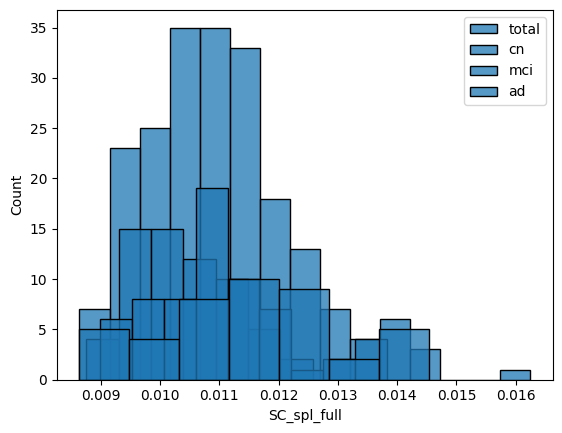

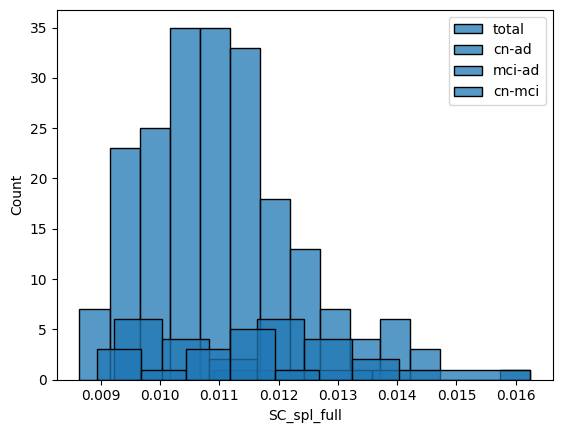

In [ ]:
sns.histplot(matrices["SC_spl_full"])
sns.histplot(matrices[matrices["group"] == "cn"]["SC_spl_full"])
sns.histplot(matrices[matrices["group"] == "mci"]["SC_spl_full"])
sns.histplot(matrices[matrices["group"] == "ad"]["SC_spl_full"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices["SC_spl_full"])
sns.histplot(matrices[matrices["group"] == "cn-ad"]["SC_spl_full"])
sns.histplot(matrices[matrices["group"] == "mci-ad"]["SC_spl_full"])
sns.histplot(matrices[matrices["group"] == "cn-mci"]["SC_spl_full"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

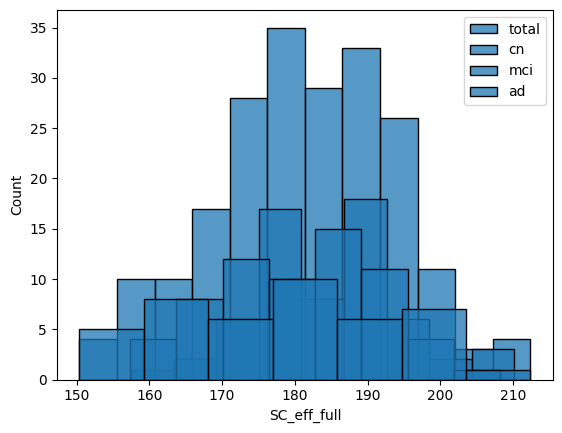

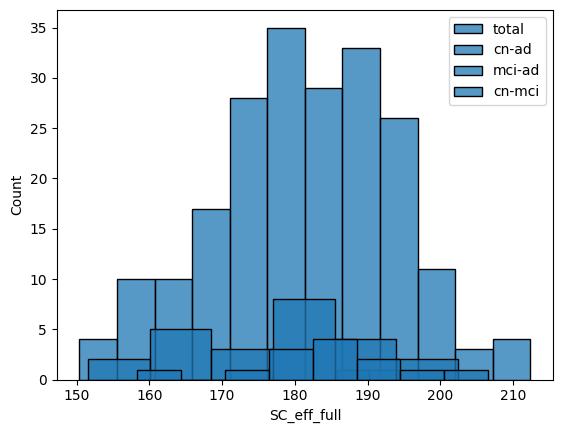

In [ ]:
sns.histplot(matrices["SC_eff_full"])
sns.histplot(matrices[matrices["group"] == "cn"]["SC_eff_full"])
sns.histplot(matrices[matrices["group"] == "mci"]["SC_eff_full"])
sns.histplot(matrices[matrices["group"] == "ad"]["SC_eff_full"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices["SC_eff_full"])
sns.histplot(matrices[matrices["group"] == "cn-ad"]["SC_eff_full"])
sns.histplot(matrices[matrices["group"] == "mci-ad"]["SC_eff_full"])
sns.histplot(matrices[matrices["group"] == "cn-mci"]["SC_eff_full"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

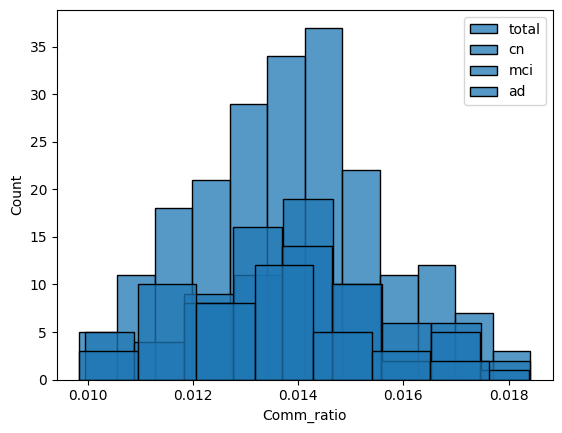

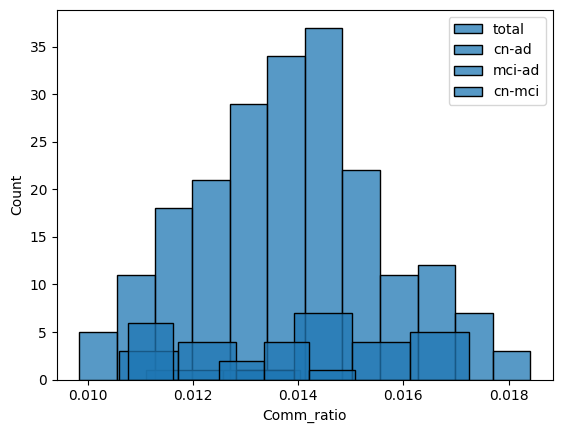

In [ ]:
sns.histplot(matrices["Comm_ratio"])
sns.histplot(matrices[matrices["group"] == "cn"]["Comm_ratio"])
sns.histplot(matrices[matrices["group"] == "mci"]["Comm_ratio"])
sns.histplot(matrices[matrices["group"] == "ad"]["Comm_ratio"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices["Comm_ratio"])
sns.histplot(matrices[matrices["group"] == "cn-ad"]["Comm_ratio"])
sns.histplot(matrices[matrices["group"] == "mci-ad"]["Comm_ratio"])
sns.histplot(matrices[matrices["group"] == "cn-mci"]["Comm_ratio"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

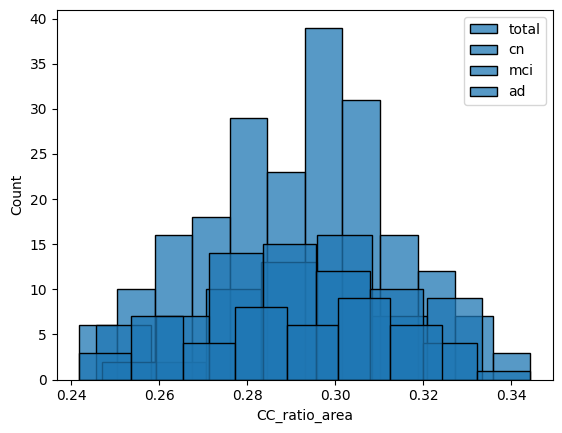

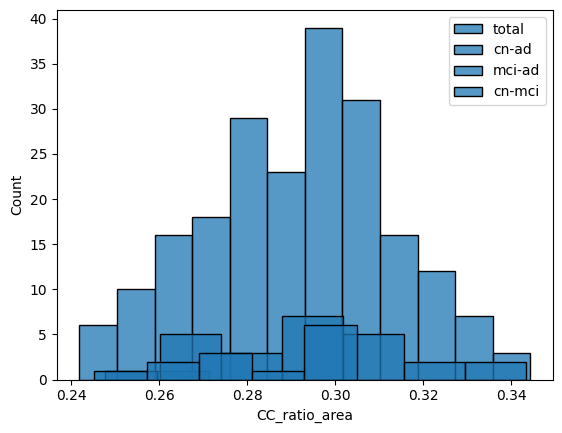

In [ ]:
sns.histplot(matrices["CC_ratio_area"])
sns.histplot(matrices[matrices["group"] == "cn"]["CC_ratio_area"])
sns.histplot(matrices[matrices["group"] == "mci"]["CC_ratio_area"])
sns.histplot(matrices[matrices["group"] == "ad"]["CC_ratio_area"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices["CC_ratio_area"])
sns.histplot(matrices[matrices["group"] == "cn-ad"]["CC_ratio_area"])
sns.histplot(matrices[matrices["group"] == "mci-ad"]["CC_ratio_area"])
sns.histplot(matrices[matrices["group"] == "cn-mci"]["CC_ratio_area"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

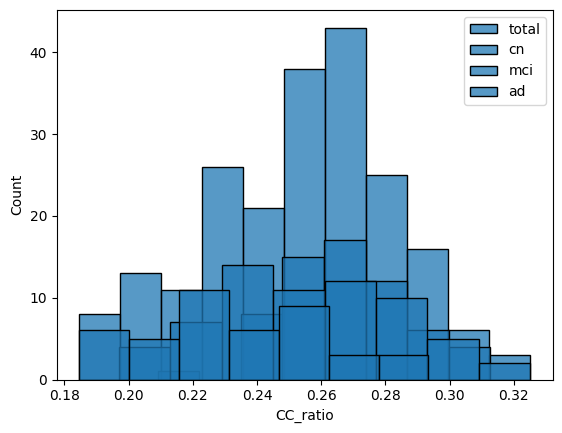

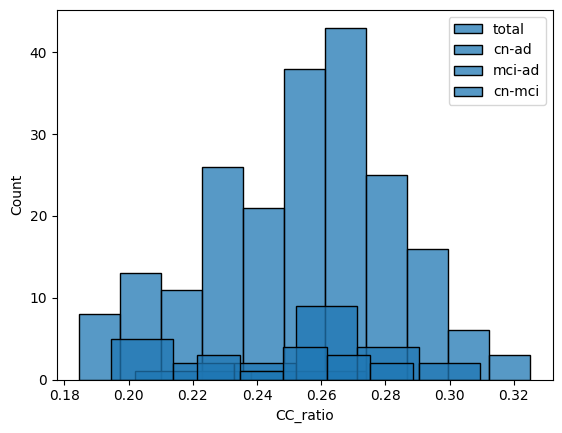

In [ ]:
sns.histplot(matrices["CC_ratio"])
sns.histplot(matrices[matrices["group"] == "cn"]["CC_ratio"])
sns.histplot(matrices[matrices["group"] == "mci"]["CC_ratio"])
sns.histplot(matrices[matrices["group"] == "ad"]["CC_ratio"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices["CC_ratio"])
sns.histplot(matrices[matrices["group"] == "cn-ad"]["CC_ratio"])
sns.histplot(matrices[matrices["group"] == "mci-ad"]["CC_ratio"])
sns.histplot(matrices[matrices["group"] == "cn-mci"]["CC_ratio"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

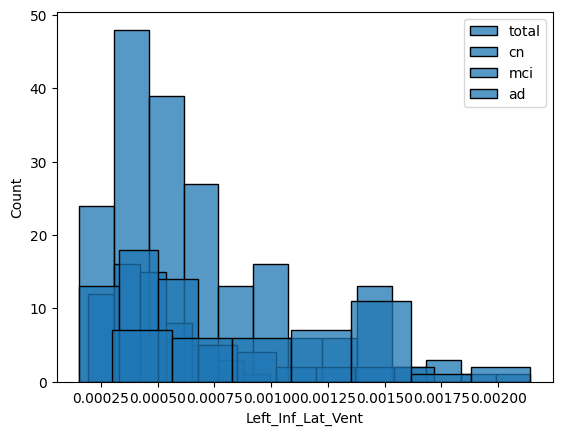

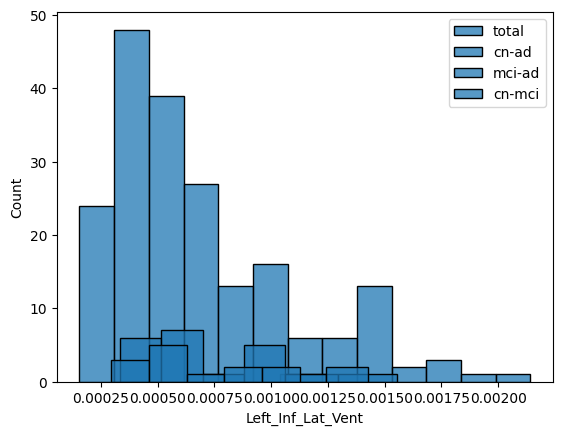

In [ ]:
sns.histplot(matrices_all["Left_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "cn"]["Left_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "mci"]["Left_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "ad"]["Left_Inf_Lat_Vent"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices_all["Left_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-ad"]["Left_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "mci-ad"]["Left_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-mci"]["Left_Inf_Lat_Vent"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

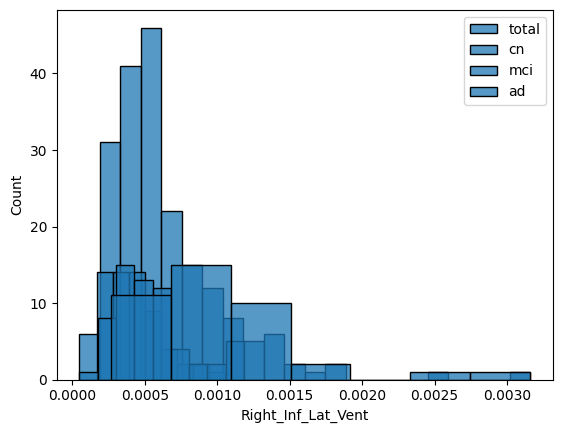

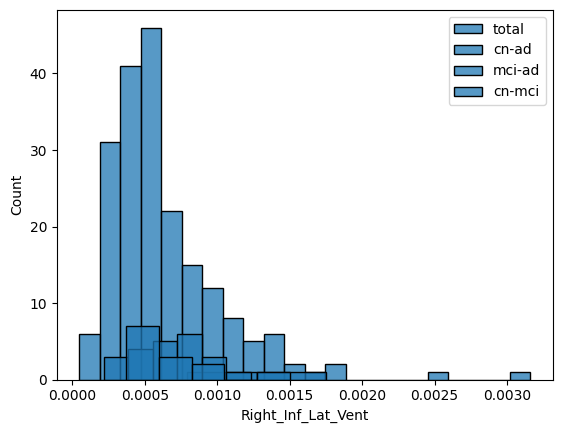

In [ ]:
sns.histplot(matrices_all["Right_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "cn"]["Right_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "mci"]["Right_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "ad"]["Right_Inf_Lat_Vent"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices_all["Right_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-ad"]["Right_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "mci-ad"]["Right_Inf_Lat_Vent"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-mci"]["Right_Inf_Lat_Vent"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

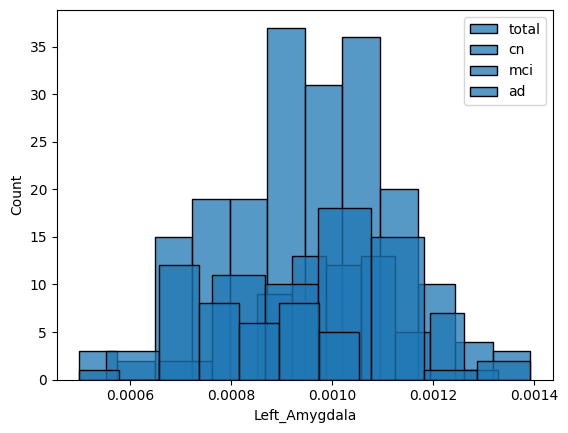

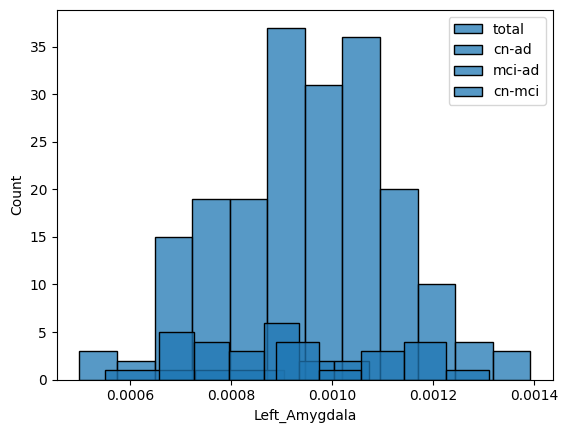

In [ ]:
sns.histplot(matrices_all["Left_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "cn"]["Left_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "mci"]["Left_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "ad"]["Left_Amygdala"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices_all["Left_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-ad"]["Left_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "mci-ad"]["Left_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-mci"]["Left_Amygdala"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

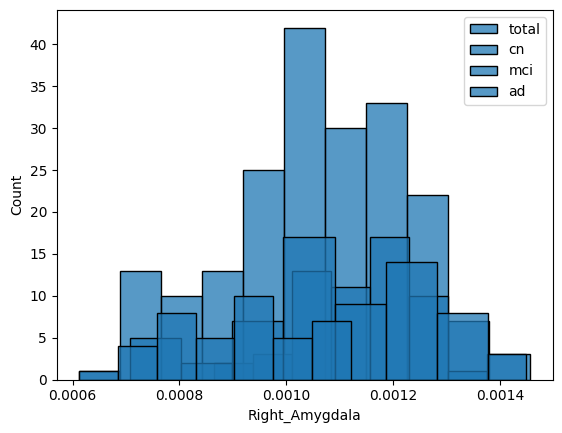

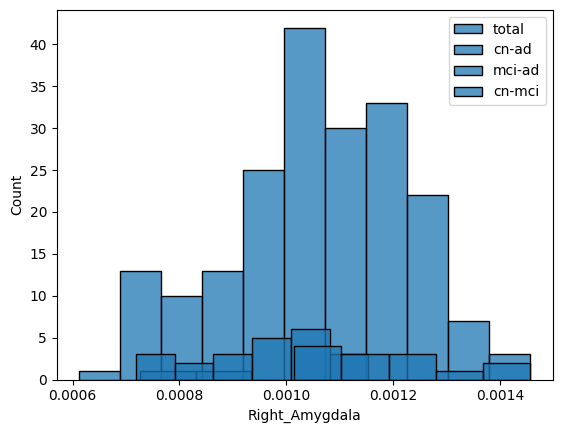

In [ ]:
sns.histplot(matrices_all["Right_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "cn"]["Right_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "mci"]["Right_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "ad"]["Right_Amygdala"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices_all["Right_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-ad"]["Right_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "mci-ad"]["Right_Amygdala"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-mci"]["Right_Amygdala"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

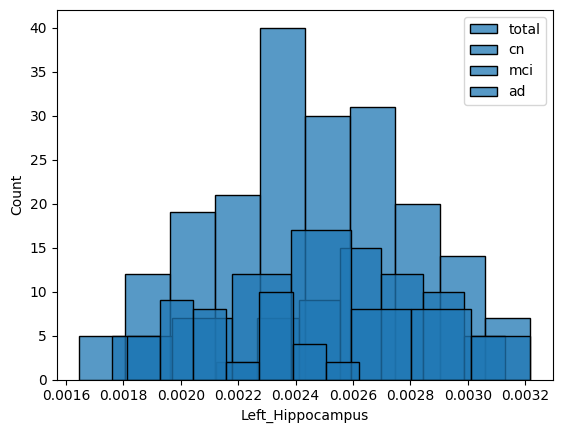

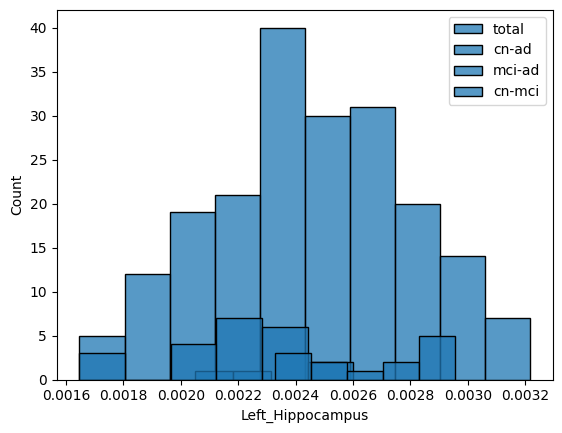

In [ ]:
sns.histplot(matrices_all["Left_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "cn"]["Left_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "mci"]["Left_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "ad"]["Left_Hippocampus"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices_all["Left_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-ad"]["Left_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "mci-ad"]["Left_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-mci"]["Left_Hippocampus"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

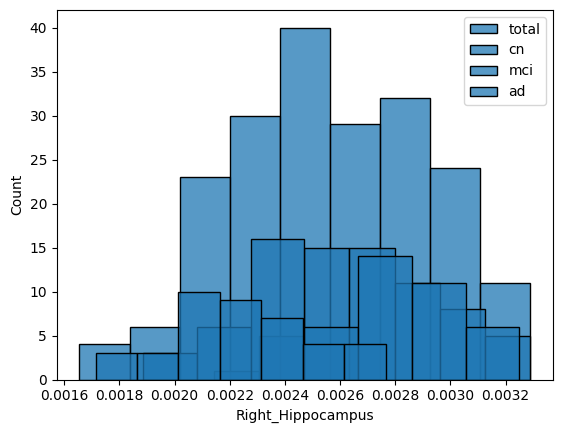

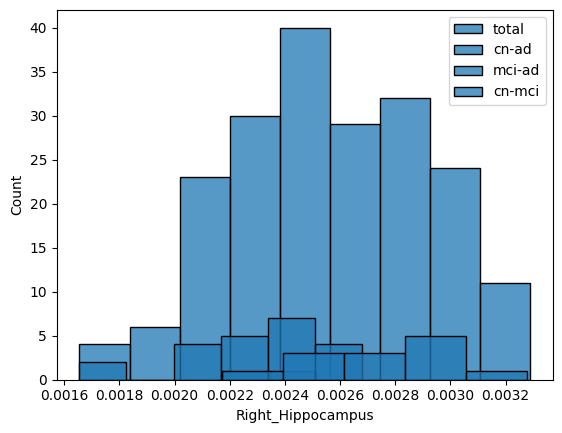

In [ ]:
sns.histplot(matrices_all["Right_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "cn"]["Right_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "mci"]["Right_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "ad"]["Right_Hippocampus"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices_all["Right_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-ad"]["Right_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "mci-ad"]["Right_Hippocampus"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-mci"]["Right_Hippocampus"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

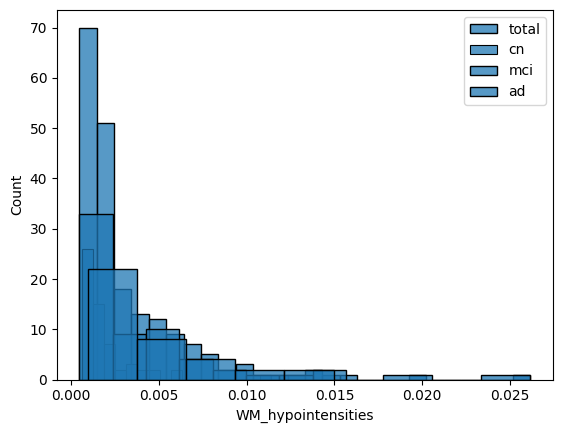

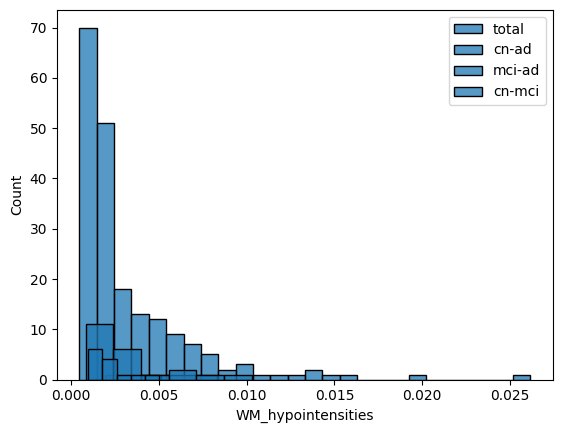

In [ ]:
sns.histplot(matrices_all["WM_hypointensities"])
sns.histplot(matrices_all[matrices_all["group"] == "cn"]["WM_hypointensities"])
sns.histplot(matrices_all[matrices_all["group"] == "mci"]["WM_hypointensities"])
sns.histplot(matrices_all[matrices_all["group"] == "ad"]["WM_hypointensities"])
plt.legend(["total", "cn", "mci", "ad"])
plt.show()

sns.histplot(matrices_all["WM_hypointensities"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-ad"]["WM_hypointensities"])
sns.histplot(matrices_all[matrices_all["group"] == "mci-ad"]["WM_hypointensities"])
sns.histplot(matrices_all[matrices_all["group"] == "cn-mci"]["WM_hypointensities"])
plt.legend(["total", "cn-ad", "mci-ad", "cn-mci"])
plt.show()

##Boxplots

In [23]:
groups = ["cn", "mci", "ad", "cn-mci", "mci-ad"]
pairs = list(combinations(groups, r=2))

iteritems is deprecated and will be removed in a future version. Use .items instead.
iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=1348.0, pvalue=0.0017548469390766485), MannwhitneyuResult(statistic=719.0, pvalue=2.941532190663456e-05), MannwhitneyuResult(statistic=327.0, pvalue=0.2613630485565907), MannwhitneyuResult(statistic=445.0, pvalue=0.002782520344212652), MannwhitneyuResult(statistic=1037.0, pvalue=0.0410276851534184), MannwhitneyuResult(statistic=449.0, pvalue=0.594651888082145), MannwhitneyuResult(statistic=631.0, pvalue=0.23883665104632698), MannwhitneyuResult(statistic=366.0, pvalue=0.09543796277987339), MannwhitneyuResult(statistic=537.0, pvalue=0.7901672593687908), MannwhitneyuResult(statistic=111.0, pvalue=0.15884204747647793)]
cn vs. mci: Custom statistical test, P_val:1.755e-03
mci vs. ad: Custom statistical test, P_val:4.103e-02
ad vs. mci-ad: Custom statistical test, P_val:7.902e-01
mci-ad vs. cn-mci: Custom statistical test, P_val:1.588e-01
cn vs. ad: Custom statistical test, P_val:2.942e-05
mci vs. mci-ad: Custom statistical test, P_val:2.388e-01
ad vs. cn-mci: C

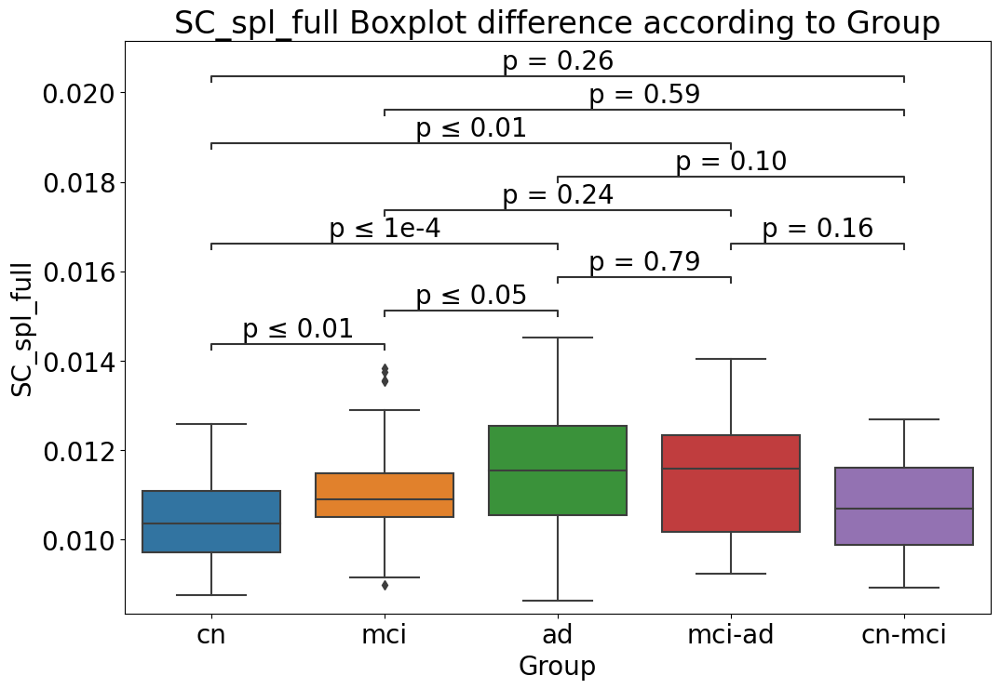

In [44]:
from scipy.stats import mannwhitneyu

plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices[matrices["group"]=="cn"].reset_index()["SC_spl_full"]
temporary_df["mci"] = matrices[matrices["group"]=="mci"].reset_index()["SC_spl_full"]
temporary_df["ad"] = matrices[matrices["group"]=="ad"].reset_index()["SC_spl_full"]
#temporary_df["cn-ad"] = matrices[matrices["group"]=="cn-ad"].reset_index()["SC_spl_full"]
temporary_df["mci-ad"] = matrices[matrices["group"]=="mci-ad"].reset_index()["SC_spl_full"]
temporary_df["cn-mci"] = matrices[matrices["group"]=="cn-mci"].reset_index()["SC_spl_full"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('SC_spl_full Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('SC_spl_full')

plt.rcParams.update({'font.size': 20})
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=2336.0, pvalue=0.08681244524552681), MannwhitneyuResult(statistic=1709.0, pvalue=0.022291957189196313), MannwhitneyuResult(statistic=389.0, pvalue=0.7851230646254069), MannwhitneyuResult(statistic=968.0, pvalue=0.0440590280948941), MannwhitneyuResult(statistic=1514.0, pvalue=0.3077105229192823), MannwhitneyuResult(statistic=326.0, pvalue=0.2555317947172305), MannwhitneyuResult(statistic=856.0, pvalue=0.34707595292815424), MannwhitneyuResult(statistic=200.0, pvalue=0.1263122554885646), MannwhitneyuResult(statistic=500.0, pvalue=0.8405599365697418), MannwhitneyuResult(statistic=206.0, pvalue=0.1162176685804246)]
cn vs. mci: Custom statistical test, P_val:8.681e-02
mci vs. ad: Custom statistical test, P_val:3.077e-01
ad vs. mci-ad: Custom statistical test, P_val:8.406e-01


iteritems is deprecated and will be removed in a future version. Use .items instead.


mci-ad vs. cn-mci: Custom statistical test, P_val:1.162e-01
cn vs. ad: Custom statistical test, P_val:2.229e-02
mci vs. mci-ad: Custom statistical test, P_val:3.471e-01
ad vs. cn-mci: Custom statistical test, P_val:1.263e-01
cn vs. mci-ad: Custom statistical test, P_val:4.406e-02
mci vs. cn-mci: Custom statistical test, P_val:2.555e-01
cn vs. cn-mci: Custom statistical test, P_val:7.851e-01


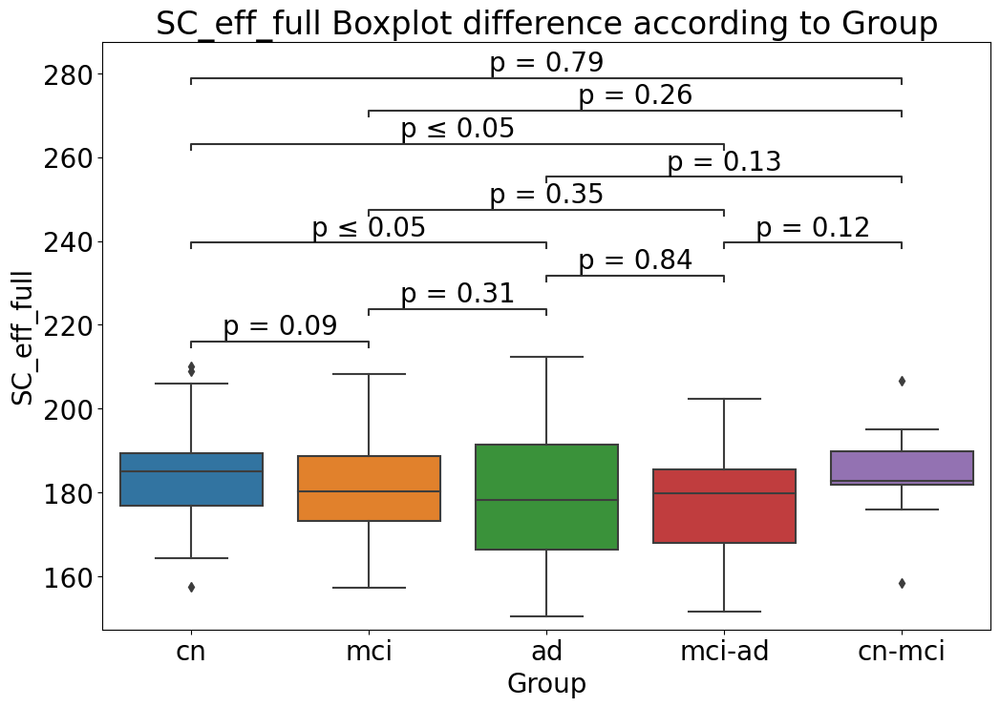

In [47]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices[matrices["group"]=="cn"].reset_index()["SC_eff_full"]
temporary_df["mci"] = matrices[matrices["group"]=="mci"].reset_index()["SC_eff_full"]
temporary_df["ad"] = matrices[matrices["group"]=="ad"].reset_index()["SC_eff_full"]
#temporary_df["cn-ad"] = matrices[matrices["group"]=="cn-ad"].reset_index()["SC_eff_full"]
temporary_df["mci-ad"] = matrices[matrices["group"]=="mci-ad"].reset_index()["SC_eff_full"]
temporary_df["cn-mci"] = matrices[matrices["group"]=="cn-mci"].reset_index()["SC_eff_full"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('SC_eff_full Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('SC_eff_full')
plt.rcParams.update({'font.size': 20})
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=2411.0, pvalue=0.037353475036469436), MannwhitneyuResult(statistic=1909.0, pvalue=0.00029444697610562555), MannwhitneyuResult(statistic=668.0, pvalue=0.00019017009787358183), MannwhitneyuResult(statistic=762.0, pvalue=0.9586327457260211), MannwhitneyuResult(statistic=1606.0, pvalue=0.10652235020618711), MannwhitneyuResult(statistic=567.0, pvalue=0.029148941608645614), MannwhitneyuResult(statistic=616.0, pvalue=0.1865309265588665), MannwhitneyuResult(statistic=352.0, pvalue=0.16422849955079757), MannwhitneyuResult(statistic=350.0, pvalue=0.02972193227974098), MannwhitneyuResult(statistic=74.0, pvalue=0.008200697870265363)]
cn vs. mci: Custom statistical test, P_val:3.735e-02
mci vs. ad: Custom statistical test, P_val:1.065e-01


iteritems is deprecated and will be removed in a future version. Use .items instead.


ad vs. mci-ad: Custom statistical test, P_val:2.972e-02
mci-ad vs. cn-mci: Custom statistical test, P_val:8.201e-03
cn vs. ad: Custom statistical test, P_val:2.944e-04
mci vs. mci-ad: Custom statistical test, P_val:1.865e-01
ad vs. cn-mci: Custom statistical test, P_val:1.642e-01
cn vs. mci-ad: Custom statistical test, P_val:9.586e-01
mci vs. cn-mci: Custom statistical test, P_val:2.915e-02
cn vs. cn-mci: Custom statistical test, P_val:1.902e-04


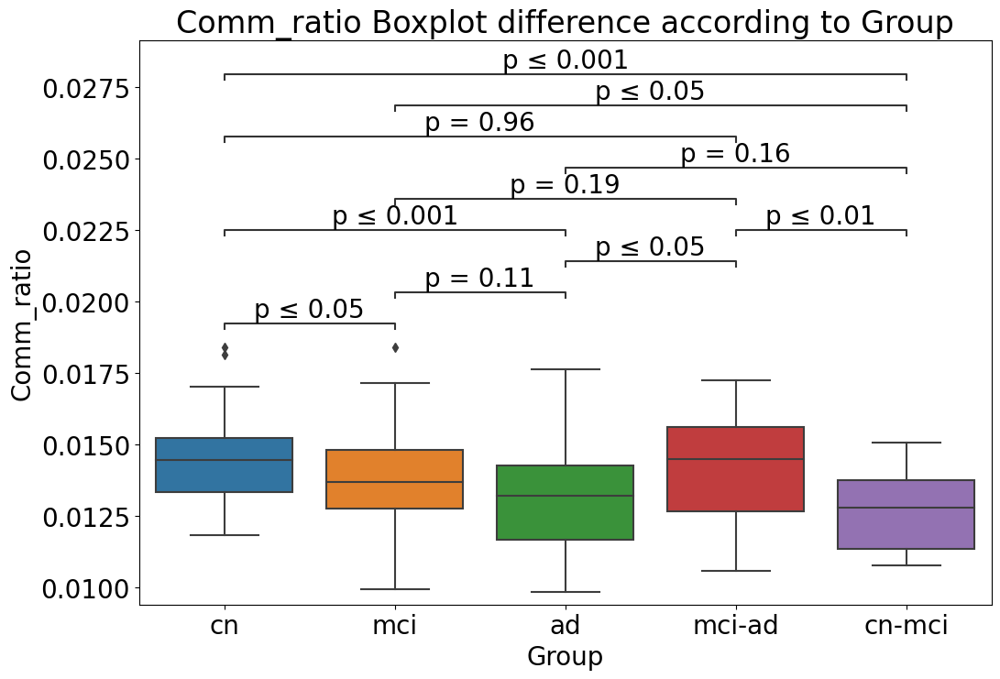

In [45]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices[matrices["group"]=="cn"].reset_index()["Comm_ratio"]
temporary_df["mci"] = matrices[matrices["group"]=="mci"].reset_index()["Comm_ratio"]
temporary_df["ad"] = matrices[matrices["group"]=="ad"].reset_index()["Comm_ratio"]
#temporary_df["cn-ad"] = matrices[matrices["group"]=="cn-ad"].reset_index()["Comm_ratio"]
temporary_df["mci-ad"] = matrices[matrices["group"]=="mci-ad"].reset_index()["Comm_ratio"]
temporary_df["cn-mci"] = matrices[matrices["group"]=="cn-mci"].reset_index()["Comm_ratio"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('Comm_ratio Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('Comm_ratio')
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=2126.0, pvalue=0.49278619901718285), MannwhitneyuResult(statistic=1578.0, pvalue=0.15191894084398458), MannwhitneyuResult(statistic=530.0, pvalue=0.09822885289600158), MannwhitneyuResult(statistic=743.0, pvalue=0.9061563431778532), MannwhitneyuResult(statistic=1509.0, pvalue=0.32321831227119724), MannwhitneyuResult(statistic=512.0, pvalue=0.16119039744315217), MannwhitneyuResult(statistic=707.0, pvalue=0.647231346920672), MannwhitneyuResult(statistic=319.0, pvalue=0.45376216544081954), MannwhitneyuResult(statistic=426.0, pvalue=0.2438197528123644), MannwhitneyuResult(statistic=107.0, pvalue=0.12395506675948999)]
cn vs. mci: Custom statistical test, P_val:4.928e-01
mci vs. ad: Custom statistical test, P_val:3.232e-01
ad vs. mci-ad: Custom statistical test, P_val:2.438e-01


iteritems is deprecated and will be removed in a future version. Use .items instead.


mci-ad vs. cn-mci: Custom statistical test, P_val:1.240e-01
cn vs. ad: Custom statistical test, P_val:1.519e-01
mci vs. mci-ad: Custom statistical test, P_val:6.472e-01
ad vs. cn-mci: Custom statistical test, P_val:4.538e-01
cn vs. mci-ad: Custom statistical test, P_val:9.062e-01
mci vs. cn-mci: Custom statistical test, P_val:1.612e-01
cn vs. cn-mci: Custom statistical test, P_val:9.823e-02


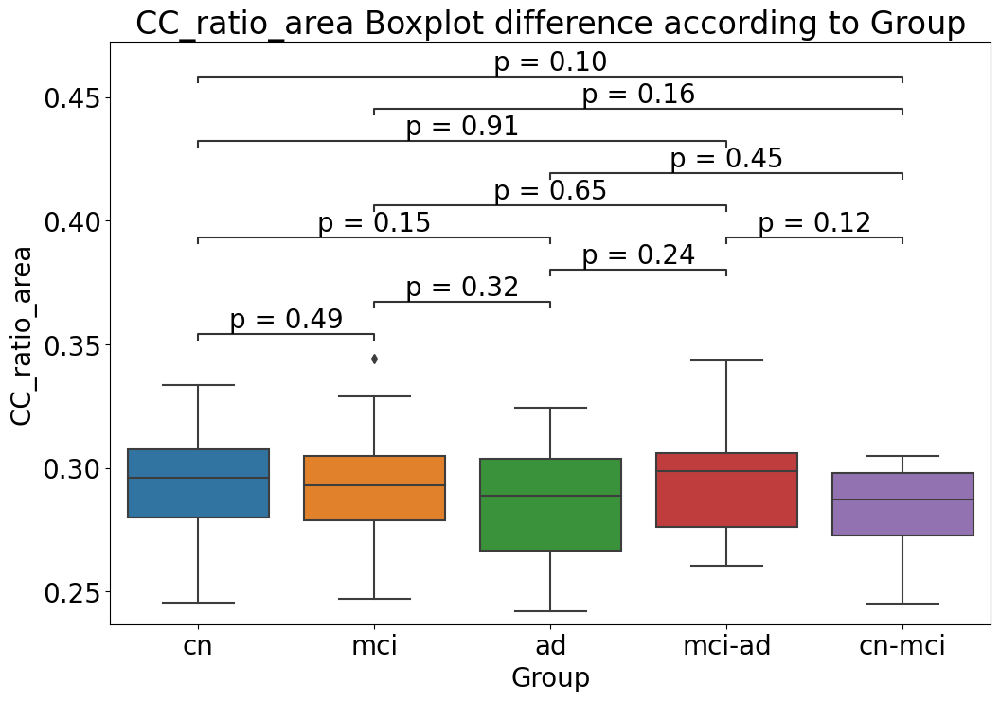

In [48]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices[matrices["group"]=="cn"].reset_index()["CC_ratio_area"]
temporary_df["mci"] = matrices[matrices["group"]=="mci"].reset_index()["CC_ratio_area"]
temporary_df["ad"] = matrices[matrices["group"]=="ad"].reset_index()["CC_ratio_area"]
#temporary_df["cn-ad"] = matrices[matrices["group"]=="cn-ad"].reset_index()["CC_ratio_area"]
temporary_df["mci-ad"] = matrices[matrices["group"]=="mci-ad"].reset_index()["CC_ratio_area"]
temporary_df["cn-mci"] = matrices[matrices["group"]=="cn-mci"].reset_index()["CC_ratio_area"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('CC_ratio_area Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('CC_ratio_area')
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.
iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=2492.0, pvalue=0.013019662891118356), MannwhitneyuResult(statistic=2250.0, pvalue=1.1880112065966658e-09), MannwhitneyuResult(statistic=523.0, pvalue=0.11993537516622767), MannwhitneyuResult(statistic=982.0, pvalue=0.03158002309033136), MannwhitneyuResult(statistic=1902.0, pvalue=0.0003536101484767978), MannwhitneyuResult(statistic=411.0, pvalue=0.9891264178747418), MannwhitneyuResult(statistic=819.0, pvalue=0.5552614189121947), MannwhitneyuResult(statistic=159.0, pvalue=0.01855543933156477), MannwhitneyuResult(statistic=354.0, pvalue=0.03400808054890656), MannwhitneyuResult(statistic=165.0, pvalue=0.7896608970979186)]
cn vs. mci: Custom statistical test, P_val:1.302e-02
mci vs. ad: Custom statistical test, P_val:3.536e-04
ad vs. mci-ad: Custom statistical test, P_val:3.401e-02
mci-ad vs. cn-mci: Custom statistical test, P_val:7.897e-01
cn vs. ad: Custom statistical test, P_val:1.188e-09
mci vs. mci-ad: Custom statistical test, P_val:5.553e-01
ad vs. cn-mc

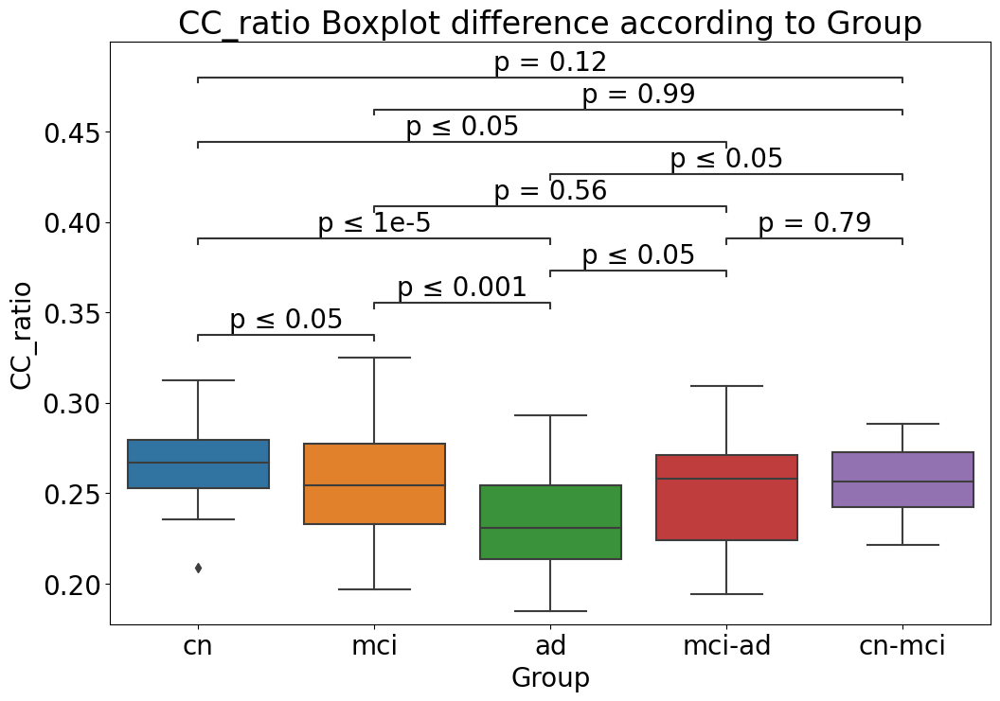

In [49]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices[matrices["group"]=="cn"].reset_index()["CC_ratio"]
temporary_df["mci"] = matrices[matrices["group"]=="mci"].reset_index()["CC_ratio"]
temporary_df["ad"] = matrices[matrices["group"]=="ad"].reset_index()["CC_ratio"]
#temporary_df["cn-ad"] = matrices[matrices["group"]=="cn-ad"].reset_index()["CC_ratio"]
temporary_df["mci-ad"] = matrices[matrices["group"]=="mci-ad"].reset_index()["CC_ratio"]
temporary_df["cn-mci"] = matrices[matrices["group"]=="cn-mci"].reset_index()["CC_ratio"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('CC_ratio Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('CC_ratio')
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.
iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=1420.0, pvalue=0.04611697825674587), MannwhitneyuResult(statistic=272.0, pvalue=1.2435293893641542e-12), MannwhitneyuResult(statistic=234.0, pvalue=0.023706479416884994), MannwhitneyuResult(statistic=317.0, pvalue=0.0002280776061951246), MannwhitneyuResult(statistic=496.0, pvalue=2.608671614651644e-07), MannwhitneyuResult(statistic=339.0, pvalue=0.47100212030590255), MannwhitneyuResult(statistic=498.0, pvalue=0.091111367896413), MannwhitneyuResult(statistic=410.0, pvalue=0.001417802405699732), MannwhitneyuResult(statistic=640.0, pvalue=0.0028391172236939834), MannwhitneyuResult(statistic=117.0, pvalue=0.3891458770479222)]
cn vs. mci: Custom statistical test, P_val:4.612e-02
mci vs. ad: Custom statistical test, P_val:2.609e-07
ad vs. mci-ad: Custom statistical test, P_val:2.839e-03
mci-ad vs. cn-mci: Custom statistical test, P_val:3.891e-01
cn vs. ad: Custom statistical test, P_val:1.244e-12
mci vs. mci-ad: Custom statistical test, P_val:9.111e-02
ad vs. cn

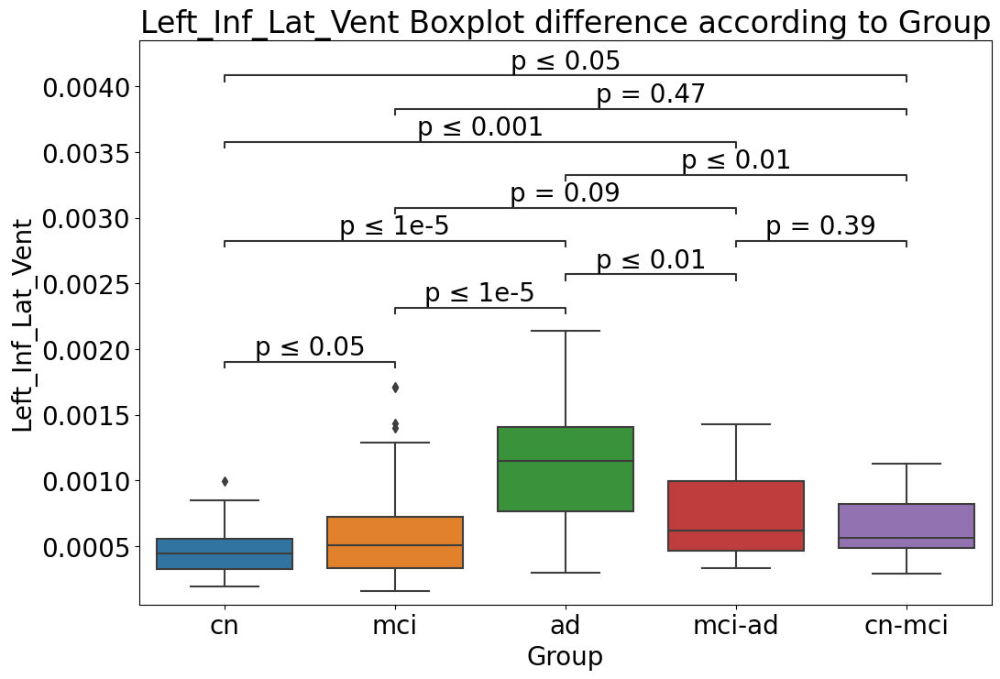

In [55]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices_all[matrices_all["group"]=="cn"].reset_index()["Left_Inf_Lat_Vent"]
temporary_df["mci"] = matrices_all[matrices_all["group"]=="mci"].reset_index()["Left_Inf_Lat_Vent"]
temporary_df["ad"] = matrices_all[matrices_all["group"]=="ad"].reset_index()["Left_Inf_Lat_Vent"]
#temporary_df["cn-ad"] = matrices_all[matrices_all["group"]=="cn-ad"].reset_index()["Left_Inf_Lat_Vent"]
temporary_df["mci-ad"] = matrices_all[matrices_all["group"]=="mci-ad"].reset_index()["Left_Inf_Lat_Vent"]
temporary_df["cn-mci"] = matrices_all[matrices_all["group"]=="cn-mci"].reset_index()["Left_Inf_Lat_Vent"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('Left_Inf_Lat_Vent Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('Left_Inf_Lat_Vent')
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.
iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=1413.0, pvalue=0.04220508993483978), MannwhitneyuResult(statistic=294.0, pvalue=5.490719401989809e-12), MannwhitneyuResult(statistic=233.0, pvalue=0.02278272960537504), MannwhitneyuResult(statistic=303.0, pvalue=0.00011844871645266646), MannwhitneyuResult(statistic=476.0, pvalue=1.0834562993353636e-07), MannwhitneyuResult(statistic=322.0, pvalue=0.33449252200215507), MannwhitneyuResult(statistic=436.0, pvalue=0.01855504465518013), MannwhitneyuResult(statistic=387.0, pvalue=0.007762050091053217), MannwhitneyuResult(statistic=645.0, pvalue=0.002186280255904004), MannwhitneyuResult(statistic=114.0, pvalue=0.3353805517951244)]
cn vs. mci: Custom statistical test, P_val:4.221e-02
mci vs. ad: Custom statistical test, P_val:1.083e-07
ad vs. mci-ad: Custom statistical test, P_val:2.186e-03
mci-ad vs. cn-mci: Custom statistical test, P_val:3.354e-01
cn vs. ad: Custom statistical test, P_val:5.491e-12
mci vs. mci-ad: Custom statistical test, P_val:1.856e-02
ad vs. c

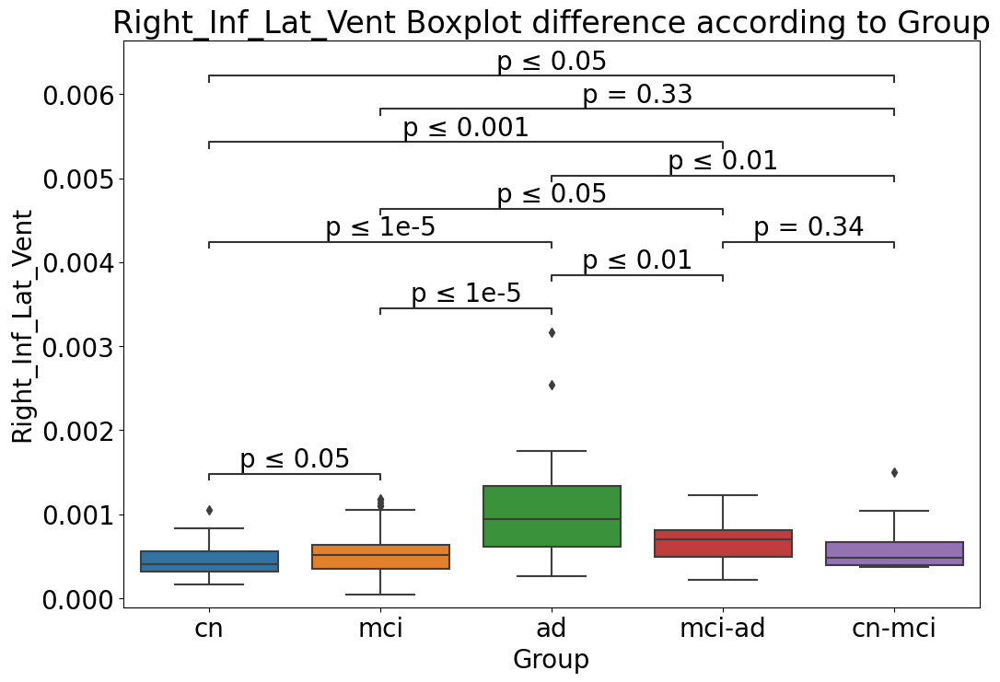

In [56]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices_all[matrices_all["group"]=="cn"].reset_index()["Right_Inf_Lat_Vent"]
temporary_df["mci"] = matrices_all[matrices_all["group"]=="mci"].reset_index()["Right_Inf_Lat_Vent"]
temporary_df["ad"] = matrices_all[matrices_all["group"]=="ad"].reset_index()["Right_Inf_Lat_Vent"]
#temporary_df["cn-ad"] = matrices_all[matrices_all["group"]=="cn-ad"].reset_index()["Right_Inf_Lat_Vent"]
temporary_df["mci-ad"] = matrices_all[matrices_all["group"]=="mci-ad"].reset_index()["Right_Inf_Lat_Vent"]
temporary_df["cn-mci"] = matrices_all[matrices_all["group"]=="cn-mci"].reset_index()["Right_Inf_Lat_Vent"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('Right_Inf_Lat_Vent Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('Right_Inf_Lat_Vent')
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.
iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=2220.0, pvalue=0.027312157439199333), MannwhitneyuResult(statistic=2158.0, pvalue=1.4363593589771317e-13), MannwhitneyuResult(statistic=329.0, pvalue=0.3873793519045907), MannwhitneyuResult(statistic=1186.0, pvalue=1.4026055991121277e-09), MannwhitneyuResult(statistic=1847.0, pvalue=2.658982049019009e-06), MannwhitneyuResult(statistic=249.0, pvalue=0.04181268055493124), MannwhitneyuResult(statistic=988.0, pvalue=0.00044412769380919456), MannwhitneyuResult(statistic=50.0, pvalue=1.9252787514925803e-06), MannwhitneyuResult(statistic=412.0, pvalue=0.6880958599723614), MannwhitneyuResult(statistic=261.0, pvalue=1.1746634137525979e-05)]
cn vs. mci: Custom statistical test, P_val:2.731e-02
mci vs. ad: Custom statistical test, P_val:2.659e-06
ad vs. mci-ad: Custom statistical test, P_val:6.881e-01
mci-ad vs. cn-mci: Custom statistical test, P_val:1.175e-05
cn vs. ad: Custom statistical test, P_val:1.436e-13
mci vs. mci-ad: Custom statistical test, P_val:4.441e-04

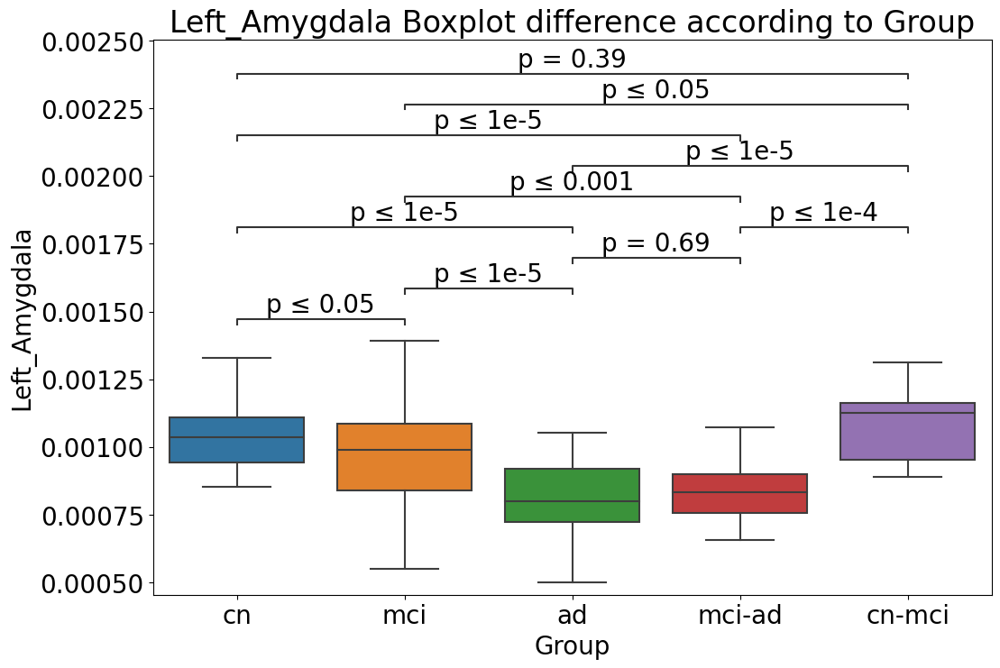

In [50]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices_all[matrices_all["group"]=="cn"].reset_index()["Left_Amygdala"]
temporary_df["mci"] = matrices_all[matrices_all["group"]=="mci"].reset_index()["Left_Amygdala"]
temporary_df["ad"] = matrices_all[matrices_all["group"]=="ad"].reset_index()["Left_Amygdala"]
#temporary_df["cn-ad"] = matrices_all[matrices_all["group"]=="cn-ad"].reset_index()["Left_Amygdala"]
temporary_df["mci-ad"] = matrices_all[matrices_all["group"]=="mci-ad"].reset_index()["Left_Amygdala"]
temporary_df["cn-mci"] = matrices_all[matrices_all["group"]=="cn-mci"].reset_index()["Left_Amygdala"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('Left_Amygdala Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('Left_Amygdala')
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=2194.0, pvalue=0.038575653195589595), MannwhitneyuResult(statistic=2219.0, pvalue=1.0032103569139818e-15), MannwhitneyuResult(statistic=323.0, pvalue=0.34175611321469856), MannwhitneyuResult(statistic=1172.0, pvalue=4.9911198227241536e-09), MannwhitneyuResult(statistic=1927.0, pvalue=9.467885862286315e-08), MannwhitneyuResult(statistic=240.0, pvalue=0.029937929498211707), MannwhitneyuResult(statistic=1003.0, pvalue=0.0002280776061951246), MannwhitneyuResult(statistic=29.0, pvalue=4.889748505101977e-08), MannwhitneyuResult(statistic=369.0, pvalue=0.30221754768728654), MannwhitneyuResult(statistic=264.0, pvalue=5.8536738678641165e-06)]
cn vs. mci: Custom statistical test, P_val:3.858e-02


iteritems is deprecated and will be removed in a future version. Use .items instead.


mci vs. ad: Custom statistical test, P_val:9.468e-08
ad vs. mci-ad: Custom statistical test, P_val:3.022e-01
mci-ad vs. cn-mci: Custom statistical test, P_val:5.854e-06
cn vs. ad: Custom statistical test, P_val:1.003e-15
mci vs. mci-ad: Custom statistical test, P_val:2.281e-04
ad vs. cn-mci: Custom statistical test, P_val:4.890e-08
cn vs. mci-ad: Custom statistical test, P_val:4.991e-09
mci vs. cn-mci: Custom statistical test, P_val:2.994e-02
cn vs. cn-mci: Custom statistical test, P_val:3.418e-01


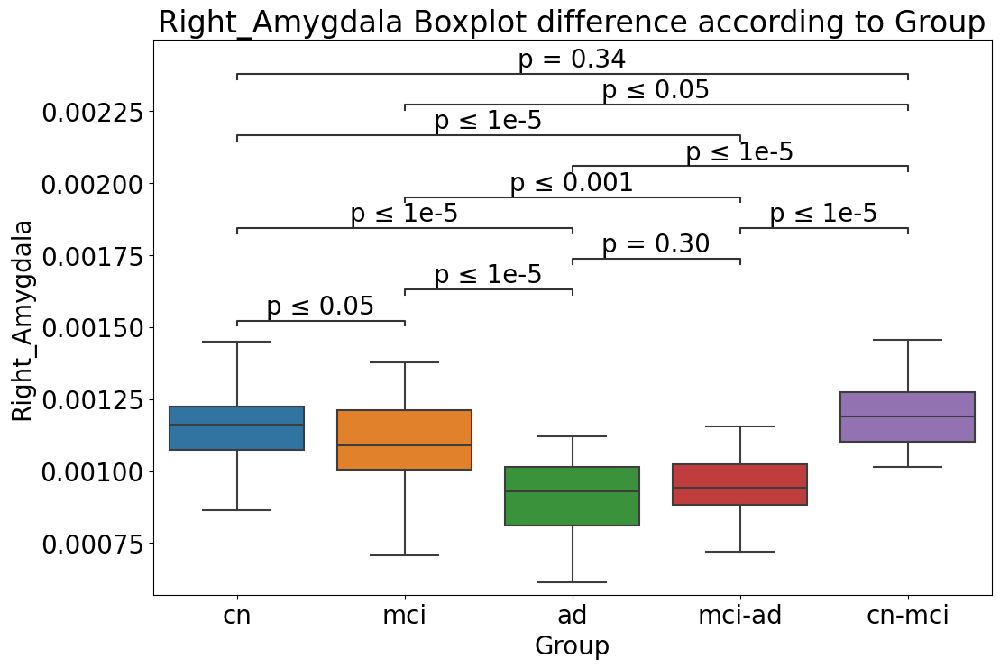

In [51]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices_all[matrices_all["group"]=="cn"].reset_index()["Right_Amygdala"]
temporary_df["mci"] = matrices_all[matrices_all["group"]=="mci"].reset_index()["Right_Amygdala"]
temporary_df["ad"] = matrices_all[matrices_all["group"]=="ad"].reset_index()["Right_Amygdala"]
#temporary_df["cn-ad"] = matrices_all[matrices_all["group"]=="cn-ad"].reset_index()["Right_Amygdala"]
temporary_df["mci-ad"] = matrices_all[matrices_all["group"]=="mci-ad"].reset_index()["Right_Amygdala"]
temporary_df["cn-mci"] = matrices_all[matrices_all["group"]=="cn-mci"].reset_index()["Right_Amygdala"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('Right_Amygdala Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('Right_Amygdala')
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.
iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=2471.0, pvalue=0.000366298091233083), MannwhitneyuResult(statistic=2293.0, pvalue=5.404440280299131e-19), MannwhitneyuResult(statistic=374.0, pvalue=0.825220718868339), MannwhitneyuResult(statistic=1240.0, pvalue=3.834077324100231e-12), MannwhitneyuResult(statistic=1851.0, pvalue=2.2782749448908254e-06), MannwhitneyuResult(statistic=244.0, pvalue=0.03481115289061515), MannwhitneyuResult(statistic=983.0, pvalue=0.0005502517729994803), MannwhitneyuResult(statistic=32.0, pvalue=8.951346517190716e-08), MannwhitneyuResult(statistic=376.0, pvalue=0.3530243686357921), MannwhitneyuResult(statistic=263.0, pvalue=7.421065829243145e-06)]
cn vs. mci: Custom statistical test, P_val:3.663e-04
mci vs. ad: Custom statistical test, P_val:2.278e-06
ad vs. mci-ad: Custom statistical test, P_val:3.530e-01
mci-ad vs. cn-mci: Custom statistical test, P_val:7.421e-06
cn vs. ad: Custom statistical test, P_val:5.404e-19
mci vs. mci-ad: Custom statistical test, P_val:5.503e-04
ad v

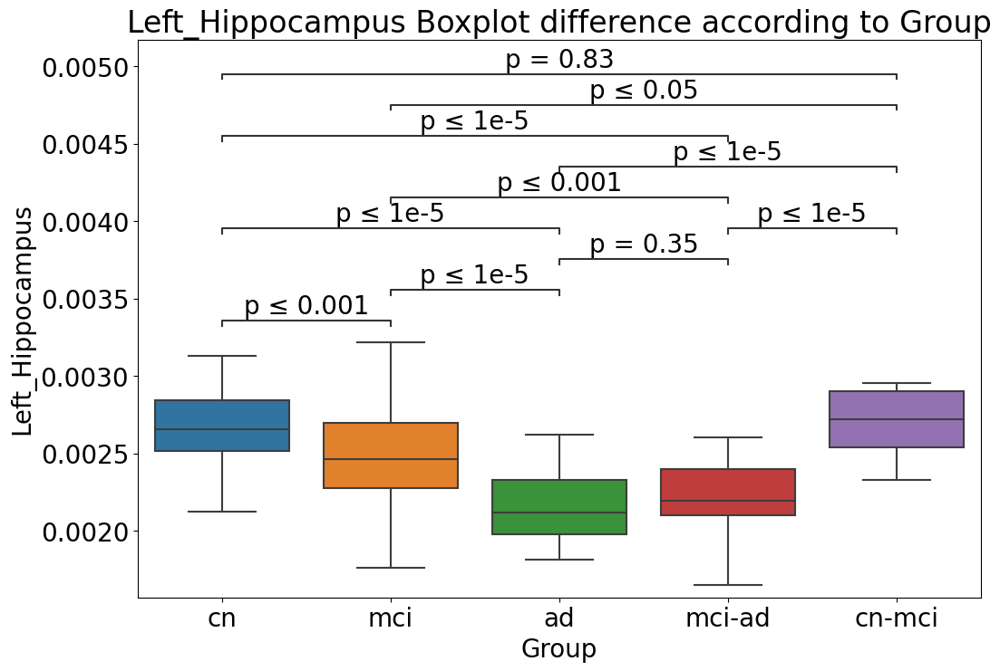

In [52]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices_all[matrices_all["group"]=="cn"].reset_index()["Left_Hippocampus"]
temporary_df["mci"] = matrices_all[matrices_all["group"]=="mci"].reset_index()["Left_Hippocampus"]
temporary_df["ad"] = matrices_all[matrices_all["group"]=="ad"].reset_index()["Left_Hippocampus"]
#temporary_df["cn-ad"] = matrices_all[matrices_all["group"]=="cn-ad"].reset_index()["Left_Hippocampus"]
temporary_df["mci-ad"] = matrices_all[matrices_all["group"]=="mci-ad"].reset_index()["Left_Hippocampus"]
temporary_df["cn-mci"] = matrices_all[matrices_all["group"]=="cn-mci"].reset_index()["Left_Hippocampus"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('Left_Hippocampus Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('Left_Hippocampus')
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=2261.0, pvalue=0.015272180405454673), MannwhitneyuResult(statistic=2227.0, pvalue=4.881635695733378e-16), MannwhitneyuResult(statistic=387.0, pvalue=0.9715918588943376), MannwhitneyuResult(statistic=1221.0, pvalue=3.8101025948467094e-11), MannwhitneyuResult(statistic=1933.0, pvalue=7.212456325420806e-08), MannwhitneyuResult(statistic=300.0, pvalue=0.1993673866156693), MannwhitneyuResult(statistic=1013.0, pvalue=0.00014331531946646032), MannwhitneyuResult(statistic=51.0, pvalue=2.2336816147690135e-06), MannwhitneyuResult(statistic=381.0, pvalue=0.39238319135387356), MannwhitneyuResult(statistic=254.0, pvalue=5.06306889927224e-05)]
cn vs. mci: Custom statistical test, P_val:1.527e-02


iteritems is deprecated and will be removed in a future version. Use .items instead.


mci vs. ad: Custom statistical test, P_val:7.212e-08
ad vs. mci-ad: Custom statistical test, P_val:3.924e-01
mci-ad vs. cn-mci: Custom statistical test, P_val:5.063e-05
cn vs. ad: Custom statistical test, P_val:4.882e-16
mci vs. mci-ad: Custom statistical test, P_val:1.433e-04
ad vs. cn-mci: Custom statistical test, P_val:2.234e-06
cn vs. mci-ad: Custom statistical test, P_val:3.810e-11
mci vs. cn-mci: Custom statistical test, P_val:1.994e-01
cn vs. cn-mci: Custom statistical test, P_val:9.716e-01


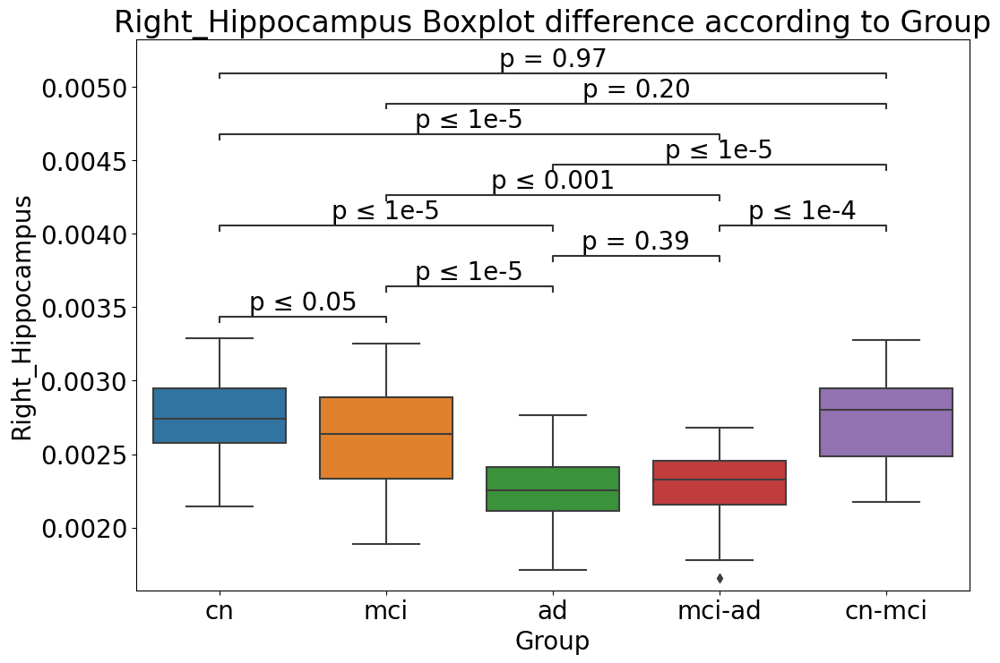

In [53]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices_all[matrices_all["group"]=="cn"].reset_index()["Right_Hippocampus"]
temporary_df["mci"] = matrices_all[matrices_all["group"]=="mci"].reset_index()["Right_Hippocampus"]
temporary_df["ad"] = matrices_all[matrices_all["group"]=="ad"].reset_index()["Right_Hippocampus"]
#temporary_df["cn-ad"] = matrices_all[matrices_all["group"]=="cn-ad"].reset_index()["Right_Hippocampus"]
temporary_df["mci-ad"] = matrices_all[matrices_all["group"]=="mci-ad"].reset_index()["Right_Hippocampus"]
temporary_df["cn-mci"] = matrices_all[matrices_all["group"]=="cn-mci"].reset_index()["Right_Hippocampus"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('Right_Hippocampus Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('Right_Hippocampus')
plt.show()

iteritems is deprecated and will be removed in a future version. Use .items instead.
iteritems is deprecated and will be removed in a future version. Use .items instead.


[MannwhitneyuResult(statistic=1264.0, pvalue=0.0046752925885928075), MannwhitneyuResult(statistic=519.0, pvalue=6.870600796325953e-07), MannwhitneyuResult(statistic=300.0, pvalue=0.1993673866156693), MannwhitneyuResult(statistic=449.0, pvalue=0.02684671409880864), MannwhitneyuResult(statistic=925.0, pvalue=0.05315406709360384), MannwhitneyuResult(statistic=461.0, pvalue=0.3132894230973732), MannwhitneyuResult(statistic=683.0, pvalue=0.8151915480206487), MannwhitneyuResult(statistic=377.0, pvalue=0.014710695576561277), MannwhitneyuResult(statistic=556.0, pvalue=0.0893715443036436), MannwhitneyuResult(statistic=115.0, pvalue=0.352761041544828)]
cn vs. mci: Custom statistical test, P_val:4.675e-03
mci vs. ad: Custom statistical test, P_val:5.315e-02
ad vs. mci-ad: Custom statistical test, P_val:8.937e-02
mci-ad vs. cn-mci: Custom statistical test, P_val:3.528e-01
cn vs. ad: Custom statistical test, P_val:6.871e-07
mci vs. mci-ad: Custom statistical test, P_val:8.152e-01
ad vs. cn-mci: Cus

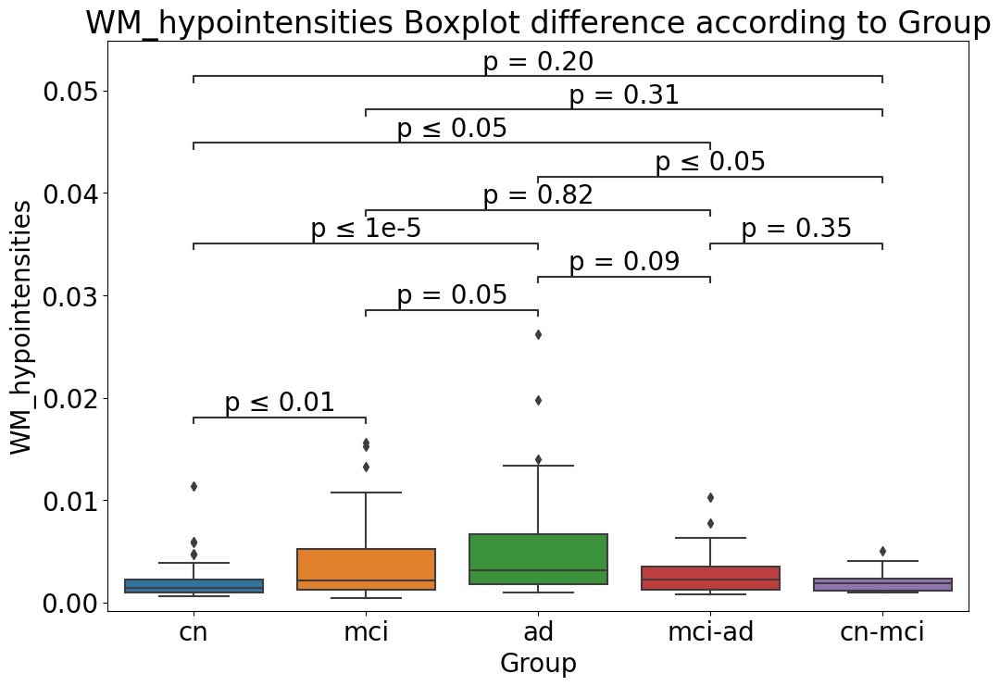

In [54]:
plt.figure(figsize=(12, 8))
temporary_df = pd.DataFrame()
temporary_df["cn"] = matrices_all[matrices_all["group"]=="cn"].reset_index()["WM_hypointensities"]
temporary_df["mci"] = matrices_all[matrices_all["group"]=="mci"].reset_index()["WM_hypointensities"]
temporary_df["ad"] = matrices_all[matrices_all["group"]=="ad"].reset_index()["WM_hypointensities"]
#temporary_df["cn-ad"] = matrices_all[matrices_all["group"]=="cn-ad"].reset_index()["WM_hypointensities"]
temporary_df["mci-ad"] = matrices_all[matrices_all["group"]=="mci-ad"].reset_index()["WM_hypointensities"]
temporary_df["cn-mci"] = matrices_all[matrices_all["group"]=="cn-mci"].reset_index()["WM_hypointensities"]

ax = sns.boxplot(data=temporary_df)

stat_results = []
for i in range(0, len(groups)):
  for j in range(i + 1, len(groups)):
    stat_results.append(mannwhitneyu(temporary_df[groups[i]], temporary_df[groups[j]], method="exact", nan_policy="omit"))

print(stat_results)

pvalues = [result.pvalue for result in stat_results]

annotator = Annotator(ax, pairs, data=temporary_df)
annotator.configure(text_format="simple")
annotator.set_pvalues(pvalues).annotate()

plt.title('WM_hypointensities Boxplot difference according to Group')
plt.xlabel('Group')
plt.ylabel('WM_hypointensities')
plt.show()

##Correlation Matrix

In [ ]:
plt.figure(figsize=(150, 40))
heatmap = sns.heatmap(matrices_all.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
plt.figure(figsize=(150, 40))
heatmap = sns.heatmap(matrices_cn_mci_ad_all.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
plt.figure(figsize=(150, 40))
heatmap = sns.heatmap(matrices_cn_ad_all.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
plt.figure(figsize=(150, 40))
heatmap = sns.heatmap(matrices_cn_mci_all.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
plt.figure(figsize=(150, 40))
heatmap = sns.heatmap(matrices_mci_mciad_all.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
plt.figure(figsize=(150, 40))
heatmap = sns.heatmap(matrices_cn_cnad_cnmci_all.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

Output hidden; open in https://colab.research.google.com to view.

#Check interhemispheric connectivity balance

In [ ]:
interhemispheric = ["Comm_ratio", "CC_ratio_area", "CC_ratio"]
intrahemispheric = ["SC_spl_full", "SC_eff_full"]

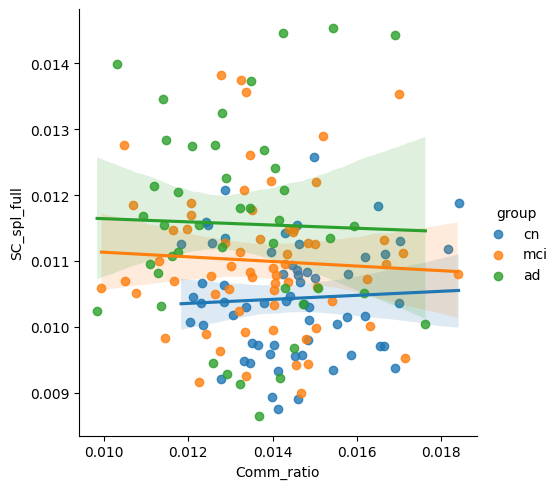

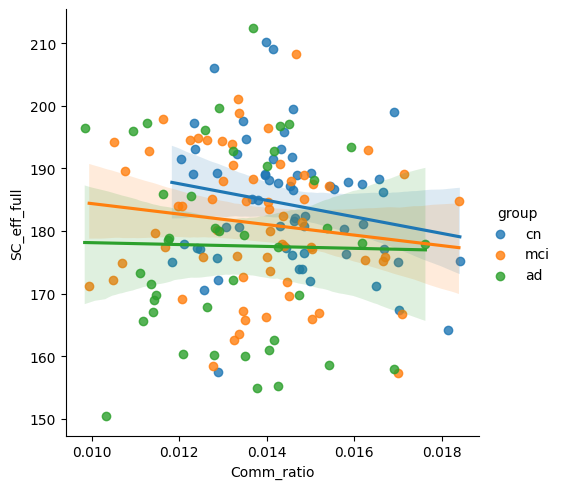

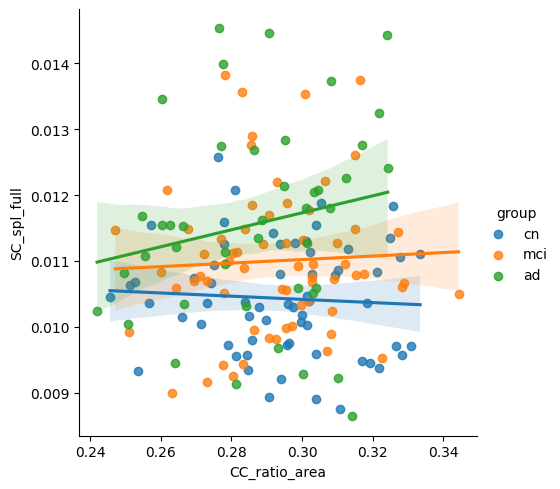

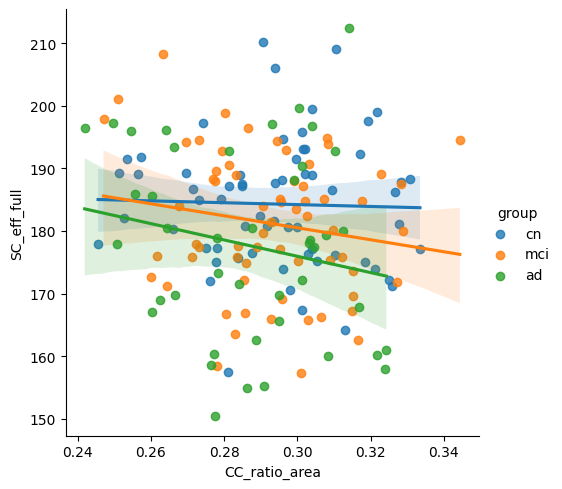

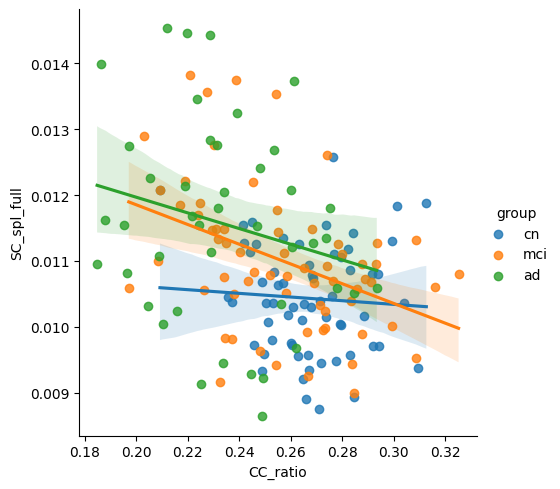

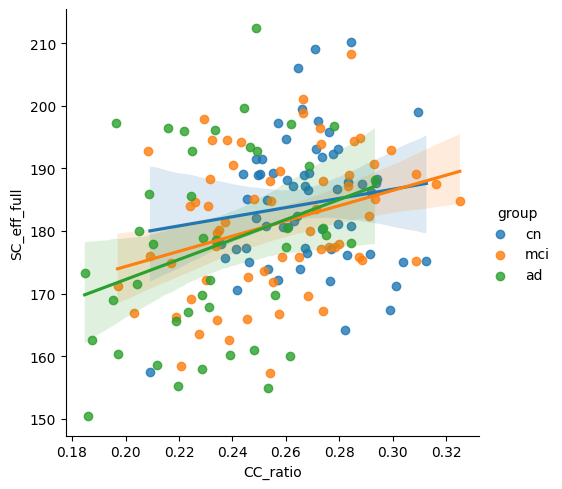

In [ ]:
for i in interhemispheric:
  for j in intrahemispheric:
    sns.lmplot(x=i, y=j, data=matrices_cn_mci_ad, hue='group', fit_reg=True)
    plt.show()

#Classifier Only with Connectivity

##Classifier CN-MCI-AD only with connectivity

###Creation of the datasets

In [ ]:
x = matrices_cn_mci_ad.drop(["group", "group_int", "Subject", "Age", "Sex", "Centre"], axis=1)
y = matrices_cn_mci_ad[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex", "Centre"]
for i in matrices_cn_mci_ad.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(matrices_cn_mci_ad.columns)):
  if matrices_cn_mci_ad.columns[i] not in not_matrices:
    if importances[j] > 0.04:
      final_columns.append(matrices_cn_mci_ad.columns[i])
    j += 1

print(final_columns)

['Comm_ratio', 'SC_L_avg_spl', 'SC_L_avg_eff', 'SC_R_avg_spl', 'SC_R_avg_eff', 'SC_avg_eff', 'CC_ratio', 'SC_spl_full', 'SC_eff_full', 'Full_CC']


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


In [ ]:
x = matrices_cn_mci_ad[final_columns]
y = matrices_cn_mci_ad[["group"]]

x_train, x_test = train_test_split(x, test_size=0.3, random_state=42)
y_train, y_test = train_test_split(y, test_size=0.3, random_state=42)

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

Y = pd.get_dummies(y)

X = X.values
Y = Y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)

####Random Forest Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(np.argmax(Y_test, axis = 1), np.argmax(y_pred, axis = 1)))
print()
print("Classfication Report:")
print()
print(classification_report(np.argmax(Y_test, axis = 1), np.argmax(y_pred, axis = 1)))

Confusion Matrix:
[[ 6  5  3]
 [ 4 12  4]
 [ 7  4  7]]

Classfication Report:

              precision    recall  f1-score   support

           0       0.35      0.43      0.39        14
           1       0.57      0.60      0.59        20
           2       0.50      0.39      0.44        18

    accuracy                           0.48        52
   macro avg       0.47      0.47      0.47        52
weighted avg       0.49      0.48      0.48        52



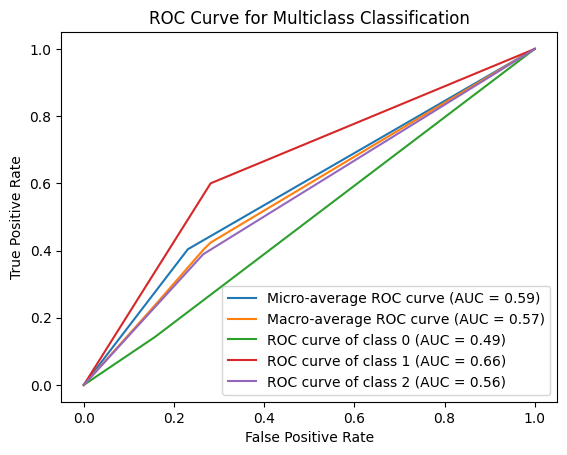

In [ ]:
from sklearn.preprocessing import label_binarize

n_classes= 3

# Binarize the true labels
y_true_binary = label_binarize(Y_test, classes=np.arange(n_classes))

# Compute ROC curve and ROC AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = metrics.roc_curve(y_true_binary[:, i], y_pred[:, i])
    roc_auc[i] = metrics.auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC AUC
fpr_micro, tpr_micro, _ = metrics.roc_curve(y_true_binary.ravel(), y_pred.ravel())
roc_auc_micro = metrics.auc(fpr_micro, tpr_micro)

# Compute macro-average ROC curve and ROC AUC
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr_macro = all_fpr
tpr_macro = mean_tpr
roc_auc_macro = metrics.auc(fpr_macro, tpr_macro)

# Plot micro-average ROC curve
plt.plot(fpr_micro, tpr_micro, label='Micro-average ROC curve (AUC = {:.2f})'.format(roc_auc_micro))

# Plot macro-average ROC curve
plt.plot(fpr_macro, tpr_macro, label='Macro-average ROC curve (AUC = {:.2f})'.format(roc_auc_macro))

# Plot ROC curve for each class
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label='ROC curve of class {} (AUC = {:.2f})'.format(i, roc_auc[i]))

# Add labels and legends
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Multiclass Classification')
plt.legend()
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.Explainer(xgboost_reg)
shap_values = explainer.shap_values(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


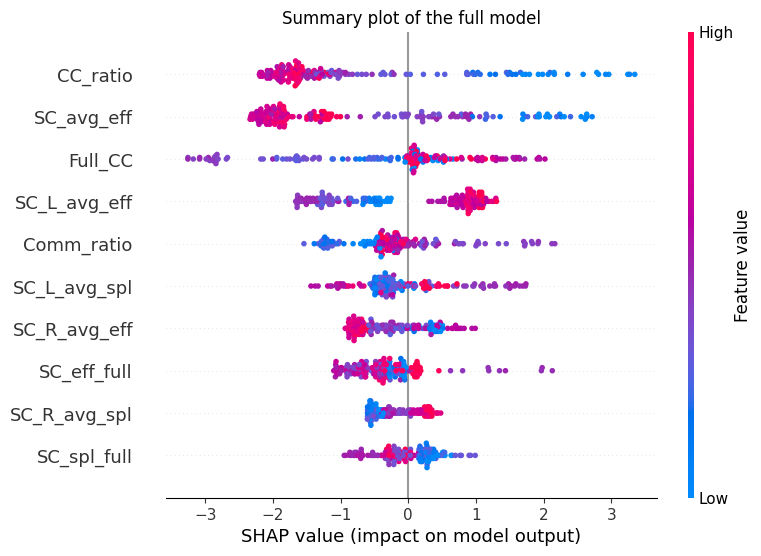

In [ ]:
shap.summary_plot(shap_values[0], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

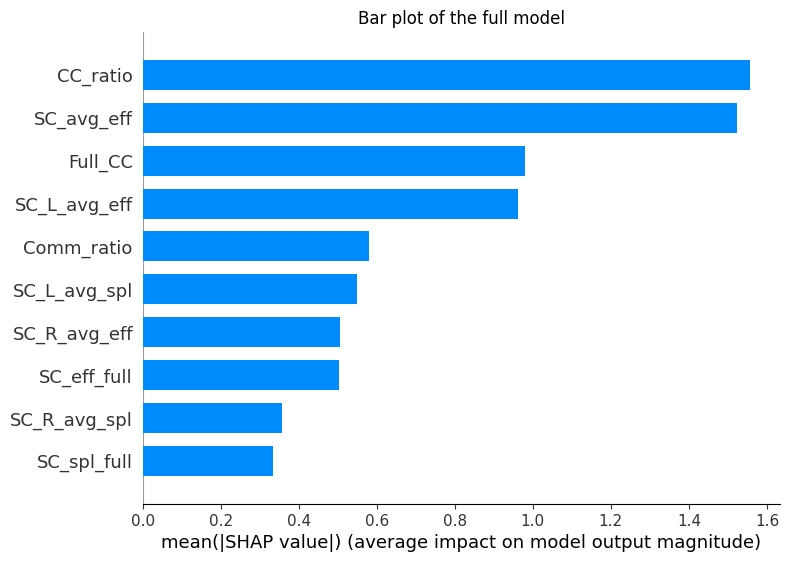

In [ ]:
shap.summary_plot(shap_values[0], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

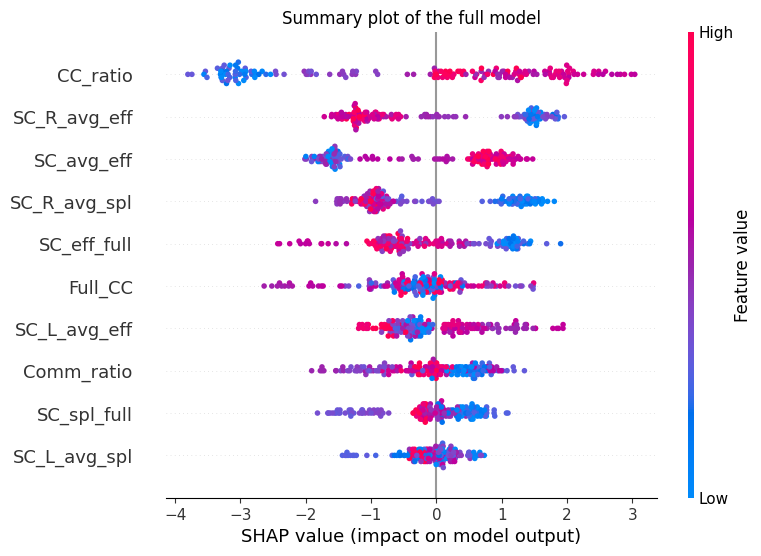

In [ ]:
shap.summary_plot(shap_values[1], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

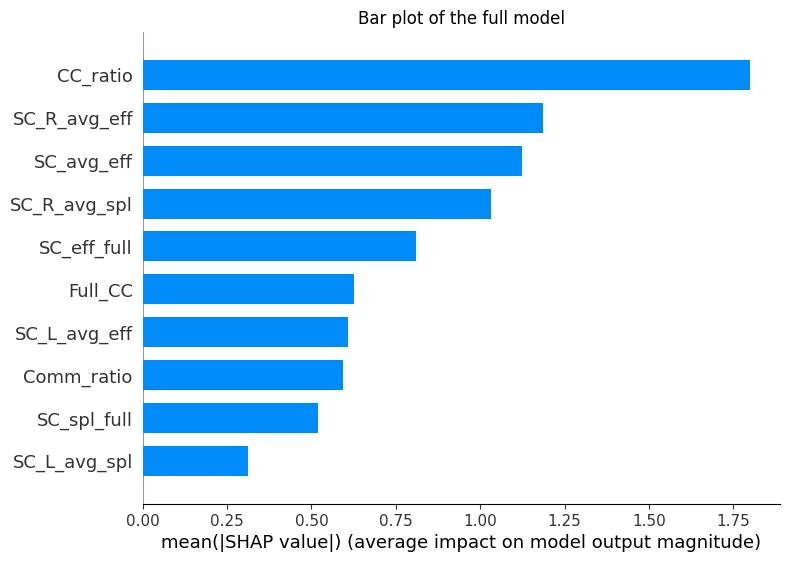

In [ ]:
shap.summary_plot(shap_values[1], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

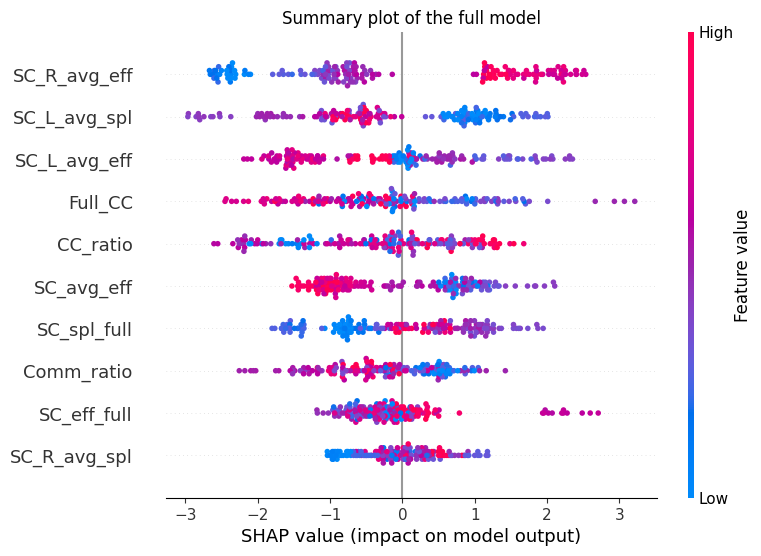

In [ ]:
shap.summary_plot(shap_values[2], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

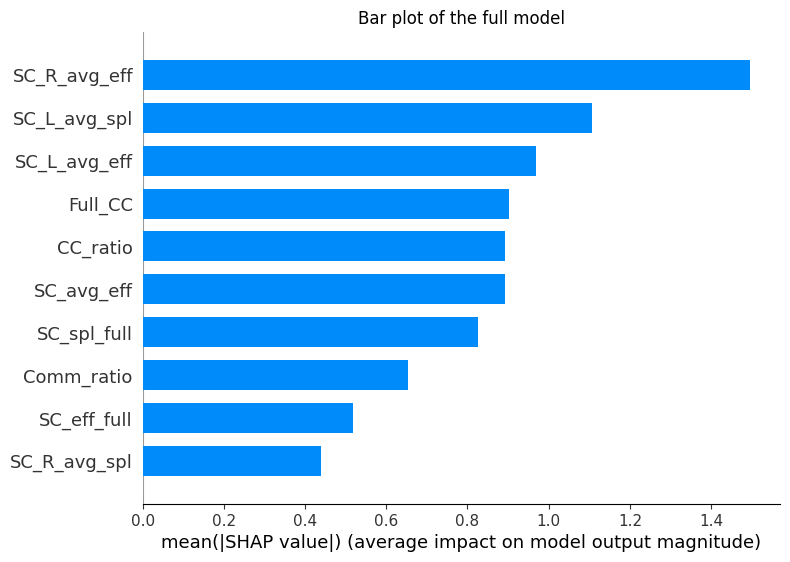

In [ ]:
shap.summary_plot(shap_values[2], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network Models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(512, input_dim = 10, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dropout(0.1))
    model.add(Dense(256, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dropout(0.1))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dropout(0.1))
    model.add(Dense(3, activation = 'softmax', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.00006)
    model.compile(loss = 'categorical_crossentropy', optimizer = optimizer, metrics = ['categorical_accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group"])["group"].count()

total = sum(y_distribution)

y_distribution

group
ad     43
cn     63
mci    65
Name: group, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution["ad"]/(total)),
                1: 1/(y_distribution["cn"]/(total)),
                2: 1/(y_distribution["mci"]/(total))}

array_ = []
for i, row in y_train.iterrows():
  array_.append(y_train.loc[i, "group"])

class_weights = compute_class_weight('balanced', classes=np.unique(y_train), y=array_)

class_weights_dict = dict(enumerate(class_weights))

model.fit(X_train, Y_train,
          batch_size=40,
          epochs=5500,
          callbacks=[callback],
          #class_weight=class_weights_dict,
          verbose=1,
          validation_data=(X_test, Y_test))


Epoch 1/5500
3/3 [==============================] - 2s 182ms/step - loss: 2.0164 - categorical_accuracy: 0.3697 - val_loss: 2.0142 - val_categorical_accuracy: 0.3846
Epoch 2/5500
3/3 [==============================] - 0s 33ms/step - loss: 2.0136 - categorical_accuracy: 0.3529 - val_loss: 2.0100 - val_categorical_accuracy: 0.3846
Epoch 3/5500
3/3 [==============================] - 0s 31ms/step - loss: 2.0109 - categorical_accuracy: 0.3613 - val_loss: 2.0056 - val_categorical_accuracy: 0.3846
Epoch 4/5500
3/3 [==============================] - 0s 24ms/step - loss: 2.0075 - categorical_accuracy: 0.3613 - val_loss: 2.0013 - val_categorical_accuracy: 0.3846
Epoch 5/5500
3/3 [==============================] - 0s 29ms/step - loss: 2.0033 - categorical_accuracy: 0.3613 - val_loss: 1.9975 - val_categorical_accuracy: 0.3846
Epoch 6/5500
3/3 [==============================] - 0s 21ms/step - loss: 1.9984 - categorical_accuracy: 0.3697 - val_loss: 1.9941 - val_categorical_accuracy: 0.3846
Epoch 7/5

In [ ]:
y_pred = model.predict(X_test)

2/2 [==============================] - 0s 4ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(np.argmax(Y_test, axis=1), y_pred = np.argmax(y_pred, axis = 1)))
print()
print("Classfication Report:")
print()
print(classification_report(np.argmax(Y_test, axis=1), y_pred = np.argmax(y_pred, axis = 1)))

Confusion Matrix:
[[ 3  3  8]
 [ 0 17  3]
 [ 4  7  7]]

Classfication Report:

              precision    recall  f1-score   support

           0       0.43      0.21      0.29        14
           1       0.63      0.85      0.72        20
           2       0.39      0.39      0.39        18

    accuracy                           0.52        52
   macro avg       0.48      0.48      0.47        52
weighted avg       0.49      0.52      0.49        52



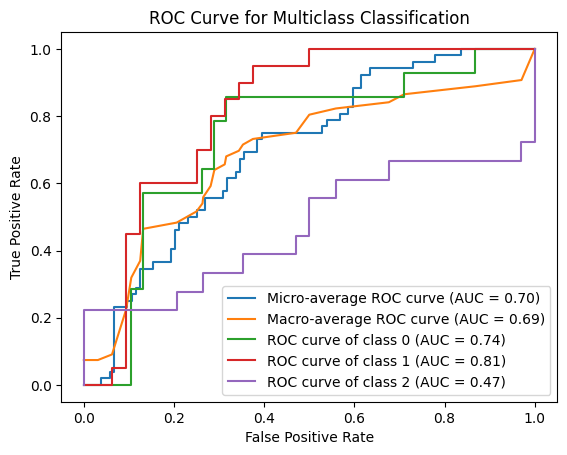

In [ ]:
from sklearn.preprocessing import label_binarize

n_classes= 3

# Binarize the true labels
y_true_binary = label_binarize(Y_test, classes=np.arange(n_classes))

# Compute ROC curve and ROC AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = metrics.roc_curve(y_true_binary[:, i], y_pred[:, i])
    roc_auc[i] = metrics.auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC AUC
fpr_micro, tpr_micro, _ = metrics.roc_curve(y_true_binary.ravel(), y_pred.ravel())
roc_auc_micro = metrics.auc(fpr_micro, tpr_micro)

# Compute macro-average ROC curve and ROC AUC
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr_macro = all_fpr
tpr_macro = mean_tpr
roc_auc_macro = metrics.auc(fpr_macro, tpr_macro)

# Plot micro-average ROC curve
plt.plot(fpr_micro, tpr_micro, label='Micro-average ROC curve (AUC = {:.2f})'.format(roc_auc_micro))

# Plot macro-average ROC curve
plt.plot(fpr_macro, tpr_macro, label='Macro-average ROC curve (AUC = {:.2f})'.format(roc_auc_macro))

# Plot ROC curve for each class
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label='ROC curve of class {} (AUC = {:.2f})'.format(i, roc_auc[i]))

# Add labels and legends
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Multiclass Classification')
plt.legend()
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 119ms/step


  0%|          | 0/171 [00:00<?, ?it/s]

320/320 [==============================] - 0s 1ms/step


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


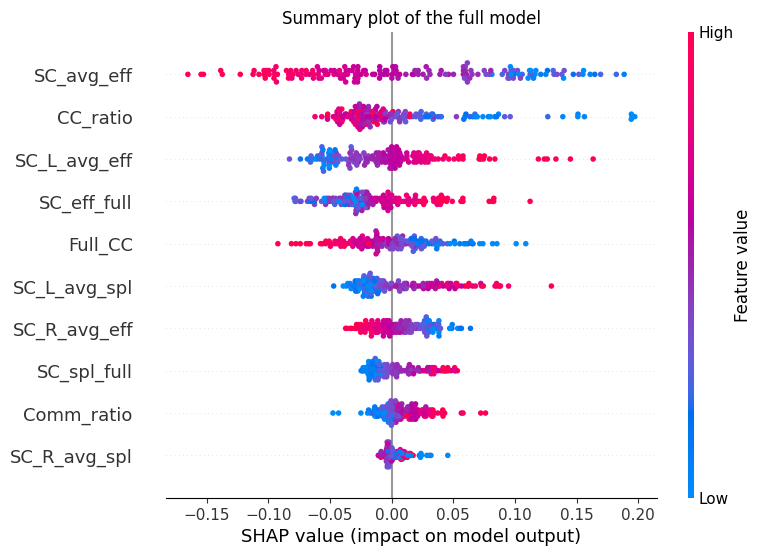

In [ ]:
shap.summary_plot(shap_values[0], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

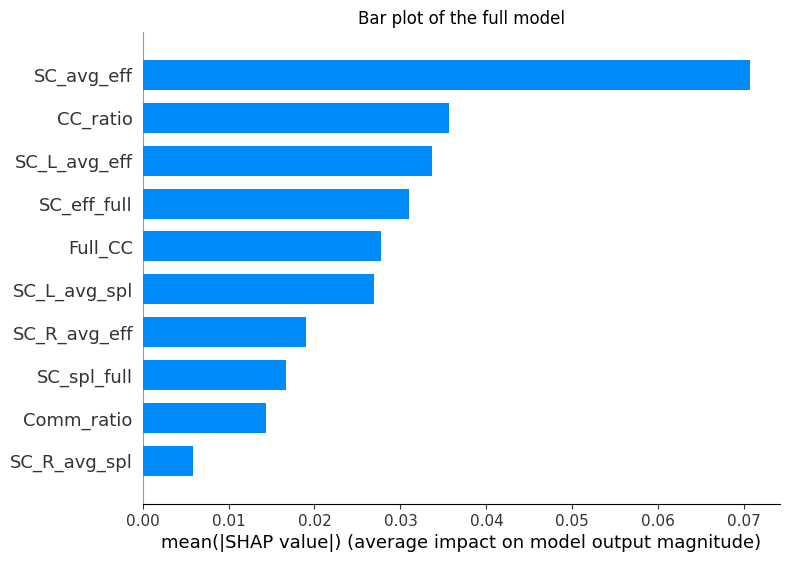

In [ ]:
shap.summary_plot(shap_values[0], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

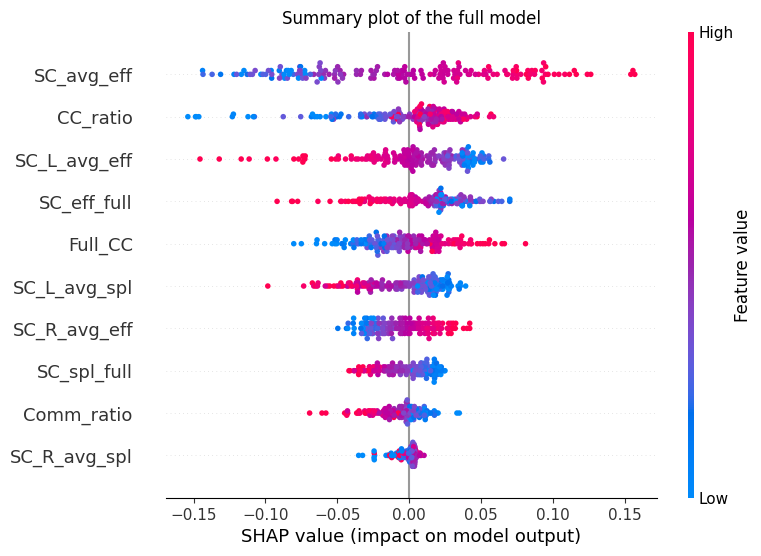

In [ ]:
shap.summary_plot(shap_values[1], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

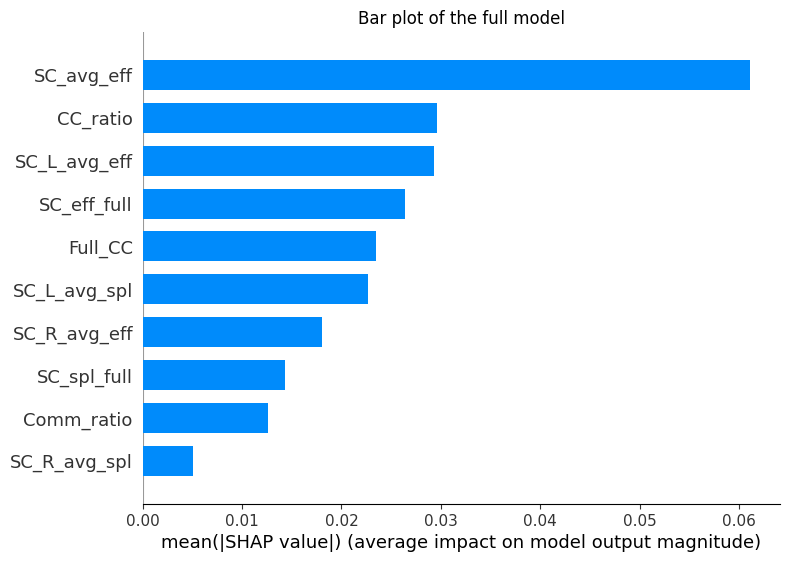

In [ ]:
shap.summary_plot(shap_values[1], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

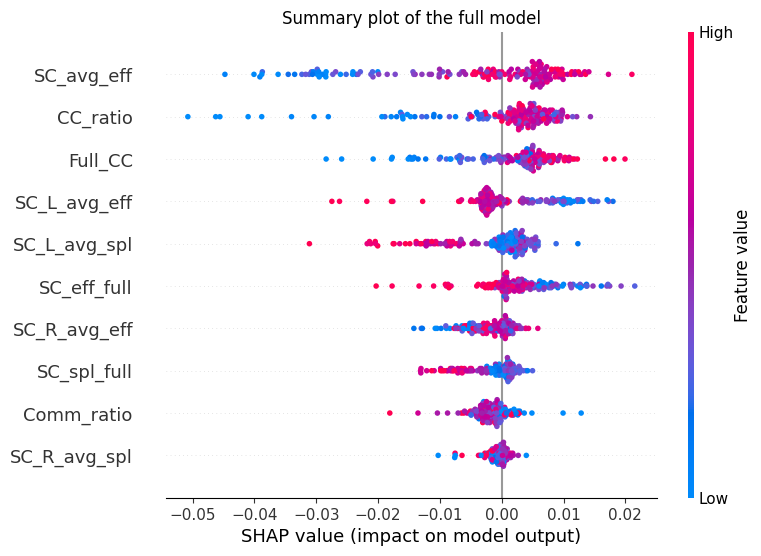

In [ ]:
shap.summary_plot(shap_values[2], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

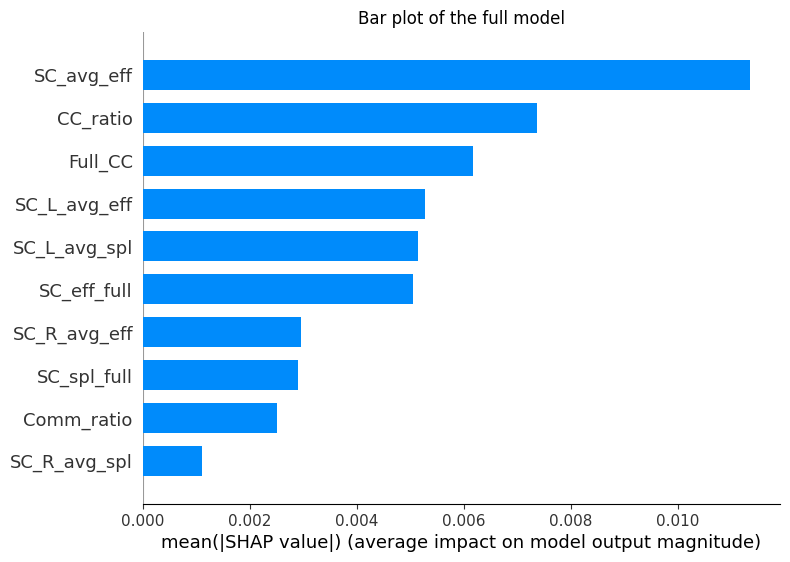

In [ ]:
shap.summary_plot(shap_values[2], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

##Classification CN-AD with connectivity

###Creation of the datasets

In [ ]:
x = matrices_cn_ad.drop(["group", "group_int", "Subject", "Age", "Sex", "Centre"], axis=1)
y = matrices_cn_ad[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex", "Centre"]
for i in matrices_cn_ad.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(matrices_cn_ad.columns)):
  if matrices_cn_ad.columns[i] not in not_matrices:
    if importances[j] > 0.04:
      final_columns.append(matrices_cn_ad.columns[i])
    j += 1

print(final_columns)

['Comm_ratio', 'SC_L_avg_spl', 'SC_L_avg_eff', 'SC_R_avg_spl', 'SC_R_avg_eff', 'SC_avg_spl', 'SC_avg_eff', 'CC_Central', 'BrainSegVol', 'CC_ratio', 'SC_spl_full', 'SC_eff_full', 'Full_CC']


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


In [ ]:
# dataset cn vs ad
x = matrices_cn_ad[final_columns]
y = matrices_cn_ad[["group_int"]]

x_train, x_test = train_test_split(x, test_size=0.3, random_state=42)
y_train, y_test = train_test_split(y, test_size=0.3, random_state=42)

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

X = X.values
Y = y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

In [ ]:
# dataset mci vs mci-ad
X_matrices_2 = matrices_mci_mciad[final_columns]
Y_matrices_2 = matrices_mci_mciad[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X_2 = scaler.fit_transform(X_matrices_2)
X_2 = pd.DataFrame(X_2)

X_2 = X_2.values
Y_2 = Y_matrices_2.values

In [ ]:
# dataset cn vs cn-ad
X_matrices_3 = matrices_cn_cnad_cnmci[final_columns]
Y_matrices_3 = matrices_cn_cnad_cnmci[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X_3 = scaler.fit_transform(X_matrices_3)
X_3 = pd.DataFrame(X_3)

X_3 = X_3.values
Y_3 = Y_matrices_3.values

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)
y_pred_2=xgboost_reg.predict(X_2)
y_pred_3=xgboost_reg.predict(X_3)

####Random Forest Results

In [ ]:
# Confusion Matrix CN-AD
print("Confusion Matrix CN-AD:")
print(confusion_matrix(y_test, y_pred))
print()
print("Classfication Report CN-AD:")
print()
print(classification_report(y_test, y_pred))

Confusion Matrix CN-AD:
[[15  4]
 [ 7  6]]

Classfication Report CN-AD:

              precision    recall  f1-score   support

         0.0       0.68      0.79      0.73        19
         1.0       0.60      0.46      0.52        13

    accuracy                           0.66        32
   macro avg       0.64      0.63      0.63        32
weighted avg       0.65      0.66      0.65        32



In [ ]:
# Confusion Matrix MCI-MCI-AD
print("Confusion Matrix MCI-MCI-AD:")
print(confusion_matrix(Y_2, y_pred_2))
print()
print("Classfication Report MCI-MCI-AD:")
print()
print(classification_report(Y_2, y_pred_2))

Confusion Matrix MCI-MCI-AD:
[[31 34]
 [ 9 15]]

Classfication Report MCI-MCI-AD:

              precision    recall  f1-score   support

         0.0       0.78      0.48      0.59        65
         1.0       0.31      0.62      0.41        24

    accuracy                           0.52        89
   macro avg       0.54      0.55      0.50        89
weighted avg       0.65      0.52      0.54        89



In [ ]:
# Confusion Matrix CN-CN-AD
print("Confusion Matrix CN-CN-AD:")
print(confusion_matrix(Y_3, y_pred_3))
print()
print("Classfication Report CN-CN-AD:")
print()
print(classification_report(Y_3, y_pred_3))

Confusion Matrix CN-CN-AD:
[[53 10]
 [ 7  8]]

Classfication Report CN-CN-AD:

              precision    recall  f1-score   support

         0.0       0.88      0.84      0.86        63
         1.0       0.44      0.53      0.48        15

    accuracy                           0.78        78
   macro avg       0.66      0.69      0.67        78
weighted avg       0.80      0.78      0.79        78



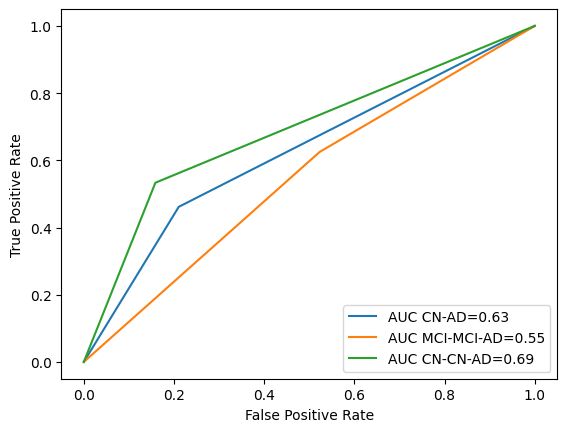

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

fpr_2, tpr_2, _ = metrics.roc_curve(Y_2,  y_pred_2)
auc_2 = metrics.roc_auc_score(Y_2, y_pred_2)

fpr_3, tpr_3, _ = metrics.roc_curve(Y_3,  y_pred_3)
auc_3 = metrics.roc_auc_score(Y_3, y_pred_3)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.plot(fpr_2,tpr_2,label="AUC MCI-MCI-AD="+str(round(auc_2, 2)))
plt.plot(fpr_3,tpr_3,label="AUC CN-CN-AD="+str(round(auc_3, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer=shap.Explainer(xgboost_reg)
shap_values_data=explainer(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


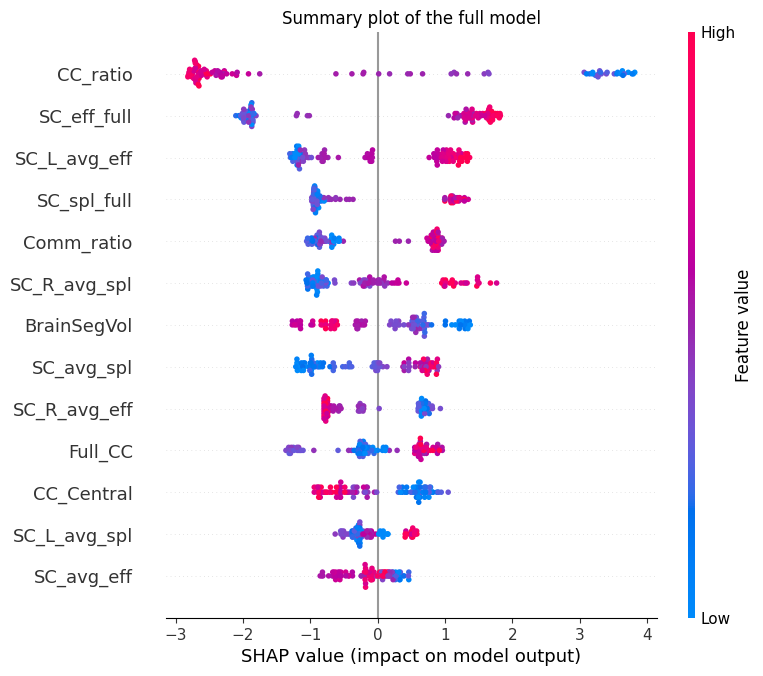

In [ ]:
shap.summary_plot(shap_values_data, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

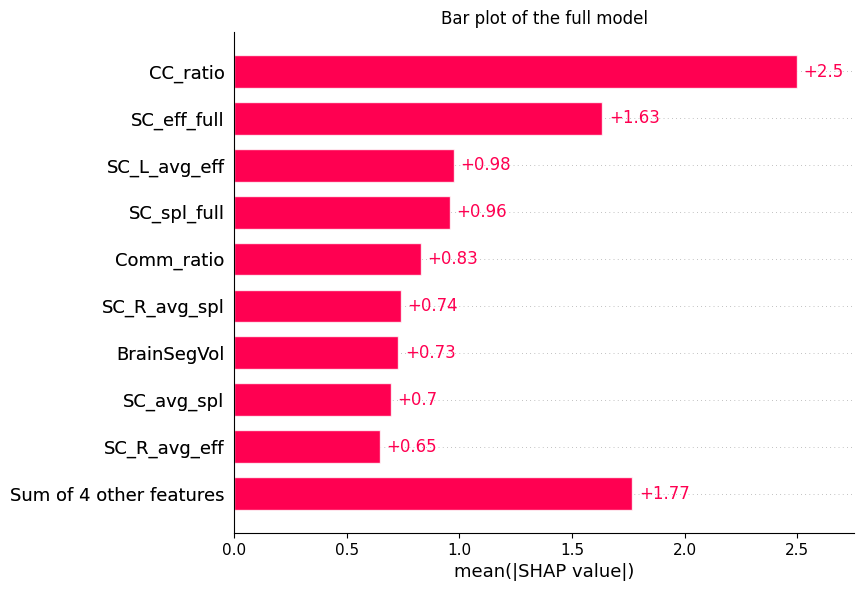

In [ ]:
shap.plots.bar(shap_values_data, show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network Models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(256, input_dim = 13, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.00007),activity_regularizer=keras.regularizers.L2(0.00007))) # Rectified Linear Unit Activation Function
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.00007),activity_regularizer=keras.regularizers.L2(0.00007)))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.00007),activity_regularizer=keras.regularizers.L2(0.00007)))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.00007),activity_regularizer=keras.regularizers.L2(0.00007)))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.00007),activity_regularizer=keras.regularizers.L2(0.00007)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.00007),activity_regularizer=keras.regularizers.L2(0.00007)))
    model.add(Dense(4, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.00007),activity_regularizer=keras.regularizers.L2(0.00007)))
    model.add(Dense(2, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.00007),activity_regularizer=keras.regularizers.L2(0.00007)))
    model.add(Dense(1, activation = 'sigmoid', kernel_regularizer=keras.regularizers.L1(0.00007),activity_regularizer=keras.regularizers.L2(0.00007))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.00005)
    model.compile(loss = 'binary_crossentropy', optimizer = optimizer, metrics = ['accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group_int"])["group_int"].count()

total = sum(y_distribution)

y_distribution

group_int
0.0    63
1.0    43
Name: group_int, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution[0]/(total)),
                1: 1/(y_distribution[1]/(total))}

model.fit(X_train, Y_train,
          batch_size=80,
          epochs=5000,
          verbose=1,
          callbacks=[callback],
          #class_weight=class_weight,
          validation_data=(X_test, Y_test))


Epoch 1/5000
1/1 [==============================] - 32s 32s/step - loss: 0.9329 - accuracy: 0.5946 - val_loss: 0.9327 - val_accuracy: 0.5938
Epoch 2/5000
1/1 [==============================] - 0s 34ms/step - loss: 0.9327 - accuracy: 0.5946 - val_loss: 0.9325 - val_accuracy: 0.5938
Epoch 3/5000
1/1 [==============================] - 0s 38ms/step - loss: 0.9325 - accuracy: 0.5946 - val_loss: 0.9324 - val_accuracy: 0.5938
Epoch 4/5000
1/1 [==============================] - 0s 57ms/step - loss: 0.9324 - accuracy: 0.5946 - val_loss: 0.9322 - val_accuracy: 0.5938
Epoch 5/5000
1/1 [==============================] - 0s 35ms/step - loss: 0.9322 - accuracy: 0.5946 - val_loss: 0.9320 - val_accuracy: 0.5938
Epoch 6/5000
1/1 [==============================] - 0s 33ms/step - loss: 0.9320 - accuracy: 0.5946 - val_loss: 0.9319 - val_accuracy: 0.5938
Epoch 7/5000
1/1 [==============================] - 0s 33ms/step - loss: 0.9319 - accuracy: 0.5946 - val_loss: 0.9317 - val_accuracy: 0.5938
Epoch 8/5000


In [ ]:
y_pred = model.predict(X_test)
y_pred_2 = model.predict(X_2)
y_pred_3 = model.predict(X_3)

3/3 [==============================] - 0s 2ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix CN-AD:")
print(confusion_matrix(Y_test, np.round(y_pred)))
print()
print("Classfication Report CN-AD:")
print()
print(classification_report(Y_test, np.round(y_pred)))

Confusion Matrix CN-AD:
[[17  2]
 [ 5  8]]

Classfication Report CN-AD:

              precision    recall  f1-score   support

         0.0       0.77      0.89      0.83        19
         1.0       0.80      0.62      0.70        13

    accuracy                           0.78        32
   macro avg       0.79      0.76      0.76        32
weighted avg       0.78      0.78      0.77        32



In [ ]:
print("Confusion Matrix MCI-MCI-AD:")
print(confusion_matrix(Y_2, np.round(y_pred_2)))
print()
print("Classfication Report MCI-MCI-AD:")
print()
print(classification_report(Y_2, np.round(y_pred_2)))

Confusion Matrix MCI-MCI-AD:
[[31 34]
 [ 7 17]]

Classfication Report MCI-MCI-AD:

              precision    recall  f1-score   support

         0.0       0.82      0.48      0.60        65
         1.0       0.33      0.71      0.45        24

    accuracy                           0.54        89
   macro avg       0.57      0.59      0.53        89
weighted avg       0.69      0.54      0.56        89



In [ ]:
print("Confusion Matrix CN-CN-AD:")
print(confusion_matrix(Y_3, np.round(y_pred_3)))
print()
print("Classfication Report CN-CN-AD:")
print()
print(classification_report(Y_3, np.round(y_pred_3)))

Confusion Matrix CN-CN-AD:
[[41 22]
 [ 2 13]]

Classfication Report CN-CN-AD:

              precision    recall  f1-score   support

         0.0       0.95      0.65      0.77        63
         1.0       0.37      0.87      0.52        15

    accuracy                           0.69        78
   macro avg       0.66      0.76      0.65        78
weighted avg       0.84      0.69      0.72        78



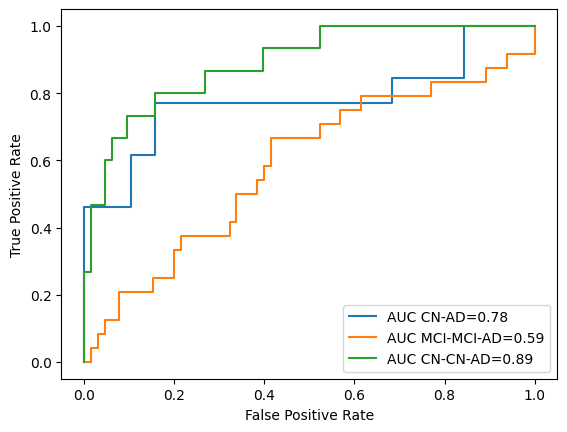

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

fpr_2, tpr_2, _ = metrics.roc_curve(Y_2,  y_pred_2)
auc_2 = metrics.roc_auc_score(Y_2, y_pred_2)

fpr_3, tpr_3, _ = metrics.roc_curve(Y_3,  y_pred_3)
auc_3 = metrics.roc_auc_score(Y_3, y_pred_3)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.plot(fpr_2,tpr_2,label="AUC MCI-MCI-AD="+str(round(auc_2, 2)))
plt.plot(fpr_3,tpr_3,label="AUC CN-CN-AD="+str(round(auc_3, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

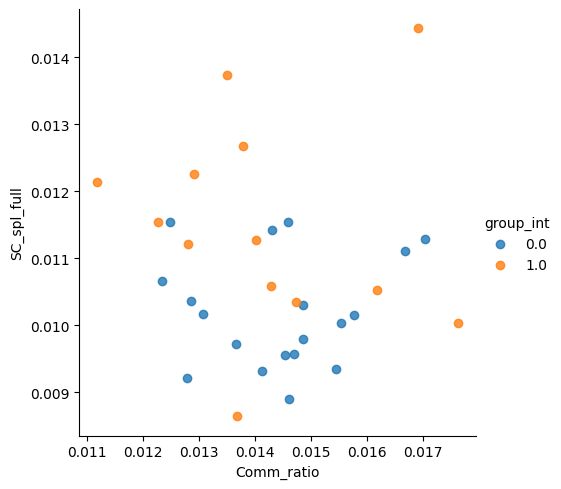

In [ ]:
result = pd.concat([x_test, y_test], axis=1)

sns.lmplot(x="Comm_ratio", y="SC_spl_full", data=result, hue='group_int', fit_reg=False)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 158ms/step


  0%|          | 0/106 [00:00<?, ?it/s]

649/649 [==============================] - 1s 1ms/step


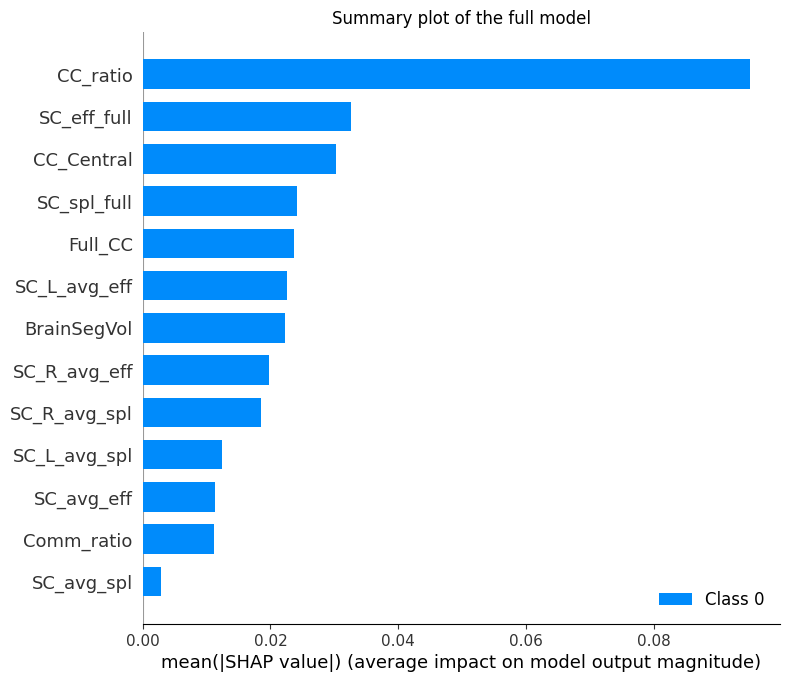

In [ ]:
shap.summary_plot(shap_values, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

##Classification with CN CN-MCI with connectivity


###Creation of datasets

In [ ]:
x = matrices_cn_cnad_cnmci.drop(["group", "group_int", "Subject", "Age", "Sex", "Centre"], axis=1)
y = matrices_cn_cnad_cnmci[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex", "Centre"]
for i in matrices_cn_cnad_cnmci.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(matrices_cn_cnad_cnmci.columns)):
  if matrices_cn_cnad_cnmci.columns[i] not in not_matrices:
    if importances[j] > 0.04:
      final_columns.append(matrices_cn_cnad_cnmci.columns[i])
    j += 1

print(final_columns)

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


['Comm_ratio', 'SC_avg_eff', 'CC_Sag_area', 'CC_Central', 'CC_Mid_Anterior', 'SC_eff_full', 'Full_CC', 'CC_Sag_area_sqrt']


In [ ]:
x = matrices_cn_cnad_cnmci[final_columns]
y = matrices_cn_cnad_cnmci[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

X = X.values
Y = y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)

####Random Forest Results

In [ ]:
# Confusion Matrix CN-CN-MCI-CN-AD
print("Confusion Matrix:")
print(confusion_matrix(Y_test, y_pred))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, y_pred))

Confusion Matrix:
[[17  3]
 [ 2  2]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.89      0.85      0.87        20
         1.0       0.40      0.50      0.44         4

    accuracy                           0.79        24
   macro avg       0.65      0.68      0.66        24
weighted avg       0.81      0.79      0.80        24



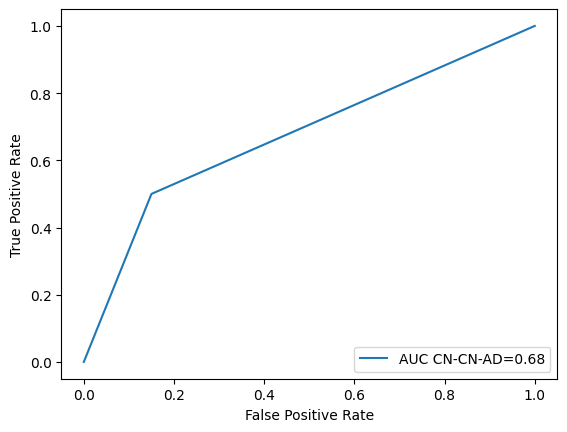

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-CN-AD="+str(round(auc, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer=shap.Explainer(xgboost_reg)
shap_values_data=explainer(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


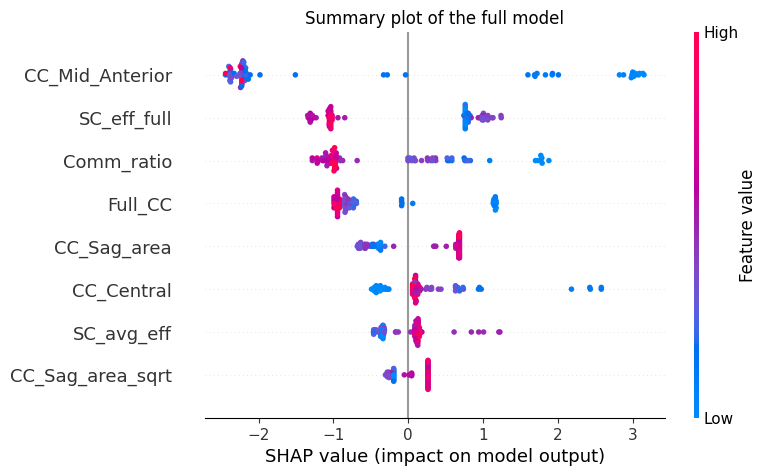

In [ ]:
shap.summary_plot(shap_values_data, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

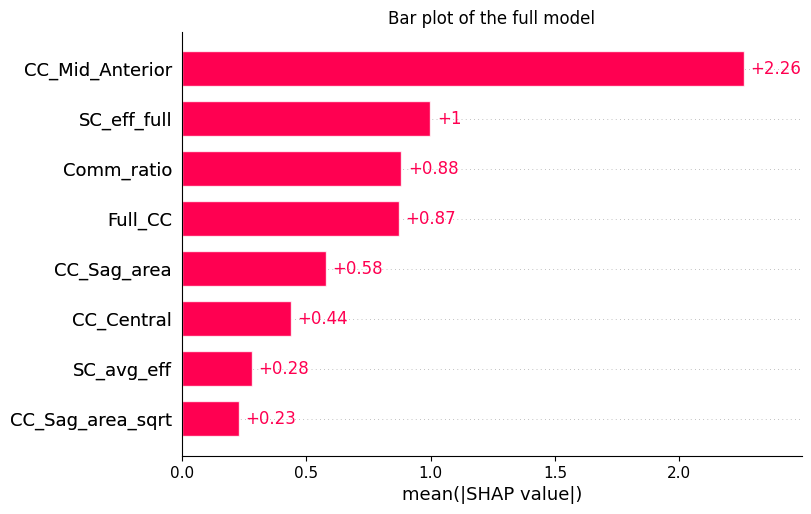

In [ ]:
shap.plots.bar(shap_values_data, show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(256, input_dim = 8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003))) # Rectified Linear Unit Activation Function
    model.add(Dropout(0.1))
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dropout(0.1))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dropout(0.1))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dropout(0.1))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dropout(0.1))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dropout(0.1))
    model.add(Dense(4, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dropout(0.1))
    model.add(Dense(2, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dropout(0.1))
    model.add(Dense(1, activation = 'sigmoid', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.00007)
    model.compile(loss = 'binary_crossentropy', optimizer = optimizer, metrics = ['accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group_int"])["group_int"].count()

total = sum(y_distribution)

y_distribution

group_int
0.0    63
1.0    15
Name: group_int, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution[0]/(total)),
                1: 1/(y_distribution[1]/(total))}

model.fit(X_train, Y_train,
          batch_size=40,
          epochs=5000,
          verbose=1,
          callbacks=[callback],
          class_weight=class_weight,
          validation_data=(X_test, Y_test))

Epoch 1/5000
2/2 [==============================] - 4s 518ms/step - loss: 2.4164 - accuracy: 0.3333 - val_loss: 1.6938 - val_accuracy: 0.1667
Epoch 2/5000
2/2 [==============================] - 0s 62ms/step - loss: 2.4147 - accuracy: 0.2778 - val_loss: 1.6922 - val_accuracy: 0.1667
Epoch 3/5000
2/2 [==============================] - 0s 70ms/step - loss: 2.4120 - accuracy: 0.2037 - val_loss: 1.6906 - val_accuracy: 0.1667
Epoch 4/5000
2/2 [==============================] - 0s 68ms/step - loss: 2.4124 - accuracy: 0.2037 - val_loss: 1.6889 - val_accuracy: 0.1667
Epoch 5/5000
2/2 [==============================] - 0s 65ms/step - loss: 2.4109 - accuracy: 0.2222 - val_loss: 1.6873 - val_accuracy: 0.1667
Epoch 6/5000
2/2 [==============================] - 0s 65ms/step - loss: 2.4100 - accuracy: 0.1852 - val_loss: 1.6857 - val_accuracy: 0.1667
Epoch 7/5000
2/2 [==============================] - 0s 68ms/step - loss: 2.4082 - accuracy: 0.2222 - val_loss: 1.6842 - val_accuracy: 0.1667
Epoch 8/5000

In [ ]:
y_prediction = model.predict(X_test)

1/1 [==============================] - 0s 169ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(Y_test, np.round(y_prediction)))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, np.round(y_prediction)))

Confusion Matrix:
[[17  3]
 [ 1  3]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.94      0.85      0.89        20
         1.0       0.50      0.75      0.60         4

    accuracy                           0.83        24
   macro avg       0.72      0.80      0.75        24
weighted avg       0.87      0.83      0.85        24



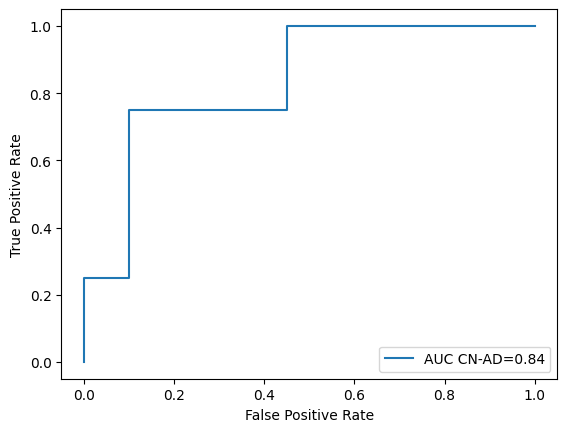

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_prediction)
auc = metrics.roc_auc_score(Y_test, y_prediction)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 23ms/step


  0%|          | 0/78 [00:00<?, ?it/s]

80/80 [==============================] - 0s 1ms/step


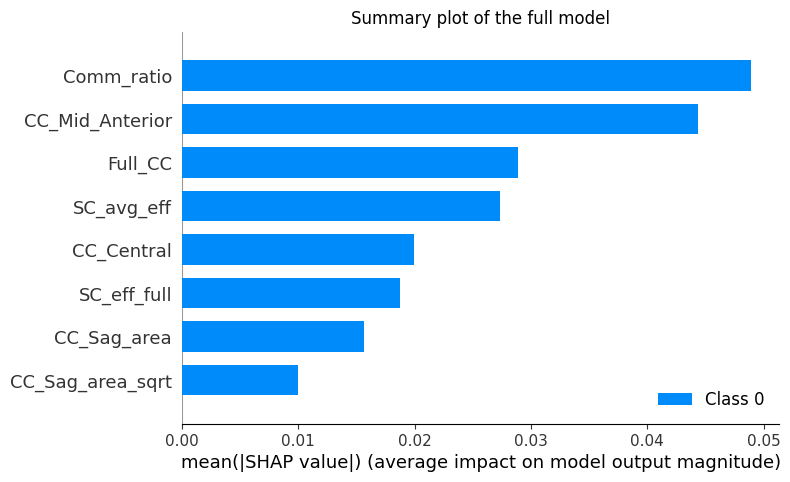

In [ ]:
shap.summary_plot(shap_values, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

##Classification with MCI MCI-AD with connectivity


###Creation of datasets

In [ ]:
x = matrices_mci_mciad.drop(["group", "group_int", "Subject", "Age", "Sex", "Centre"], axis=1)
y = matrices_mci_mciad[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex", "Centre"]
for i in matrices_mci_mciad.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(matrices_mci_mciad.columns)):
  if matrices_mci_mciad.columns[i] not in not_matrices:
    if importances[j] > 0.01:
      final_columns.append(matrices_mci_mciad.columns[i])
    j += 1

print(final_columns)

['SC_L_avg_spl', 'SC_R_avg_eff', 'SC_avg_spl', 'SC_avg_eff', 'CC_Central', 'CC_ratio', 'SC_spl_full', 'CC_ratio_area']


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


In [ ]:
x = matrices_mci_mciad[final_columns]
y = matrices_mci_mciad[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

X = X.values
Y = y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)

####Random Forest Results

In [ ]:
# Confusion Matrix CN-CN-MCI-CN-AD
print("Confusion Matrix:")
print(confusion_matrix(Y_test, y_pred))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, y_pred))

Confusion Matrix:
[[19  2]
 [ 5  1]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.79      0.90      0.84        21
         1.0       0.33      0.17      0.22         6

    accuracy                           0.74        27
   macro avg       0.56      0.54      0.53        27
weighted avg       0.69      0.74      0.71        27



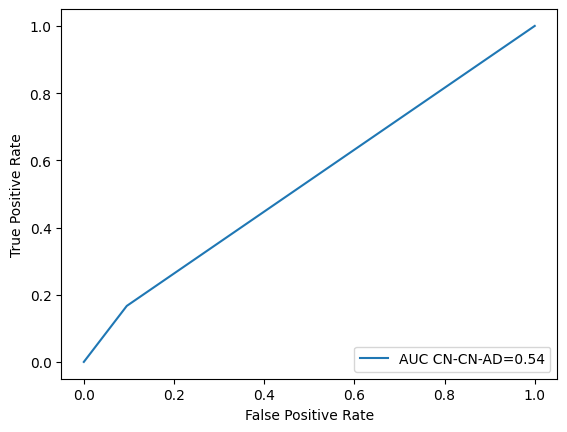

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-CN-AD="+str(round(auc, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer=shap.Explainer(xgboost_reg)
shap_values_data=explainer(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


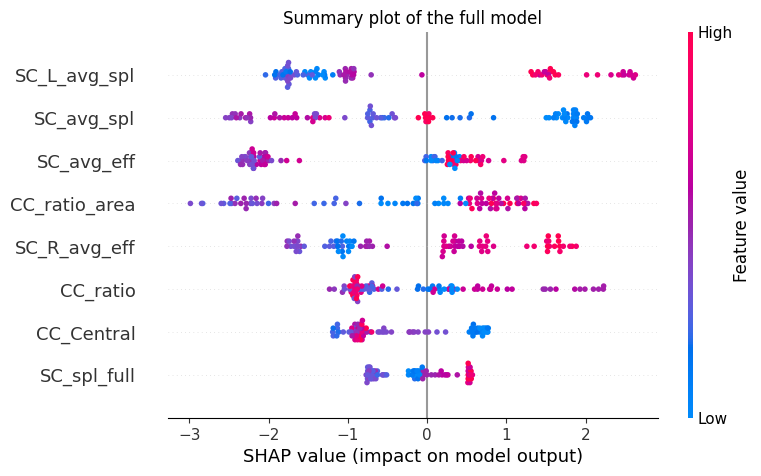

In [ ]:
shap.summary_plot(shap_values_data, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

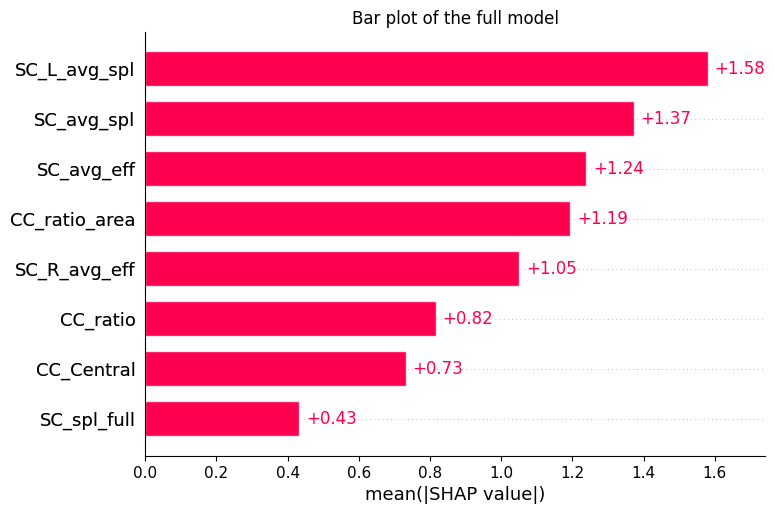

In [ ]:
shap.plots.bar(shap_values_data, show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(256, input_dim = 8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003))) # Rectified Linear Unit Activation Function
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(4, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(2, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(1, activation = 'sigmoid', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.0007)
    model.compile(loss = 'binary_crossentropy', optimizer = optimizer, metrics = ['accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group_int"])["group_int"].count()

total = sum(y_distribution)

y_distribution

group_int
0.0    65
1.0    24
Name: group_int, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution[0]/(total)),
                1: 1/(y_distribution[1]/(total))}

model.fit(X_train, Y_train,
          batch_size=40,
          epochs=5000,
          verbose=1,
          callbacks=[callback],
          class_weight=class_weight,
          validation_data=(X_test, Y_test))


Epoch 1/5000
3/3 [==============================] - 2s 162ms/step - loss: 2.4140 - accuracy: 0.3710 - val_loss: 1.6663 - val_accuracy: 0.2222
Epoch 2/5000
3/3 [==============================] - 0s 23ms/step - loss: 2.3877 - accuracy: 0.2903 - val_loss: 1.6403 - val_accuracy: 0.2222
Epoch 3/5000
3/3 [==============================] - 0s 13ms/step - loss: 2.3613 - accuracy: 0.2903 - val_loss: 1.6141 - val_accuracy: 0.2222
Epoch 4/5000
3/3 [==============================] - 0s 14ms/step - loss: 2.3349 - accuracy: 0.2903 - val_loss: 1.5880 - val_accuracy: 0.2222
Epoch 5/5000
3/3 [==============================] - 0s 13ms/step - loss: 2.3087 - accuracy: 0.2903 - val_loss: 1.5620 - val_accuracy: 0.2222
Epoch 6/5000
3/3 [==============================] - 0s 14ms/step - loss: 2.2828 - accuracy: 0.2903 - val_loss: 1.5364 - val_accuracy: 0.2222
Epoch 7/5000
3/3 [==============================] - 0s 15ms/step - loss: 2.2572 - accuracy: 0.2903 - val_loss: 1.5113 - val_accuracy: 0.2222
Epoch 8/5000

In [ ]:
y_prediction = model.predict(X_test)

1/1 [==============================] - 0s 131ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(Y_test, np.round(y_prediction)))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, np.round(y_prediction)))

Confusion Matrix:
[[21  0]
 [ 3  3]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.88      1.00      0.93        21
         1.0       1.00      0.50      0.67         6

    accuracy                           0.89        27
   macro avg       0.94      0.75      0.80        27
weighted avg       0.90      0.89      0.87        27



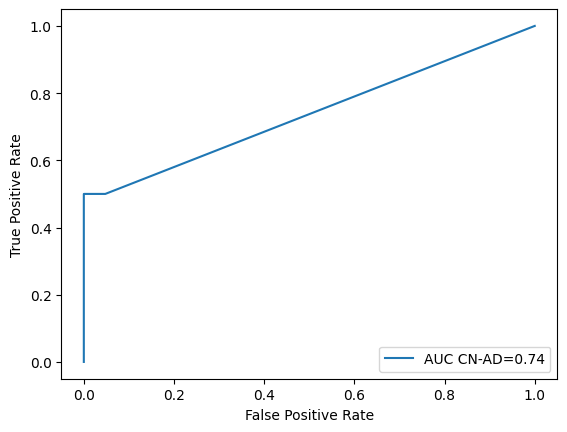

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_prediction)
auc = metrics.roc_auc_score(Y_test, y_prediction)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 31ms/step


  0%|          | 0/89 [00:00<?, ?it/s]

80/80 [==============================] - 0s 1ms/step


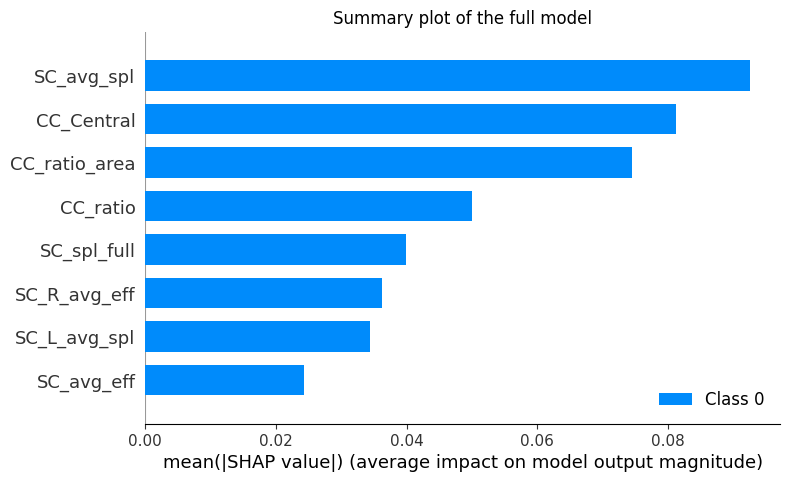

In [ ]:
shap.summary_plot(shap_values, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

In [ ]:
shap.plots.bar(shap_values, show=False)
plt.title("Bar plot of the full model")
plt.show()

AssertionError: ignored

#Classifier Only with Morphology Information

##Classifier CN-MCI-AD only Morphology Information

###Creation of the datasets

In [ ]:
x = recon_all_cn_mci_ad.drop(["group", "group_int", "Subject", "Age", "Sex"], axis=1)
y = recon_all_cn_mci_ad[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex"]
for i in recon_all_cn_mci_ad.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(recon_all_cn_mci_ad.columns)):
  if recon_all_cn_mci_ad.columns[i] not in not_matrices:
    if importances[j] > 0.07:
      final_columns.append(recon_all_cn_mci_ad.columns[i])
    j += 1

print(final_columns)

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


['Left_Inf_Lat_Vent', 'Left_Putamen', 'Third_Ventricle', 'Brain_Stem', 'Left_Hippocampus', 'Left_Amygdala', 'Left_VentralDC', 'Right_Inf_Lat_Vent', 'Right_Cerebellum_White_Matter', 'Right_Thalamus_Proper', 'Right_Putamen', 'Right_Hippocampus', 'Right_Amygdala', 'lhCortexVol', 'rhCortexVol', 'CortexVol', 'SubCortGrayVol', 'TotalGrayVol', 'SurfaceHoles']


In [ ]:
x = recon_all_cn_mci_ad[final_columns]
y = recon_all_cn_mci_ad[["group"]]

x_train, x_test = train_test_split(x, test_size=0.3, random_state=42)
y_train, y_test = train_test_split(y, test_size=0.3, random_state=42)

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

Y = pd.get_dummies(y)

X = X.values
Y = Y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)

####Random Forest Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(np.argmax(Y_test, axis = 1), np.argmax(y_pred, axis = 1)))
print()
print("Classfication Report:")
print()
print(classification_report(np.argmax(Y_test, axis = 1), np.argmax(y_pred, axis = 1)))

Confusion Matrix:
[[ 7  0  7]
 [ 3 15  5]
 [ 5  4  7]]

Classfication Report:

              precision    recall  f1-score   support

           0       0.47      0.50      0.48        14
           1       0.79      0.65      0.71        23
           2       0.37      0.44      0.40        16

    accuracy                           0.55        53
   macro avg       0.54      0.53      0.53        53
weighted avg       0.58      0.55      0.56        53



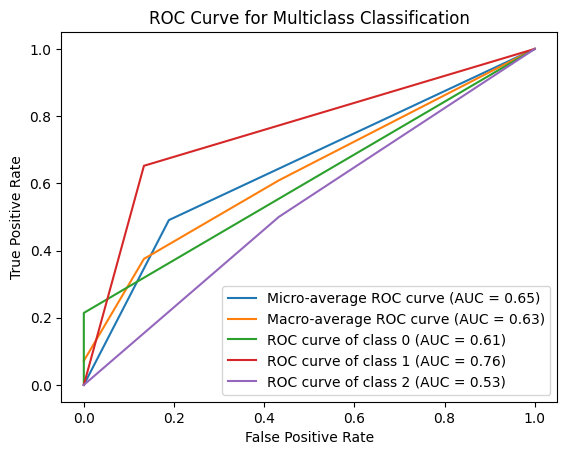

In [ ]:
from sklearn.preprocessing import label_binarize

n_classes= 3

# Binarize the true labels
y_true_binary = label_binarize(Y_test, classes=np.arange(n_classes))

# Compute ROC curve and ROC AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = metrics.roc_curve(y_true_binary[:, i], y_pred[:, i])
    roc_auc[i] = metrics.auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC AUC
fpr_micro, tpr_micro, _ = metrics.roc_curve(y_true_binary.ravel(), y_pred.ravel())
roc_auc_micro = metrics.auc(fpr_micro, tpr_micro)

# Compute macro-average ROC curve and ROC AUC
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr_macro = all_fpr
tpr_macro = mean_tpr
roc_auc_macro = metrics.auc(fpr_macro, tpr_macro)

# Plot micro-average ROC curve
plt.plot(fpr_micro, tpr_micro, label='Micro-average ROC curve (AUC = {:.2f})'.format(roc_auc_micro))

# Plot macro-average ROC curve
plt.plot(fpr_macro, tpr_macro, label='Macro-average ROC curve (AUC = {:.2f})'.format(roc_auc_macro))

# Plot ROC curve for each class
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label='ROC curve of class {} (AUC = {:.2f})'.format(i, roc_auc[i]))

# Add labels and legends
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Multiclass Classification')
plt.legend()
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.Explainer(xgboost_reg)
shap_values = explainer.shap_values(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


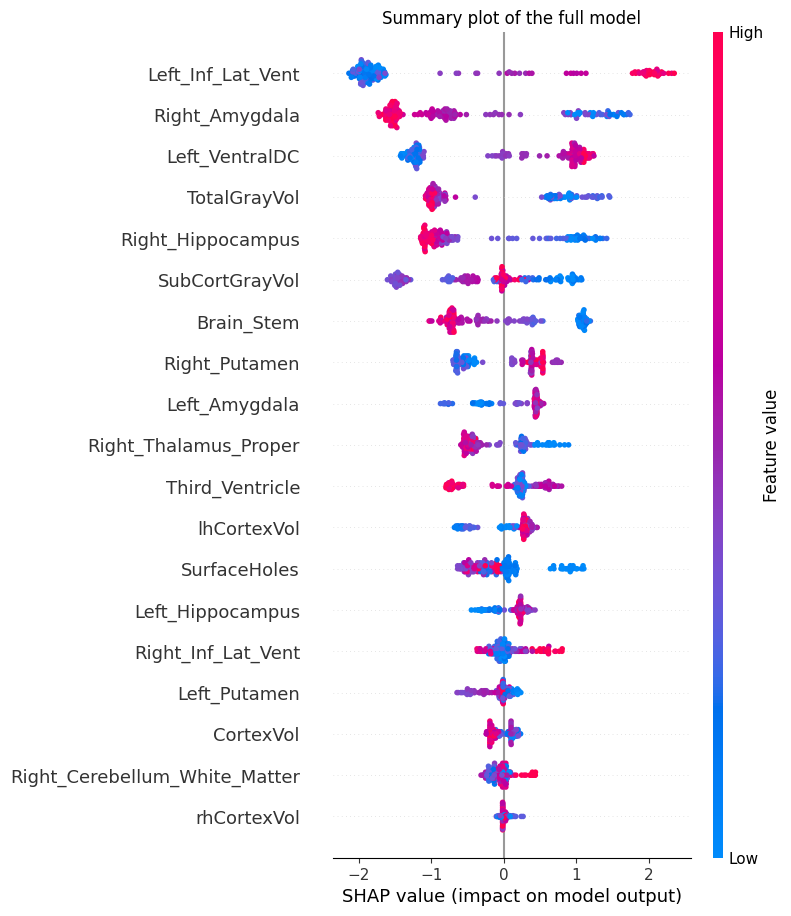

In [ ]:
shap.summary_plot(shap_values[0], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

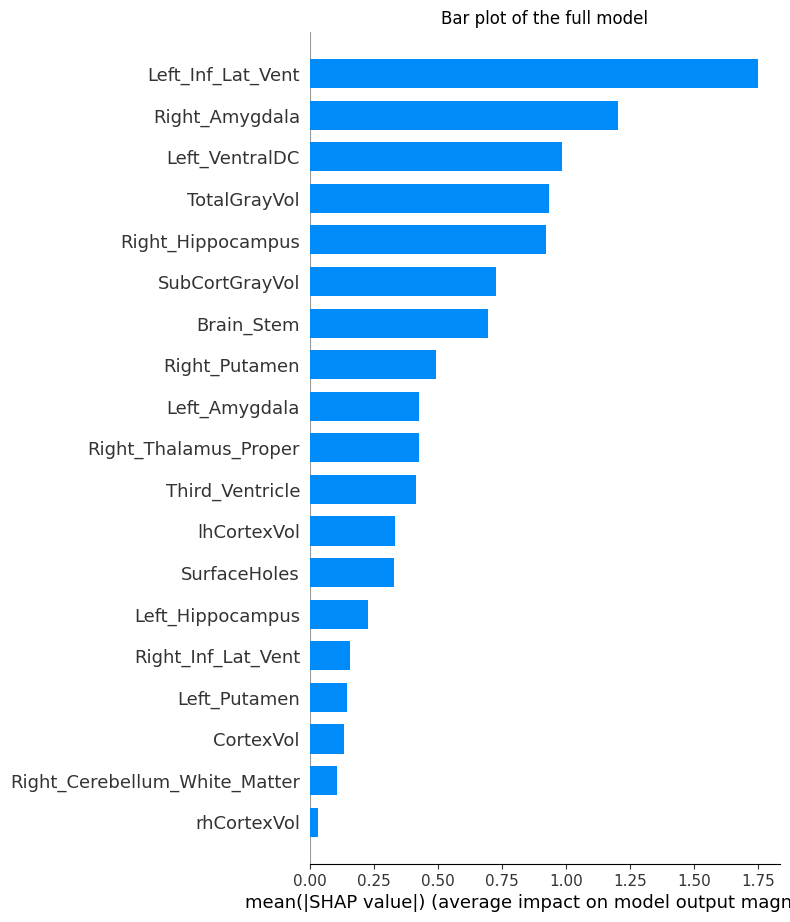

In [ ]:
shap.summary_plot(shap_values[0], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

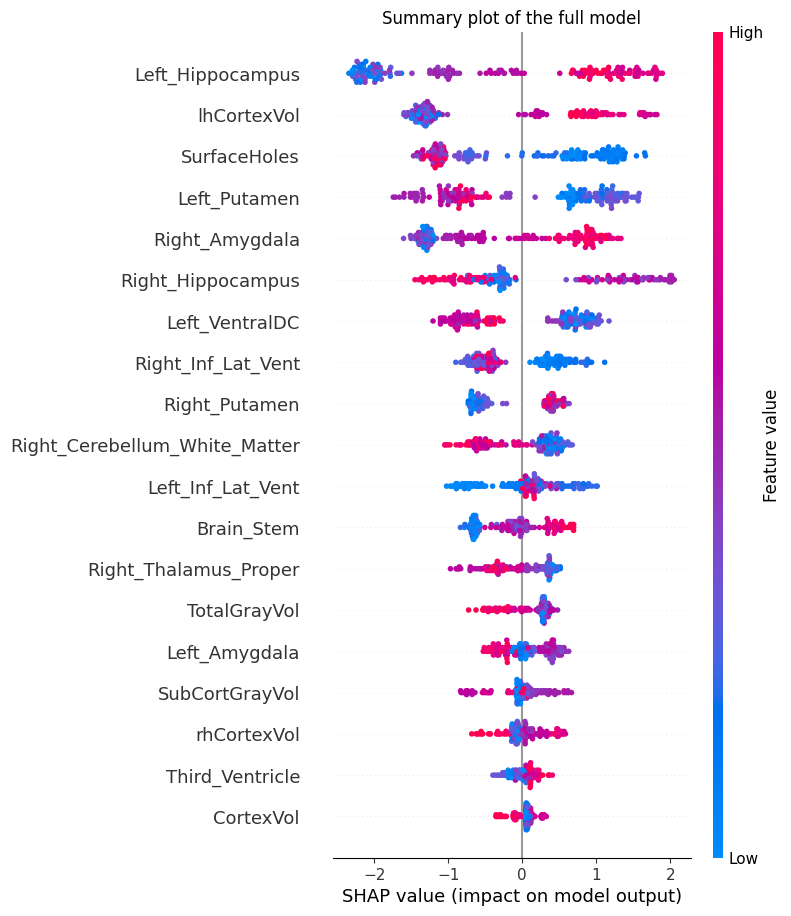

In [ ]:
shap.summary_plot(shap_values[1], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

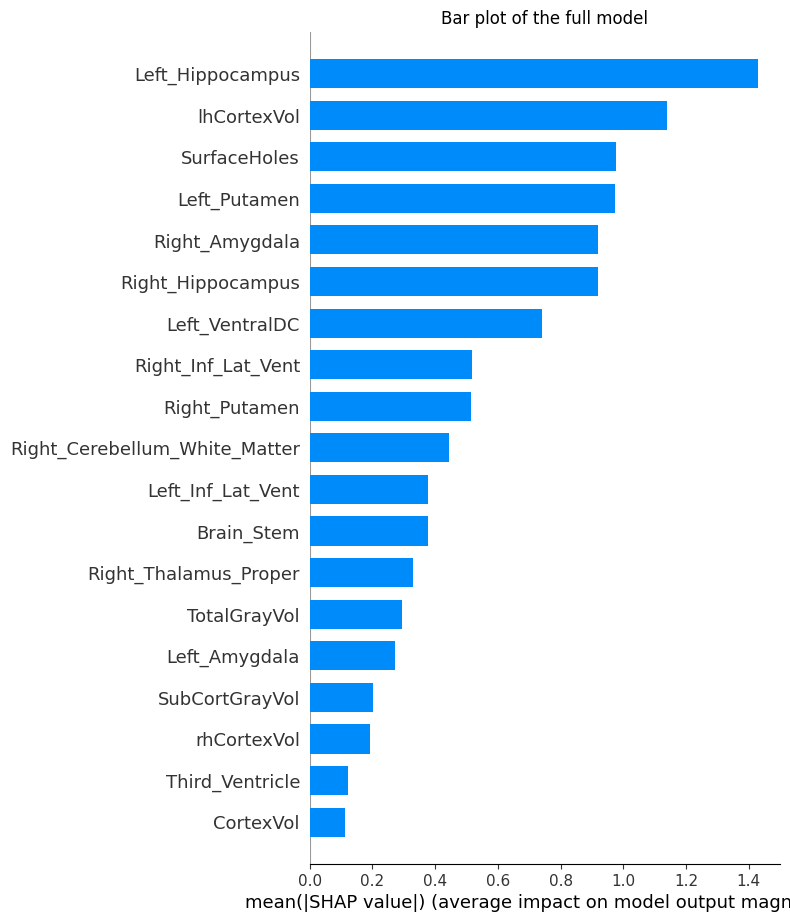

In [ ]:
shap.summary_plot(shap_values[1], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

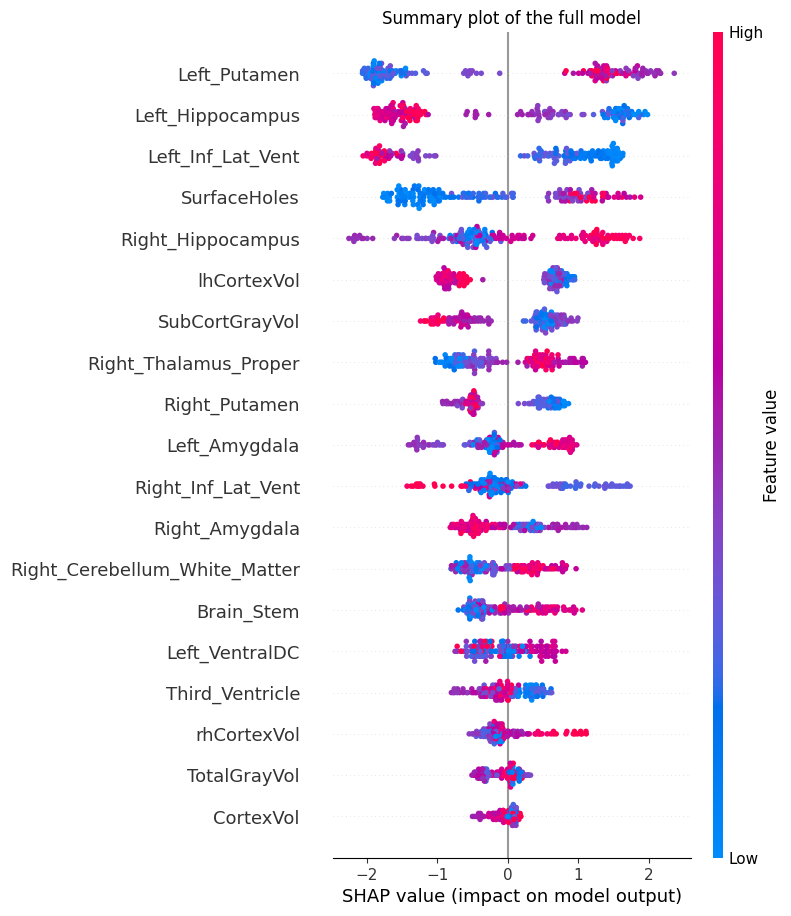

In [ ]:
shap.summary_plot(shap_values[2], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

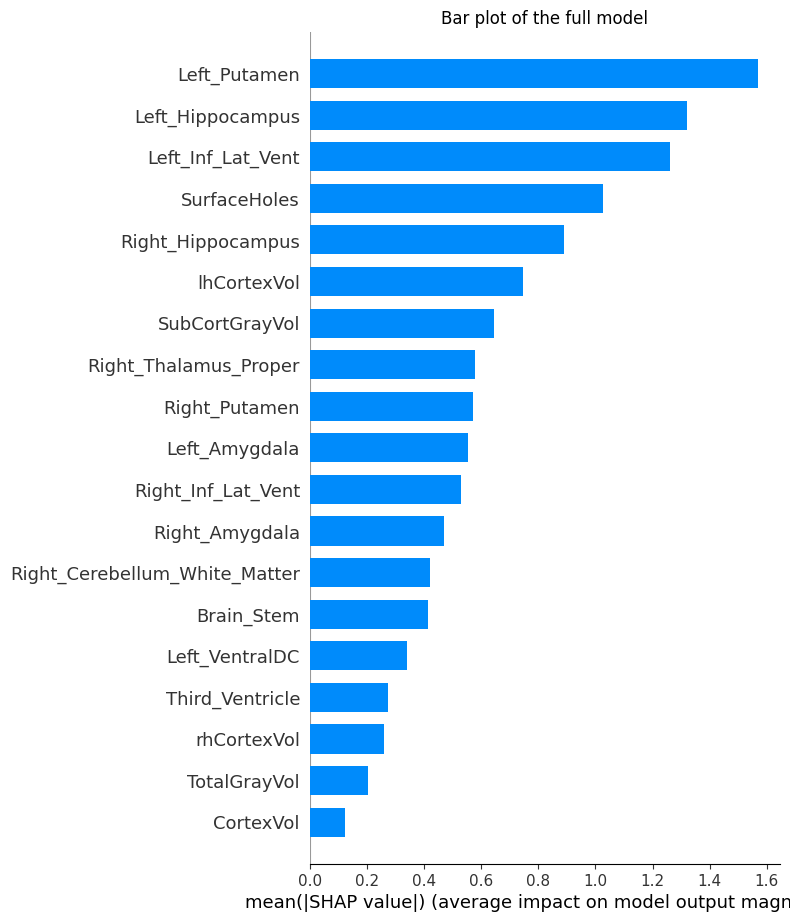

In [ ]:
shap.summary_plot(shap_values[2], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network Models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(256, input_dim = 19, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001))) # Rectified Linear Unit Activation Function
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001)))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001)))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001)))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001)))
    model.add(Dense(3, activation = 'softmax', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.0002)
    model.compile(loss = 'categorical_crossentropy', optimizer = optimizer, metrics = ['categorical_accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group"])["group"].count()

total = sum(y_distribution)

y_distribution

group
ad     41
cn     68
mci    65
Name: group, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution["ad"]/(total)),
                1: 1/(y_distribution["cn"]/(total)),
                2: 1/(y_distribution["mci"]/(total))}

model.fit(X_train, Y_train,
          batch_size=80,
          epochs=5500,
          callbacks=[callback],
          class_weight=class_weight,
          verbose=1,
          validation_data=(X_test, Y_test))


Epoch 1/5500
2/2 [==============================] - 2s 511ms/step - loss: 6.7638 - categorical_accuracy: 0.4132 - val_loss: 4.5925 - val_categorical_accuracy: 0.3019
Epoch 2/5500
2/2 [==============================] - 0s 72ms/step - loss: 6.7378 - categorical_accuracy: 0.4298 - val_loss: 4.5771 - val_categorical_accuracy: 0.3019
Epoch 3/5500
2/2 [==============================] - 0s 64ms/step - loss: 6.7143 - categorical_accuracy: 0.4215 - val_loss: 4.5620 - val_categorical_accuracy: 0.2830
Epoch 4/5500
2/2 [==============================] - 0s 51ms/step - loss: 6.6914 - categorical_accuracy: 0.4215 - val_loss: 4.5466 - val_categorical_accuracy: 0.2830
Epoch 5/5500
2/2 [==============================] - 0s 62ms/step - loss: 6.6672 - categorical_accuracy: 0.4215 - val_loss: 4.5305 - val_categorical_accuracy: 0.2830
Epoch 6/5500
2/2 [==============================] - 0s 68ms/step - loss: 6.6446 - categorical_accuracy: 0.4215 - val_loss: 4.5150 - val_categorical_accuracy: 0.3019
Epoch 7/5

In [ ]:
y_pred = model.predict(X_test)

2/2 [==============================] - 0s 5ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(np.argmax(Y_test, axis=1), y_pred = np.argmax(y_pred, axis = 1)))
print()
print("Classfication Report:")
print()
print(classification_report(np.argmax(Y_test, axis=1), y_pred = np.argmax(y_pred, axis = 1)))

Confusion Matrix:
[[11  0  3]
 [ 0 20  3]
 [ 1  7  8]]

Classfication Report:

              precision    recall  f1-score   support

           0       0.92      0.79      0.85        14
           1       0.74      0.87      0.80        23
           2       0.57      0.50      0.53        16

    accuracy                           0.74        53
   macro avg       0.74      0.72      0.73        53
weighted avg       0.74      0.74      0.73        53



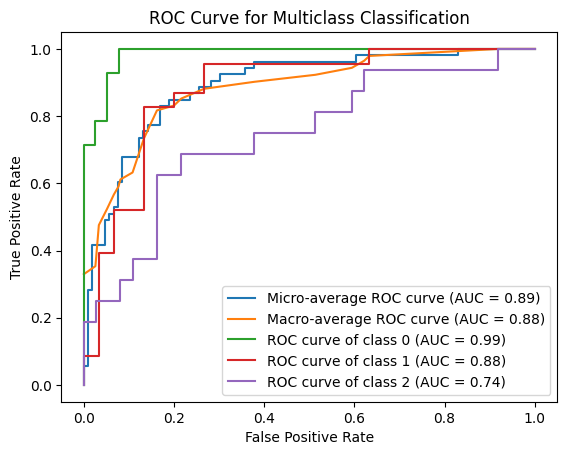

In [ ]:
from sklearn.preprocessing import label_binarize

n_classes= 3

# Binarize the true labels
y_true_binary = label_binarize(Y_test, classes=np.arange(n_classes))

# Compute ROC curve and ROC AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = metrics.roc_curve(y_true_binary[:, i], y_pred[:, i])
    roc_auc[i] = metrics.auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC AUC
fpr_micro, tpr_micro, _ = metrics.roc_curve(y_true_binary.ravel(), y_pred.ravel())
roc_auc_micro = metrics.auc(fpr_micro, tpr_micro)

# Compute macro-average ROC curve and ROC AUC
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr_macro = all_fpr
tpr_macro = mean_tpr
roc_auc_macro = metrics.auc(fpr_macro, tpr_macro)

# Plot micro-average ROC curve
plt.plot(fpr_micro, tpr_micro, label='Micro-average ROC curve (AUC = {:.2f})'.format(roc_auc_micro))

# Plot macro-average ROC curve
plt.plot(fpr_macro, tpr_macro, label='Macro-average ROC curve (AUC = {:.2f})'.format(roc_auc_macro))

# Plot ROC curve for each class
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label='ROC curve of class {} (AUC = {:.2f})'.format(i, roc_auc[i]))

# Add labels and legends
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Multiclass Classification')
plt.legend()
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 78ms/step


  0%|          | 0/174 [00:00<?, ?it/s]

652/652 [==============================] - 1s 1ms/step


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


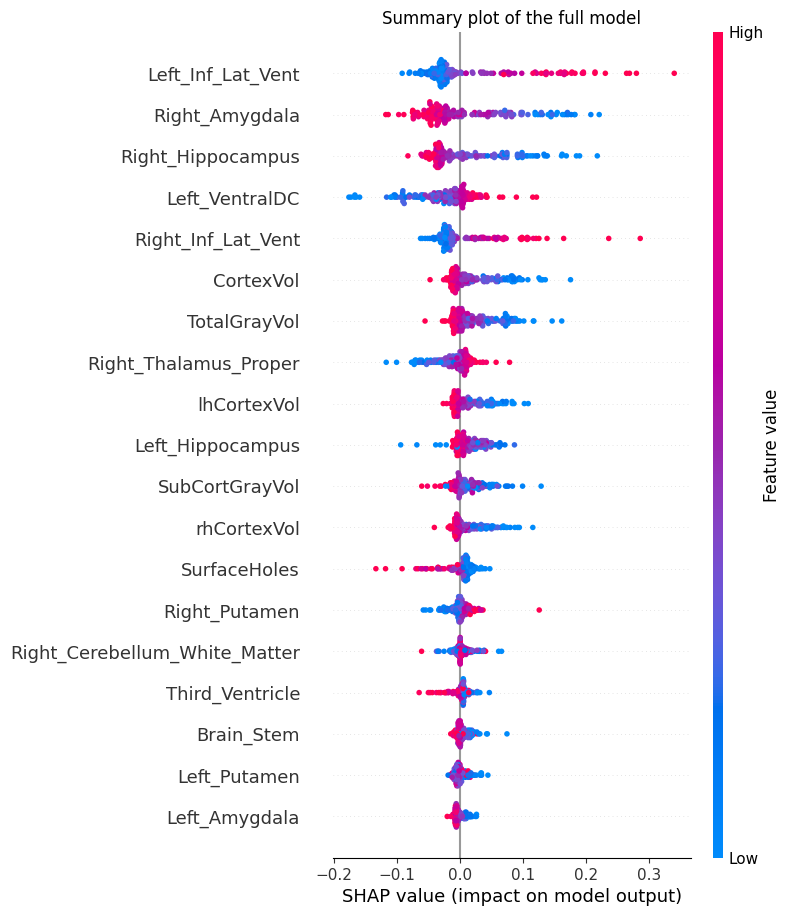

In [ ]:
shap.summary_plot(shap_values[0], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

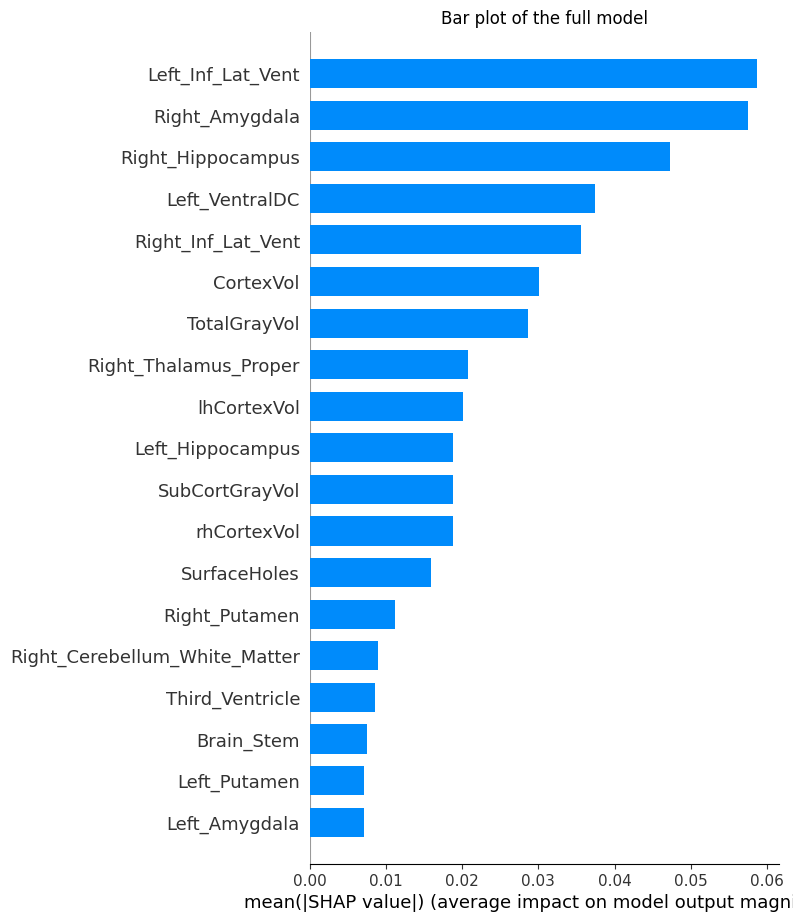

In [ ]:
shap.summary_plot(shap_values[0], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

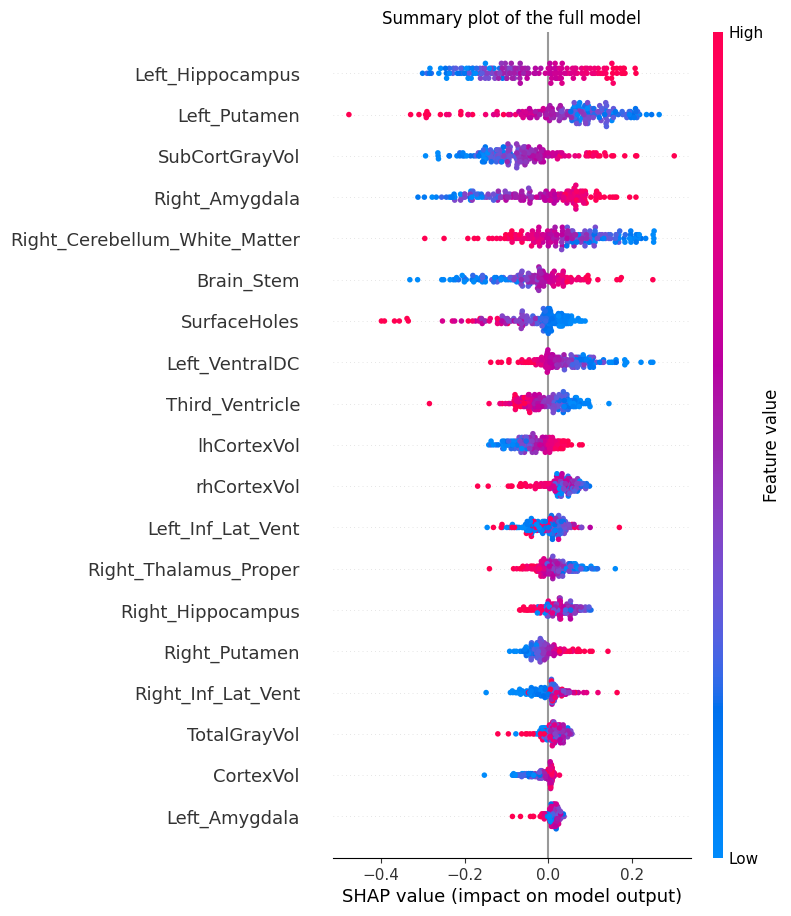

In [ ]:
shap.summary_plot(shap_values[1], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

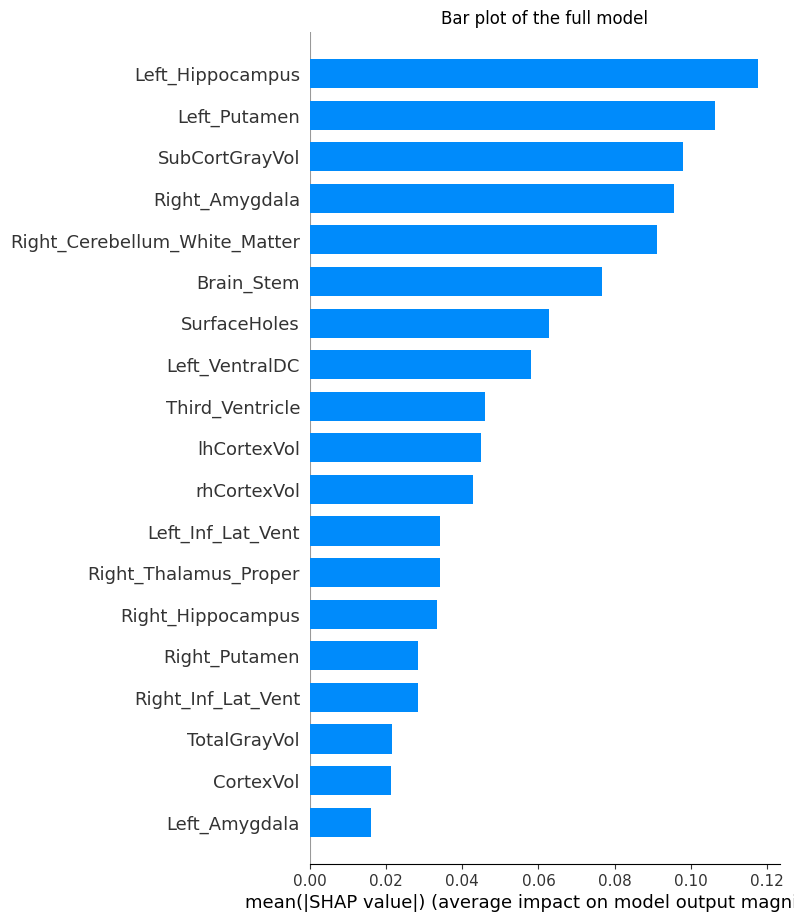

In [ ]:
shap.summary_plot(shap_values[1], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

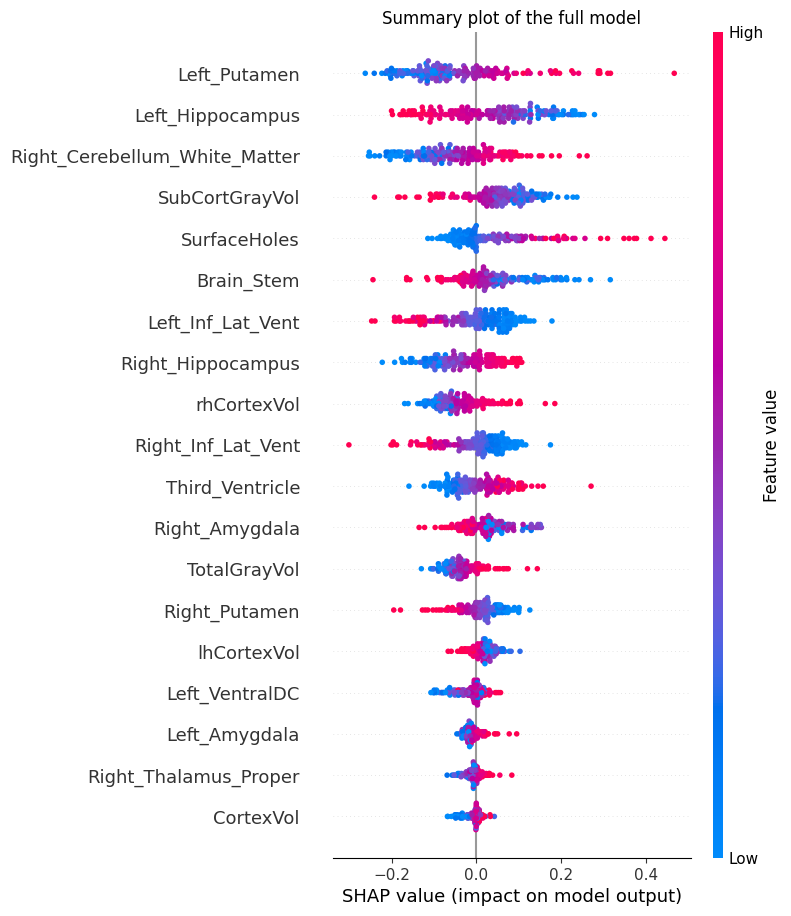

In [ ]:
shap.summary_plot(shap_values[2], X, show=False)
plt.title("Summary plot of the full model")
plt.show()

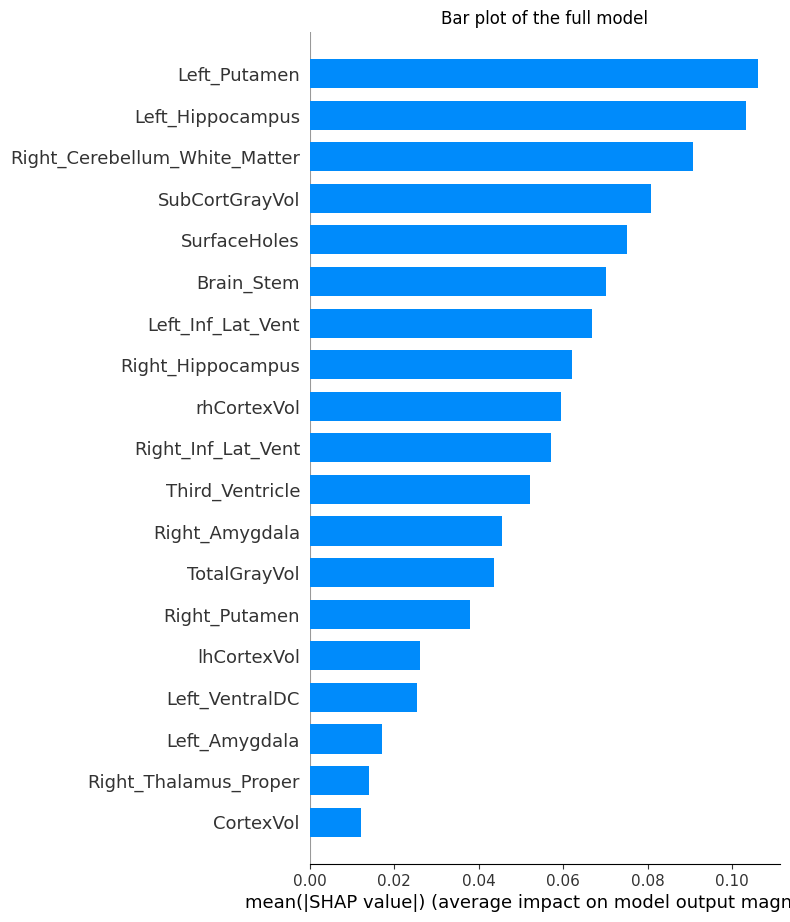

In [ ]:
shap.summary_plot(shap_values[2], X, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

##Classification CN-AD with Morphology Information

###Creation of the datasets

In [ ]:
x = recon_all_cn_ad.drop(["group", "group_int", "Subject", "Age", "Sex"], axis=1)
y = recon_all_cn_ad[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex"]
for i in recon_all_cn_ad.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(recon_all_cn_ad.columns)):
  if recon_all_cn_ad.columns[i] not in not_matrices:
    if importances[j] > 0.07:
      final_columns.append(recon_all_cn_ad.columns[i])
    j += 1

print(final_columns)

['Left_Lateral_Ventricle', 'Left_Inf_Lat_Vent', 'Third_Ventricle', 'Left_Hippocampus', 'Left_Amygdala', 'Left_VentralDC', 'Right_Lateral_Ventricle', 'Right_Inf_Lat_Vent', 'Right_Thalamus_Proper', 'Right_Putamen', 'Right_Pallidum', 'Right_Hippocampus', 'Right_Amygdala', 'lhCortexVol', 'rhCortexVol', 'CortexVol', 'SubCortGrayVol', 'TotalGrayVol', 'BrainSegVol_to_eTIV', 'SurfaceHoles']


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


In [ ]:
# dataset cn vs ad
x = recon_all_cn_ad[final_columns]
y = recon_all_cn_ad[["group_int"]]

x_train, x_test = train_test_split(x, test_size=0.3, random_state=42)
y_train, y_test = train_test_split(y, test_size=0.3, random_state=42)

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

X = X.values
Y = y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

In [ ]:
# dataset mci vs mci-ad
X_matrices_2 = recon_all_mci_mciad[final_columns]
Y_matrices_2 = recon_all_mci_mciad[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X_2 = scaler.fit_transform(X_matrices_2)
X_2 = pd.DataFrame(X_2)

X_2 = X_2.values
Y_2 = Y_matrices_2.values

In [ ]:
# dataset cn vs cn-ad
X_matrices_3 = recon_all_cn_cnad_cnmci[final_columns]
Y_matrices_3 = recon_all_cn_cnad_cnmci[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X_3 = scaler.fit_transform(X_matrices_3)
X_3 = pd.DataFrame(X_3)

X_3 = X_3.values
Y_3 = Y_matrices_3.values

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)
y_pred_2=xgboost_reg.predict(X_2)
y_pred_3=xgboost_reg.predict(X_3)

####Random Forest Results

In [ ]:
# Confusion Matrix CN-AD
print("Confusion Matrix CN-AD:")
print(confusion_matrix(y_test, y_pred))
print()
print("Classfication Report CN-AD:")
print()
print(classification_report(y_test, y_pred))

Confusion Matrix CN-AD:
[[19  1]
 [ 2 11]]

Classfication Report CN-AD:

              precision    recall  f1-score   support

         0.0       0.90      0.95      0.93        20
         1.0       0.92      0.85      0.88        13

    accuracy                           0.91        33
   macro avg       0.91      0.90      0.90        33
weighted avg       0.91      0.91      0.91        33



In [ ]:
# Confusion Matrix MCI-MCI-AD
print("Confusion Matrix MCI-MCI-AD:")
print(confusion_matrix(Y_2, y_pred_2))
print()
print("Classfication Report MCI-MCI-AD:")
print()
print(classification_report(Y_2, y_pred_2))

Confusion Matrix MCI-MCI-AD:
[[41 24]
 [ 6 16]]

Classfication Report MCI-MCI-AD:

              precision    recall  f1-score   support

         0.0       0.87      0.63      0.73        65
         1.0       0.40      0.73      0.52        22

    accuracy                           0.66        87
   macro avg       0.64      0.68      0.62        87
weighted avg       0.75      0.66      0.68        87



In [ ]:
# Confusion Matrix CN-CN-AD
print("Confusion Matrix CN-CN-AD:")
print(confusion_matrix(Y_3, y_pred_3))
print()
print("Classfication Report CN-CN-AD:")
print()
print(classification_report(Y_3, y_pred_3))

Confusion Matrix CN-CN-AD:
[[47 21]
 [ 9  7]]

Classfication Report CN-CN-AD:

              precision    recall  f1-score   support

         0.0       0.84      0.69      0.76        68
         1.0       0.25      0.44      0.32        16

    accuracy                           0.64        84
   macro avg       0.54      0.56      0.54        84
weighted avg       0.73      0.64      0.67        84



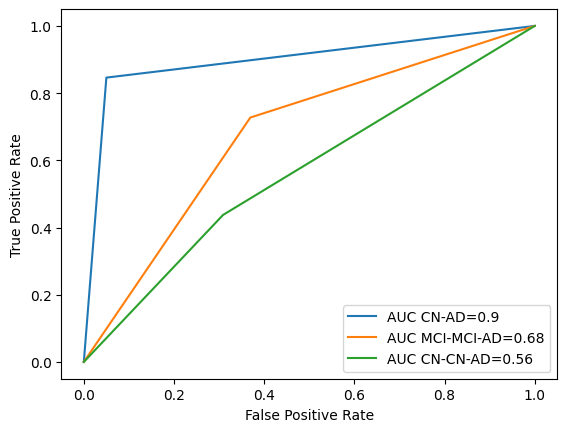

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

fpr_2, tpr_2, _ = metrics.roc_curve(Y_2,  y_pred_2)
auc_2 = metrics.roc_auc_score(Y_2, y_pred_2)

fpr_3, tpr_3, _ = metrics.roc_curve(Y_3,  y_pred_3)
auc_3 = metrics.roc_auc_score(Y_3, y_pred_3)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.plot(fpr_2,tpr_2,label="AUC MCI-MCI-AD="+str(round(auc_2, 2)))
plt.plot(fpr_3,tpr_3,label="AUC CN-CN-AD="+str(round(auc_3, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer=shap.Explainer(xgboost_reg)
shap_values_data=explainer(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


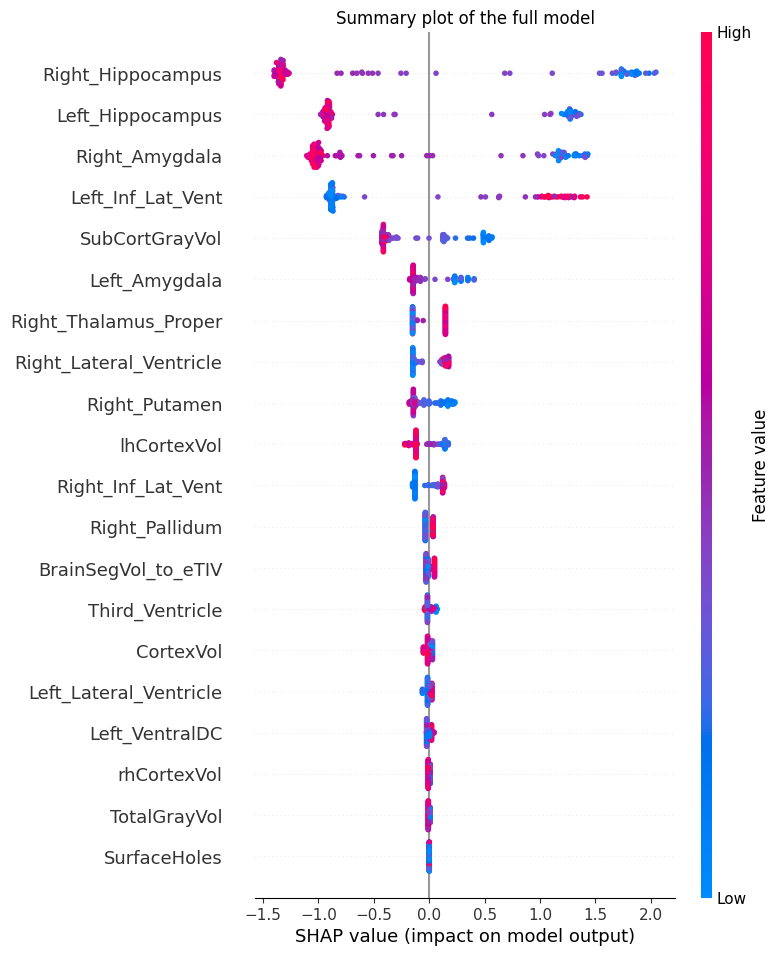

In [ ]:
shap.summary_plot(shap_values_data, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

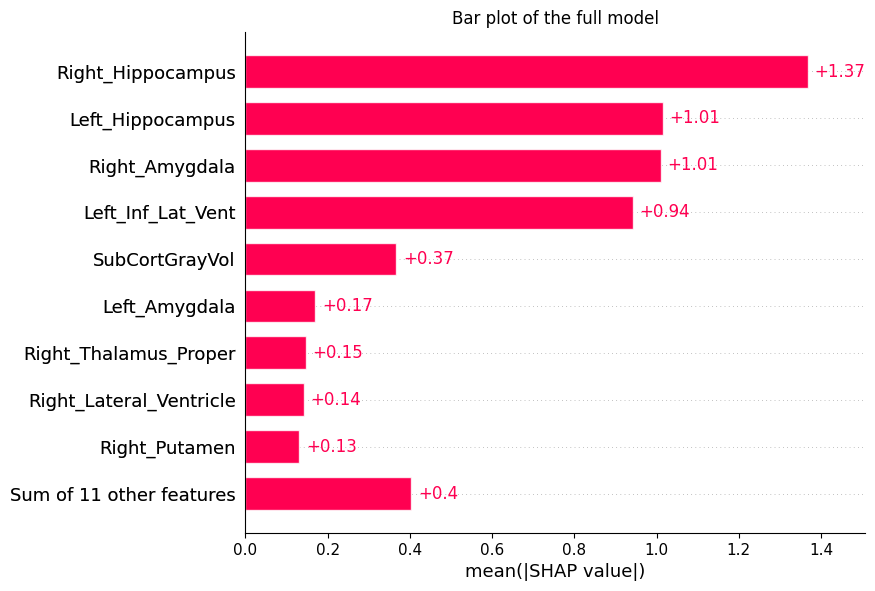

In [ ]:
shap.plots.bar(shap_values_data, show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network Models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(256, input_dim = 20, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001))) # Rectified Linear Unit Activation Function
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(4, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(2, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(1, activation = 'sigmoid', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.00007)
    model.compile(loss = 'binary_crossentropy', optimizer = optimizer, metrics = ['accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group_int"])["group_int"].count()

total = sum(y_distribution)

y_distribution

group_int
0.0    68
1.0    41
Name: group_int, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution[0]/(total)),
                1: 1/(y_distribution[1]/(total))}

model.fit(X_train, Y_train,
          batch_size=80,
          epochs=5000,
          verbose=1,
          callbacks=[callback],
          #class_weight=class_weight,
          validation_data=(X_test, Y_test))


Epoch 1/5000
1/1 [==============================] - 3s 3s/step - loss: 1.0480 - accuracy: 0.6316 - val_loss: 1.0476 - val_accuracy: 0.6061
Epoch 2/5000
1/1 [==============================] - 0s 71ms/step - loss: 1.0475 - accuracy: 0.6316 - val_loss: 1.0472 - val_accuracy: 0.6061
Epoch 3/5000
1/1 [==============================] - 0s 69ms/step - loss: 1.0470 - accuracy: 0.6316 - val_loss: 1.0467 - val_accuracy: 0.6061
Epoch 4/5000
1/1 [==============================] - 0s 73ms/step - loss: 1.0465 - accuracy: 0.6316 - val_loss: 1.0463 - val_accuracy: 0.6061
Epoch 5/5000
1/1 [==============================] - 0s 74ms/step - loss: 1.0461 - accuracy: 0.6316 - val_loss: 1.0459 - val_accuracy: 0.6061
Epoch 6/5000
1/1 [==============================] - 0s 70ms/step - loss: 1.0456 - accuracy: 0.6316 - val_loss: 1.0455 - val_accuracy: 0.6061
Epoch 7/5000
1/1 [==============================] - 0s 80ms/step - loss: 1.0451 - accuracy: 0.6316 - val_loss: 1.0450 - val_accuracy: 0.6061
Epoch 8/5000
1/

In [ ]:
y_pred = model.predict(X_test)
y_pred_2 = model.predict(X_2)
y_pred_3 = model.predict(X_3)

3/3 [==============================] - 0s 3ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix CN-AD:")
print(confusion_matrix(Y_test, np.round(y_pred)))
print()
print("Classfication Report CN-AD:")
print()
print(classification_report(Y_test, np.round(y_pred)))

Confusion Matrix CN-AD:
[[19  1]
 [ 2 11]]

Classfication Report CN-AD:

              precision    recall  f1-score   support

         0.0       0.90      0.95      0.93        20
         1.0       0.92      0.85      0.88        13

    accuracy                           0.91        33
   macro avg       0.91      0.90      0.90        33
weighted avg       0.91      0.91      0.91        33



In [ ]:
print("Confusion Matrix MCI-MCI-AD:")
print(confusion_matrix(Y_2, np.round(y_pred_2)))
print()
print("Classfication Report MCI-MCI-AD:")
print()
print(classification_report(Y_2, np.round(y_pred_2)))

Confusion Matrix MCI-MCI-AD:
[[41 24]
 [ 4 18]]

Classfication Report MCI-MCI-AD:

              precision    recall  f1-score   support

         0.0       0.91      0.63      0.75        65
         1.0       0.43      0.82      0.56        22

    accuracy                           0.68        87
   macro avg       0.67      0.72      0.65        87
weighted avg       0.79      0.68      0.70        87



In [ ]:
print("Confusion Matrix CN-CN-AD:")
print(confusion_matrix(Y_3, np.round(y_pred_3)))
print()
print("Classfication Report CN-CN-AD:")
print()
print(classification_report(Y_3, np.round(y_pred_3)))

Confusion Matrix CN-CN-AD:
[[53 15]
 [ 9  7]]

Classfication Report CN-CN-AD:

              precision    recall  f1-score   support

         0.0       0.85      0.78      0.82        68
         1.0       0.32      0.44      0.37        16

    accuracy                           0.71        84
   macro avg       0.59      0.61      0.59        84
weighted avg       0.75      0.71      0.73        84



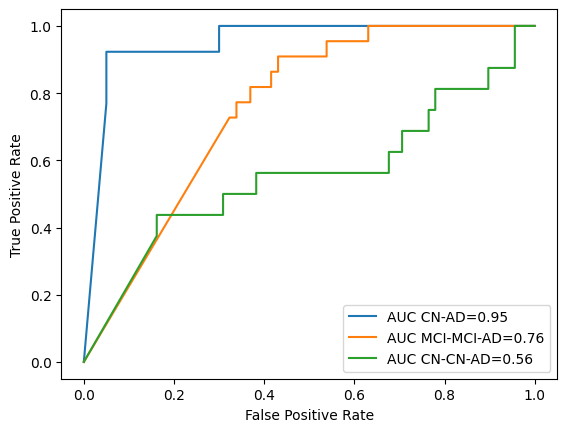

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

fpr_2, tpr_2, _ = metrics.roc_curve(Y_2,  y_pred_2)
auc_2 = metrics.roc_auc_score(Y_2, y_pred_2)

fpr_3, tpr_3, _ = metrics.roc_curve(Y_3,  y_pred_3)
auc_3 = metrics.roc_auc_score(Y_3, y_pred_3)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.plot(fpr_2,tpr_2,label="AUC MCI-MCI-AD="+str(round(auc_2, 2)))
plt.plot(fpr_3,tpr_3,label="AUC CN-CN-AD="+str(round(auc_3, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

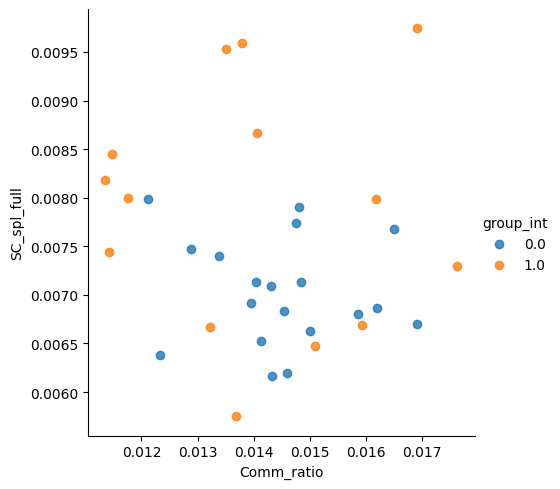

In [ ]:
result = pd.concat([x_test, y_test], axis=1)

sns.lmplot(x="Comm_ratio", y="SC_spl_full", data=result, hue='group_int', fit_reg=False)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 37ms/step


  0%|          | 0/109 [00:00<?, ?it/s]

653/653 [==============================] - 1s 2ms/step


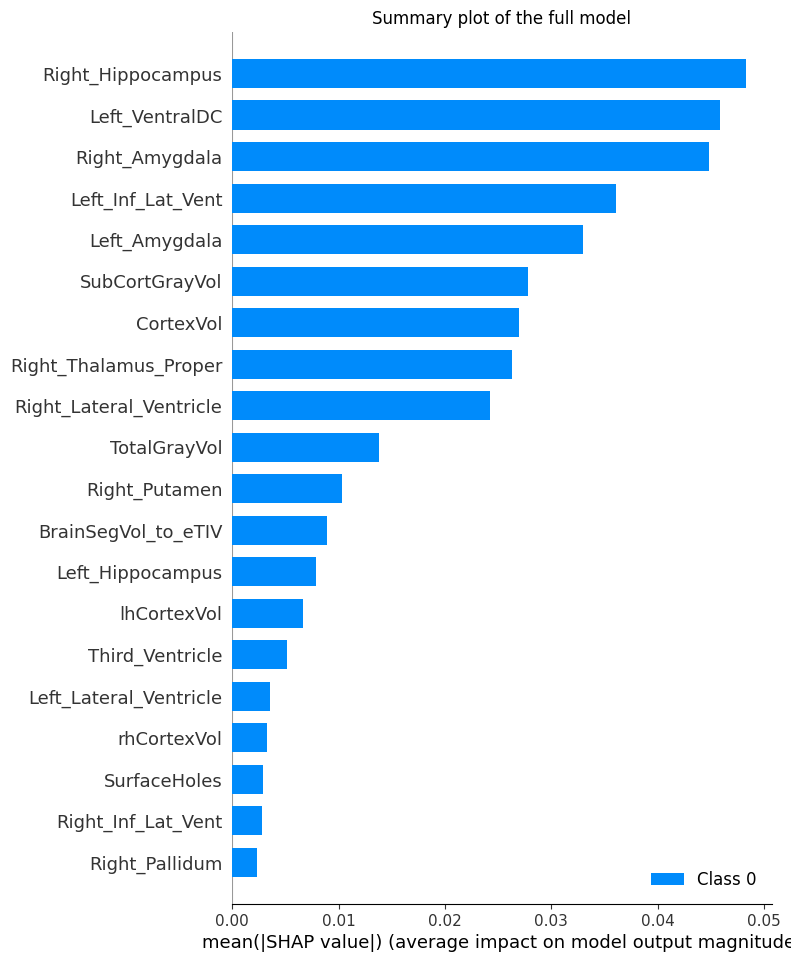

In [ ]:
shap.summary_plot(shap_values, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

##Classification with CN CN-MCI with Morphology Information


###Creation of datasets

In [ ]:
x = recon_all_cn_cnad_cnmci.drop(["group", "group_int", "Subject", "Age", "Sex"], axis=1)
y = recon_all_cn_cnad_cnmci[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex"]
for i in recon_all_cn_cnad_cnmci.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(recon_all_cn_cnad_cnmci.columns)):
  if recon_all_cn_cnad_cnmci.columns[i] not in not_matrices:
    if importances[j] > 0.03:
      final_columns.append(recon_all_cn_cnad_cnmci.columns[i])
    j += 1

print(final_columns)

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


['Left_Pallidum', 'Fourth_Ventricle', 'CSF', 'Left_Accumbens_area', 'Left_vessel', 'Right_Cerebellum_White_Matter', 'Right_Putamen', 'Right_Pallidum', 'Right_VentralDC', 'non_WM_hypointensities', 'CortexVol', 'SubCortGrayVol', 'MaskVol_to_eTIV', 'lhSurfaceHoles', 'SurfaceHoles']


In [ ]:
x = recon_all_cn_cnad_cnmci[final_columns]
y = recon_all_cn_cnad_cnmci[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

X = X.values
Y = y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)

####Random Forest Results

In [ ]:
# Confusion Matrix CN-CN-MCI-CN-AD
print("Confusion Matrix:")
print(confusion_matrix(Y_test, y_pred))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, y_pred))

Confusion Matrix:
[[20  1]
 [ 3  2]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.87      0.95      0.91        21
         1.0       0.67      0.40      0.50         5

    accuracy                           0.85        26
   macro avg       0.77      0.68      0.70        26
weighted avg       0.83      0.85      0.83        26



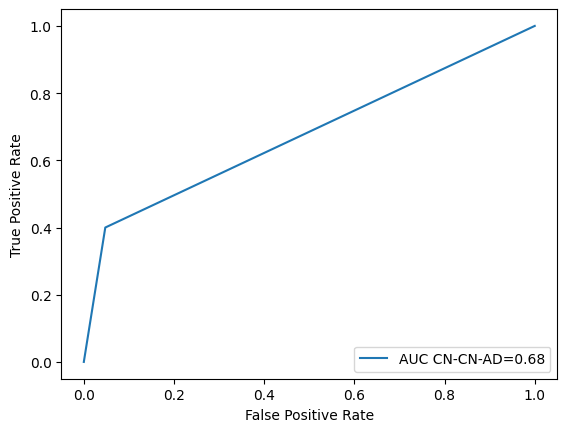

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-CN-AD="+str(round(auc, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer=shap.Explainer(xgboost_reg)
shap_values_data=explainer(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


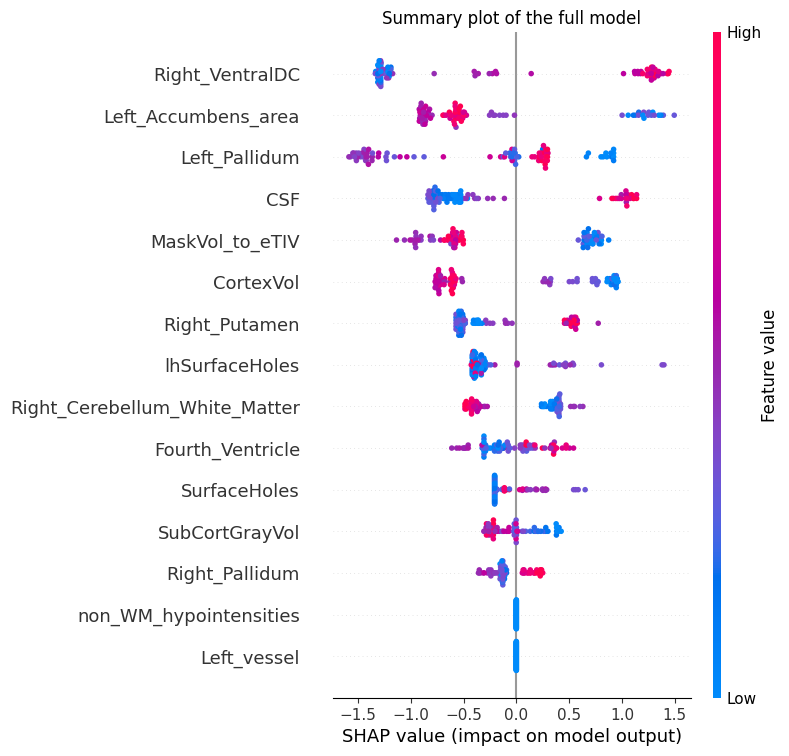

In [ ]:
shap.summary_plot(shap_values_data, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

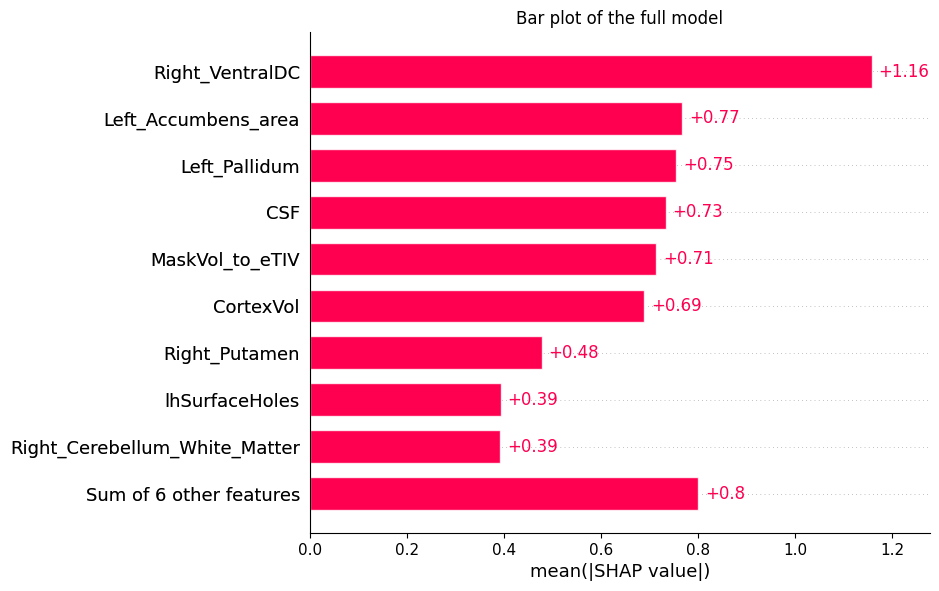

In [ ]:
shap.plots.bar(shap_values_data, show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(256, input_dim = 13, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006))) # Rectified Linear Unit Activation Function
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(4, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(2, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(1, activation = 'sigmoid', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.00008)
    model.compile(loss = 'binary_crossentropy', optimizer = optimizer, metrics = ['accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group_int"])["group_int"].count()

total = sum(y_distribution)

y_distribution

group_int
0.0    68
1.0    16
Name: group_int, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution[0]/(total)),
                1: 1/(y_distribution[1]/(total))}

model.fit(X_train, Y_train,
          batch_size=40,
          epochs=5000,
          verbose=1,
          callbacks=[callback],
          class_weight=class_weight,
          validation_data=(X_test, Y_test))


Epoch 1/5000
2/2 [==============================] - 3s 551ms/step - loss: 3.4374 - accuracy: 0.8103 - val_loss: 2.7427 - val_accuracy: 0.8077
Epoch 2/5000
2/2 [==============================] - 0s 66ms/step - loss: 3.4329 - accuracy: 0.8103 - val_loss: 2.7383 - val_accuracy: 0.8077
Epoch 3/5000
2/2 [==============================] - 0s 65ms/step - loss: 3.4284 - accuracy: 0.6379 - val_loss: 2.7338 - val_accuracy: 0.1923
Epoch 4/5000
2/2 [==============================] - 0s 71ms/step - loss: 3.4239 - accuracy: 0.1897 - val_loss: 2.7293 - val_accuracy: 0.1923
Epoch 5/5000
2/2 [==============================] - 0s 55ms/step - loss: 3.4194 - accuracy: 0.1897 - val_loss: 2.7248 - val_accuracy: 0.1923
Epoch 6/5000
2/2 [==============================] - 0s 94ms/step - loss: 3.4149 - accuracy: 0.1897 - val_loss: 2.7203 - val_accuracy: 0.1923
Epoch 7/5000
2/2 [==============================] - 0s 67ms/step - loss: 3.4104 - accuracy: 0.1897 - val_loss: 2.7159 - val_accuracy: 0.1923
Epoch 8/5000

In [ ]:
y_prediction = model.predict(X_test)

1/1 [==============================] - 0s 161ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(Y_test, np.round(y_prediction)))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, np.round(y_prediction)))

Confusion Matrix:
[[20  1]
 [ 5  0]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.80      0.95      0.87        21
         1.0       0.00      0.00      0.00         5

    accuracy                           0.77        26
   macro avg       0.40      0.48      0.43        26
weighted avg       0.65      0.77      0.70        26



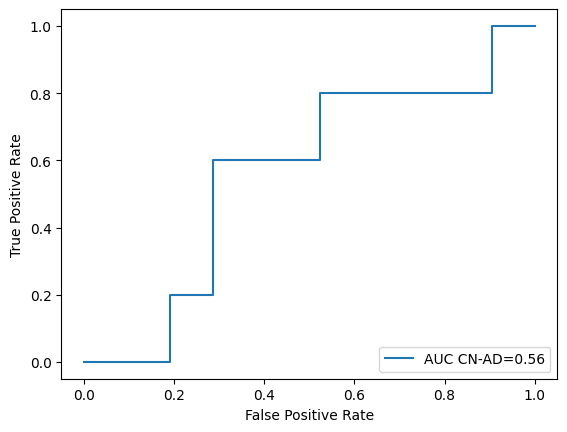

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_prediction)
auc = metrics.roc_auc_score(Y_test, y_prediction)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 34ms/step


  0%|          | 0/84 [00:00<?, ?it/s]

648/648 [==============================] - 1s 2ms/step


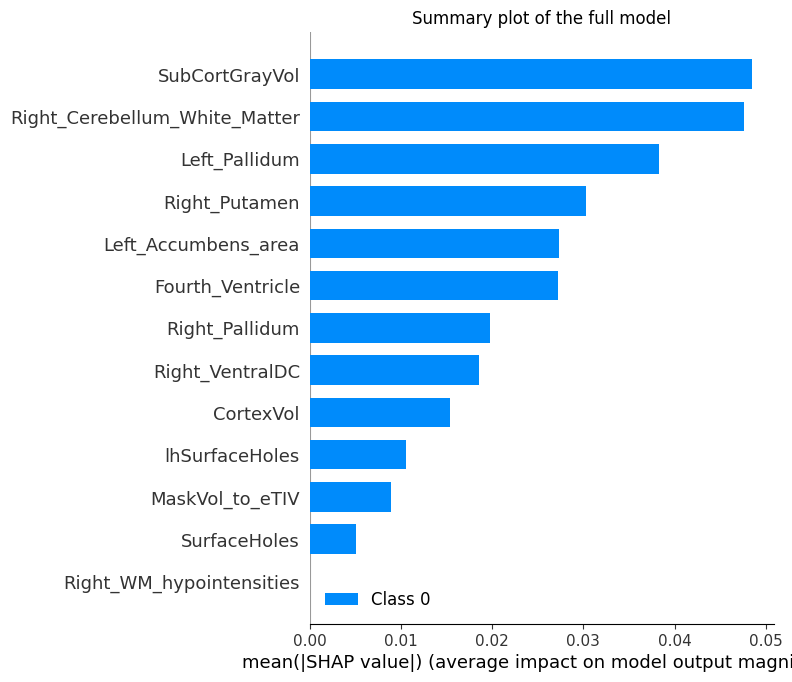

In [ ]:
shap.summary_plot(shap_values, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

##Classification with MCI MCI-AD with Morphology Information


###Creation of datasets

In [ ]:
x = recon_all_mci_mciad.drop(["group", "group_int", "Subject", "Age", "Sex"], axis=1)
y = recon_all_mci_mciad[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex"]
for i in recon_all_mci_mciad.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(recon_all_mci_mciad.columns)):
  if recon_all_mci_mciad.columns[i] not in not_matrices:
    if importances[j] > 0.06:
      final_columns.append(recon_all_mci_mciad.columns[i])
    j += 1

print(final_columns)

['Left_Putamen', 'Fourth_Ventricle', 'Brain_Stem', 'Left_Hippocampus', 'Left_Amygdala', 'Right_Pallidum', 'Right_Hippocampus', 'Right_Amygdala', 'WM_hypointensities', 'Left_non_WM_hypointensities', 'Right_non_WM_hypointensities', 'lhCortexVol', 'rhCortexVol', 'CortexVol', 'rhCerebralWhiteMatterVol', 'TotalGrayVol', 'SupraTentorialVol', 'MaskVol', 'lhSurfaceHoles', 'rhSurfaceHoles', 'SurfaceHoles']


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


In [ ]:
x = recon_all_mci_mciad[final_columns]
y = recon_all_mci_mciad[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

X = X.values
Y = y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)

####Random Forest Results

In [ ]:
# Confusion Matrix CN-CN-MCI-CN-AD
print("Confusion Matrix:")
print(confusion_matrix(Y_test, y_pred))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, y_pred))

Confusion Matrix:
[[15  2]
 [ 8  2]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.65      0.88      0.75        17
         1.0       0.50      0.20      0.29        10

    accuracy                           0.63        27
   macro avg       0.58      0.54      0.52        27
weighted avg       0.60      0.63      0.58        27



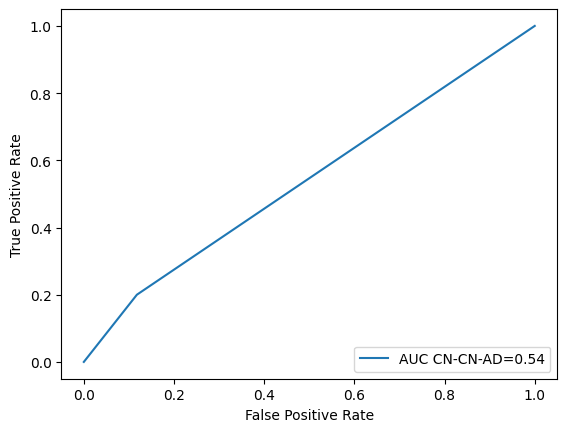

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-CN-AD="+str(round(auc, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer=shap.Explainer(xgboost_reg)
shap_values_data=explainer(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


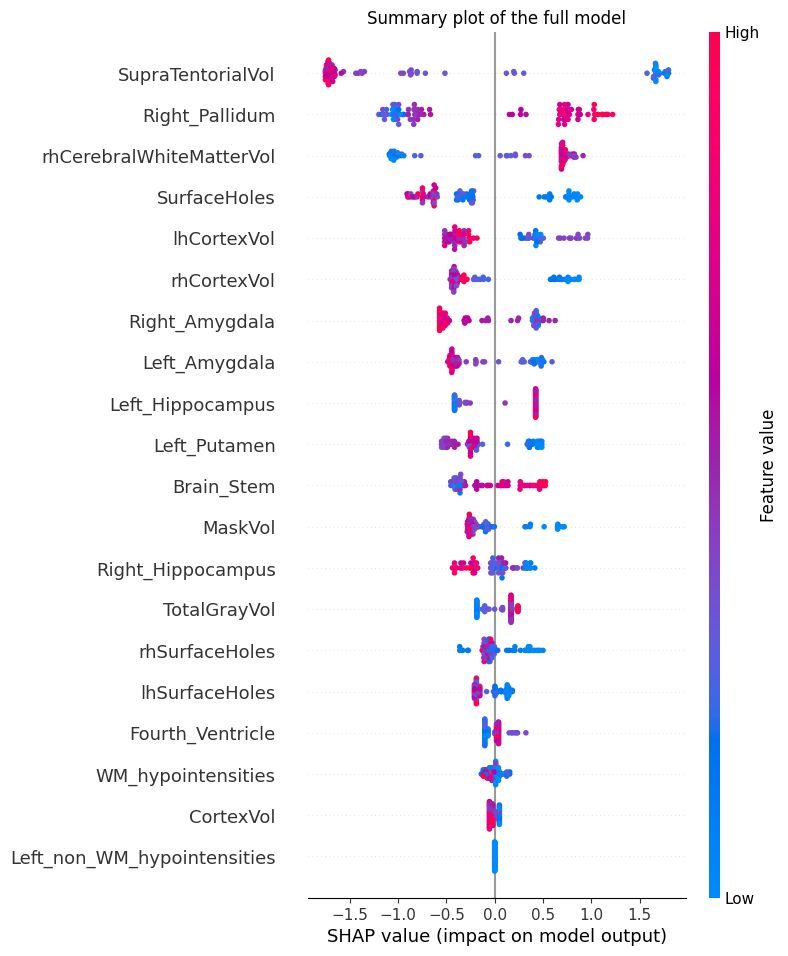

In [ ]:
shap.summary_plot(shap_values_data, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

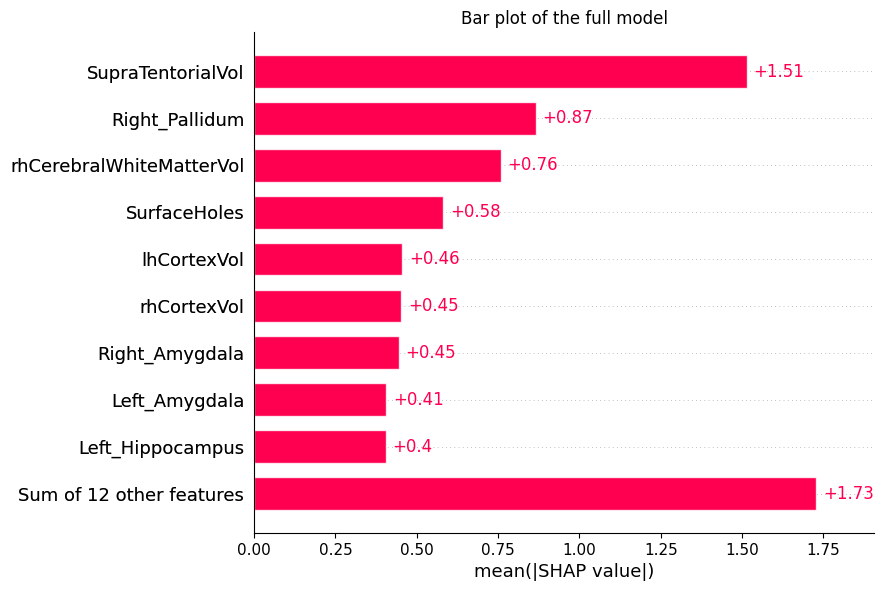

In [ ]:
shap.plots.bar(shap_values_data, show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(256, input_dim = 20, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0005),activity_regularizer=keras.regularizers.L2(0.0005))) # Rectified Linear Unit Activation Function
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0005),activity_regularizer=keras.regularizers.L2(0.0005)))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0005),activity_regularizer=keras.regularizers.L2(0.0005)))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0005),activity_regularizer=keras.regularizers.L2(0.0005)))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0005),activity_regularizer=keras.regularizers.L2(0.0005)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0005),activity_regularizer=keras.regularizers.L2(0.0005)))
    model.add(Dense(4, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0005),activity_regularizer=keras.regularizers.L2(0.0005)))
    model.add(Dense(2, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0005),activity_regularizer=keras.regularizers.L2(0.0005)))
    model.add(Dense(1, activation = 'sigmoid', kernel_regularizer=keras.regularizers.L1(0.0005),activity_regularizer=keras.regularizers.L2(0.0005))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.0004)
    model.compile(loss = 'binary_crossentropy', optimizer = optimizer, metrics = ['accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group_int"])["group_int"].count()

total = sum(y_distribution)

y_distribution

group_int
0.0    65
1.0    22
Name: group_int, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution[0]/(total)),
                1: 1/(y_distribution[1]/(total))}

model.fit(X_train, Y_train,
          batch_size=40,
          epochs=5000,
          verbose=1,
          callbacks=[callback],
          class_weight=class_weight,
          validation_data=(X_test, Y_test))


Epoch 1/5000
2/2 [==============================] - 3s 551ms/step - loss: 3.0574 - accuracy: 0.8000 - val_loss: 2.4489 - val_accuracy: 0.6296
Epoch 2/5000
2/2 [==============================] - 0s 75ms/step - loss: 3.0158 - accuracy: 0.8000 - val_loss: 2.4288 - val_accuracy: 0.6296
Epoch 3/5000
2/2 [==============================] - 0s 52ms/step - loss: 2.9831 - accuracy: 0.8000 - val_loss: 2.4106 - val_accuracy: 0.6296
Epoch 4/5000
2/2 [==============================] - 0s 69ms/step - loss: 2.9544 - accuracy: 0.8000 - val_loss: 2.3930 - val_accuracy: 0.6296
Epoch 5/5000
2/2 [==============================] - 0s 53ms/step - loss: 2.9302 - accuracy: 0.8000 - val_loss: 2.3761 - val_accuracy: 0.6296
Epoch 6/5000
2/2 [==============================] - 0s 71ms/step - loss: 2.9020 - accuracy: 0.8000 - val_loss: 2.3605 - val_accuracy: 0.6296
Epoch 7/5000
2/2 [==============================] - 0s 69ms/step - loss: 2.8740 - accuracy: 0.8000 - val_loss: 2.3439 - val_accuracy: 0.6296
Epoch 8/5000

In [ ]:
y_prediction = model.predict(X_test)

1/1 [==============================] - 0s 163ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(Y_test, np.round(y_prediction)))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, np.round(y_prediction)))

Confusion Matrix:
[[17  0]
 [ 5  5]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.77      1.00      0.87        17
         1.0       1.00      0.50      0.67        10

    accuracy                           0.81        27
   macro avg       0.89      0.75      0.77        27
weighted avg       0.86      0.81      0.80        27



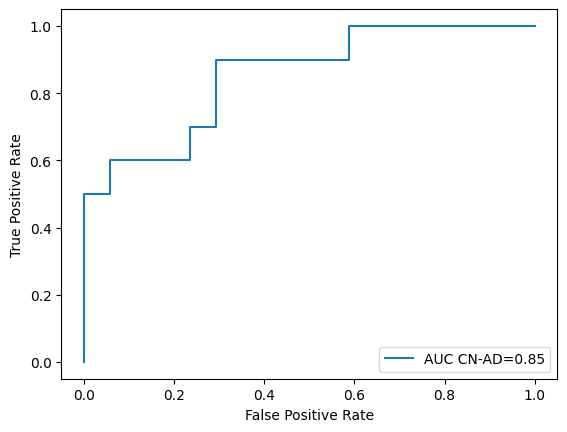

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_prediction)
auc = metrics.roc_auc_score(Y_test, y_prediction)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 31ms/step


  0%|          | 0/87 [00:00<?, ?it/s]

652/652 [==============================] - 1s 2ms/step


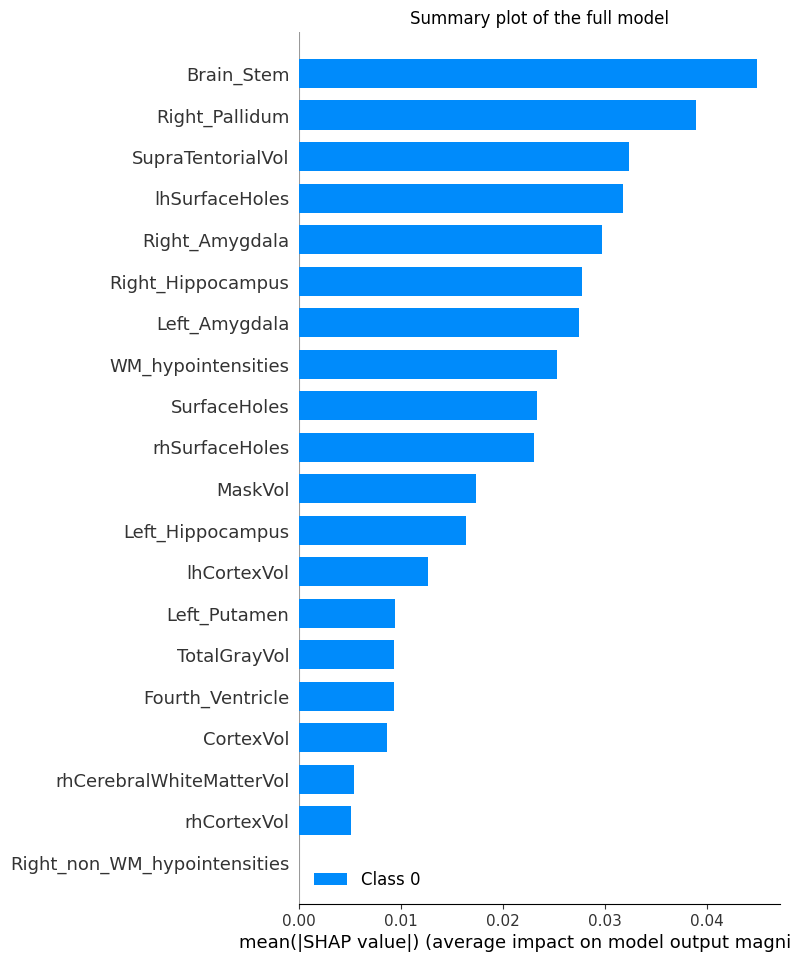

In [ ]:
shap.summary_plot(shap_values, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

#Classification with all

##Classifier CN-MCI-AD with all

###Creation of the datasets

In [ ]:
x = matrices_cn_mci_ad_all.drop(["group", "group_int", "Subject", "Age", "Sex", "Centre"], axis=1)
y = matrices_cn_mci_ad_all[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex", "Centre"]
for i in matrices_cn_mci_ad_all.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(matrices_cn_mci_ad_all.columns)):
  if matrices_cn_mci_ad_all.columns[i] not in not_matrices:
    if importances[j] > 0.06:
      final_columns.append(matrices_cn_mci_ad_all.columns[i])
    j += 1

print(final_columns)

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


['Left_Lateral_Ventricle', 'Left_Inf_Lat_Vent', 'Left_Putamen', 'Third_Ventricle', 'Brain_Stem', 'Left_Hippocampus', 'Left_Amygdala', 'Left_Accumbens_area', 'Right_Lateral_Ventricle', 'Right_Inf_Lat_Vent', 'Right_Cerebellum_White_Matter', 'Right_Thalamus_Proper', 'Right_Putamen', 'Right_Pallidum', 'Right_Hippocampus', 'Right_Amygdala', 'WM_hypointensities', 'Right_non_WM_hypointensities', 'lhCortexVol', 'rhCortexVol', 'CortexVol', 'SubCortGrayVol', 'TotalGrayVol', 'SupraTentorialVolNotVent', 'SurfaceHoles', 'Comm_ratio', 'SC_L_avg_spl', 'SC_L_avg_eff', 'SC_R_avg_spl', 'SC_R_avg_eff', 'SC_avg_eff', 'CC_ratio', 'SC_spl_full', 'SC_eff_full', 'Full_CC']


In [ ]:
#x = matrices_cn_mci_ad_all.drop(["group", "group_int", "Subject", "Age", "Sex", "Centre"], axis=1)
x = matrices_cn_mci_ad_all[final_columns]
y = matrices_cn_mci_ad_all[["group"]]

x_train, x_test = train_test_split(x, test_size=0.3, random_state=20)
y_train, y_test = train_test_split(y, test_size=0.3, random_state=20)

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

Y = pd.get_dummies(y)

X = X.values
Y = Y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X_2 = pd.DataFrame(X)
X_2.columns = x.columns

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)

####Random Forest Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(np.argmax(Y_test, axis = 1), np.argmax(y_pred, axis = 1)))
print()
print("Classfication Report:")
print()
print(classification_report(np.argmax(Y_test, axis = 1), np.argmax(y_pred, axis = 1)))

Confusion Matrix:
[[ 8  0  4]
 [ 3 12  4]
 [ 6  7  5]]

Classfication Report:

              precision    recall  f1-score   support

           0       0.47      0.67      0.55        12
           1       0.63      0.63      0.63        19
           2       0.38      0.28      0.32        18

    accuracy                           0.51        49
   macro avg       0.50      0.53      0.50        49
weighted avg       0.50      0.51      0.50        49



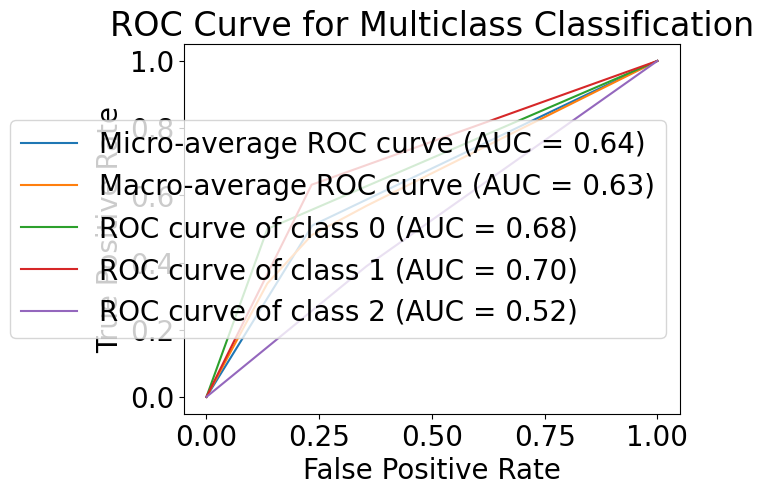

In [ ]:
from sklearn.preprocessing import label_binarize

n_classes= 3

# Binarize the true labels
y_true_binary = label_binarize(Y_test, classes=np.arange(n_classes))

# Compute ROC curve and ROC AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = metrics.roc_curve(y_true_binary[:, i], y_pred[:, i])
    roc_auc[i] = metrics.auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC AUC
fpr_micro, tpr_micro, _ = metrics.roc_curve(y_true_binary.ravel(), y_pred.ravel())
roc_auc_micro = metrics.auc(fpr_micro, tpr_micro)

# Compute macro-average ROC curve and ROC AUC
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr_macro = all_fpr
tpr_macro = mean_tpr
roc_auc_macro = metrics.auc(fpr_macro, tpr_macro)

# Plot micro-average ROC curve
plt.plot(fpr_micro, tpr_micro, label='Micro-average ROC curve (AUC = {:.2f})'.format(roc_auc_micro))

# Plot macro-average ROC curve
plt.plot(fpr_macro, tpr_macro, label='Macro-average ROC curve (AUC = {:.2f})'.format(roc_auc_macro))

# Plot ROC curve for each class
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label='ROC curve of class {} (AUC = {:.2f})'.format(i, roc_auc[i]))

# Add labels and legends
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Multiclass Classification')
plt.legend()
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.Explainer(xgboost_reg)
shap_values = explainer.shap_values(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


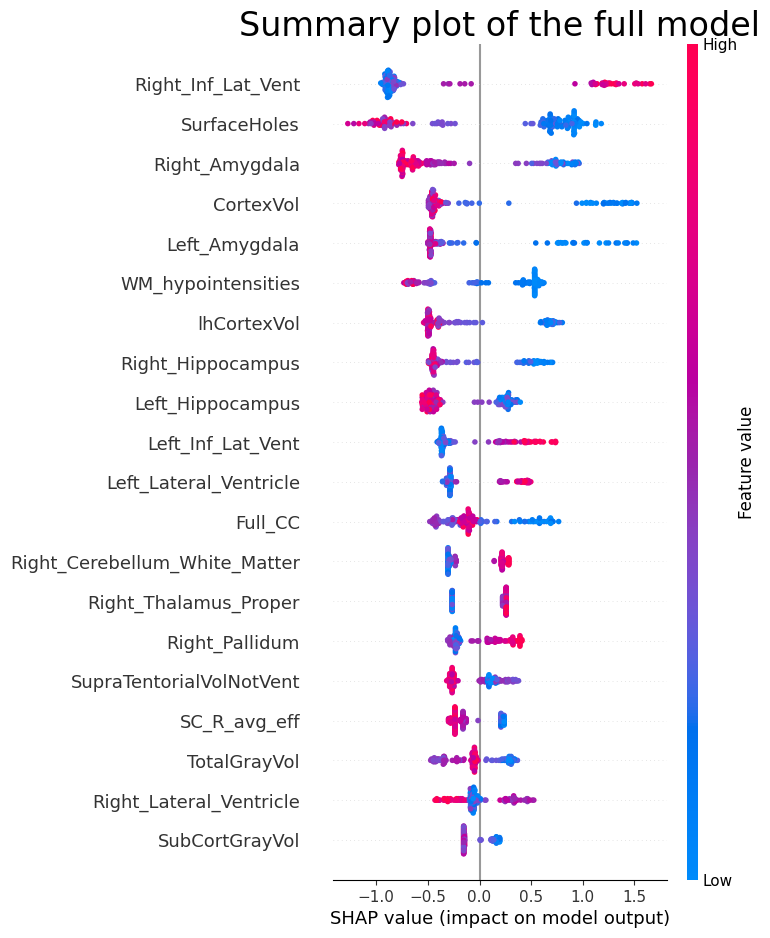

In [ ]:
shap.summary_plot(shap_values[0], X_2, show=False)
plt.title("Summary plot of the full model")
plt.show()

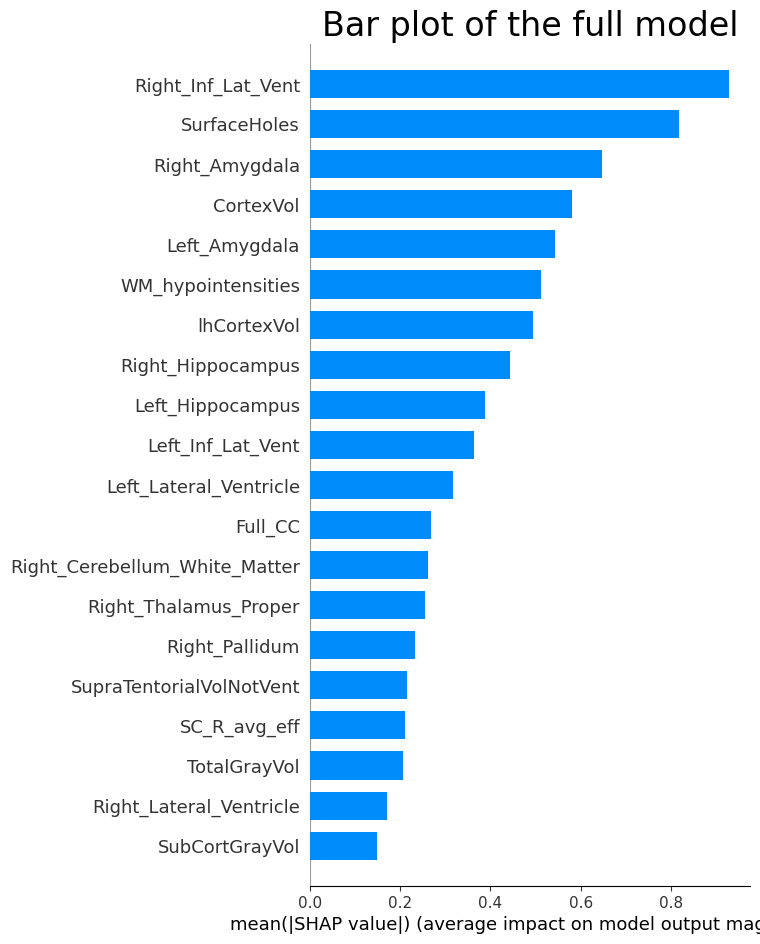

In [ ]:
shap.summary_plot(shap_values[0], X_2, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


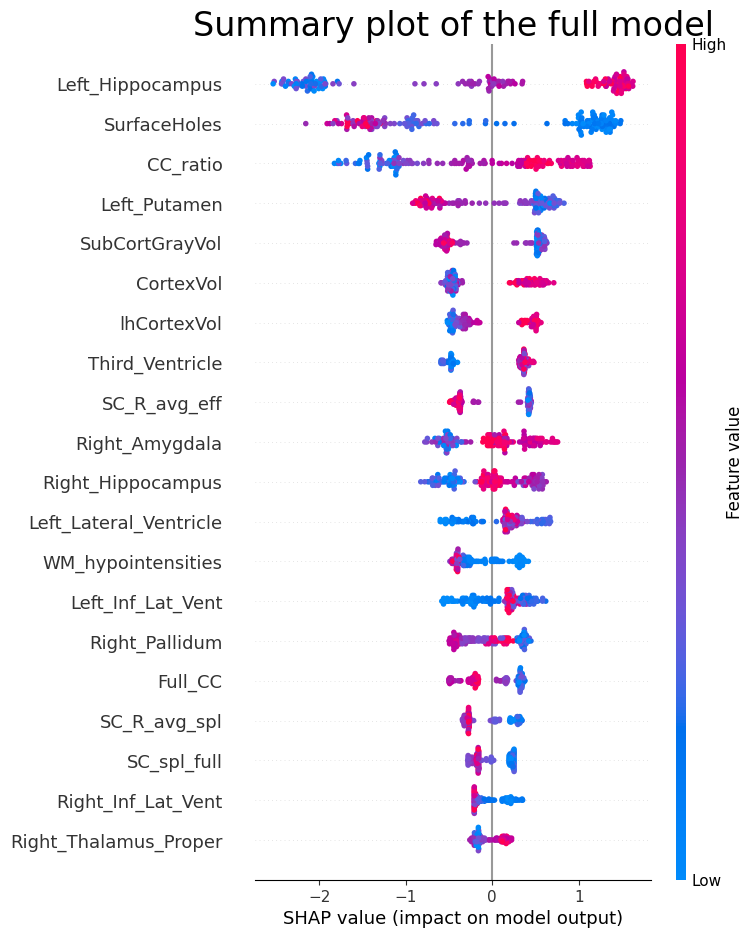

In [ ]:
shap.summary_plot(shap_values[1], X_2, show=False)
plt.title("Summary plot of the full model")
plt.show()

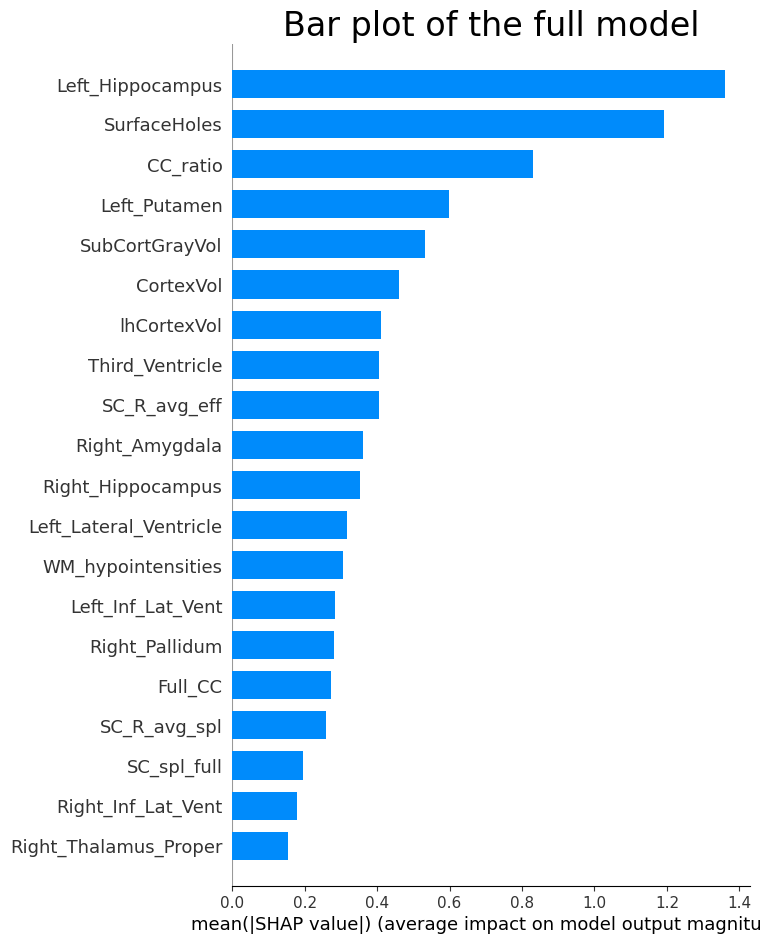

In [ ]:
shap.summary_plot(shap_values[1], X_2, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


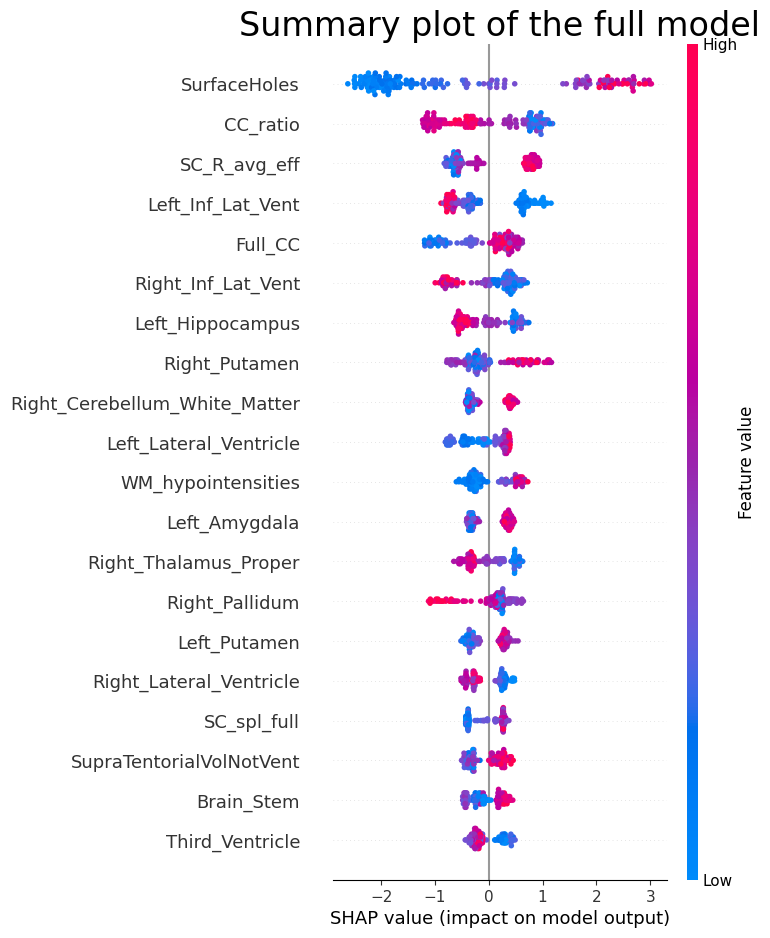

In [ ]:
shap.summary_plot(shap_values[2], X_2, show=False)
plt.title("Summary plot of the full model")
plt.show()

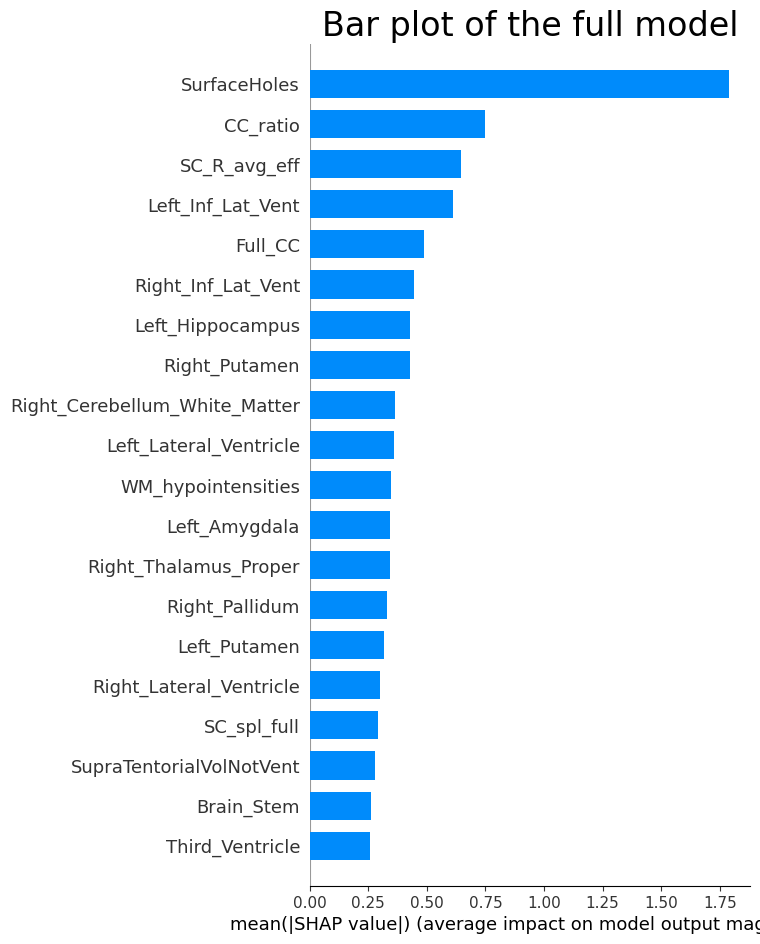

In [ ]:
shap.summary_plot(shap_values[2], X_2, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network Models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(256, input_dim = 26, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001))) # Rectified Linear Unit Activation Function
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001)))
    model.add(Dropout(0.1))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001)))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001)))
    model.add(Dropout(0.1))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001)))
    model.add(Dropout(0.1))
    model.add(Dense(3, activation = 'softmax', kernel_regularizer=keras.regularizers.L1(0.001),activity_regularizer=keras.regularizers.L2(0.001))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.0002)
    model.compile(loss = 'categorical_crossentropy', optimizer = optimizer, metrics = ['categorical_accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group"])["group"].count()

total = sum(y_distribution)

y_distribution

group
ad     41
cn     68
mci    65
Name: group, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=100, restore_best_weights=True)

class_weight = {0: 1/(y_distribution["ad"]/(total)),
                1: 1/(y_distribution["cn"]/(total)),
                2: 1/(y_distribution["mci"]/(total))}

model.fit(X_train, Y_train,
          batch_size=80,
          epochs=5500,
          callbacks=[callback],
          class_weight=class_weight,
          verbose=1,
          validation_data=(X_test, Y_test))


Epoch 1/5500
2/2 [==============================] - 5s 1s/step - loss: 6.9312 - categorical_accuracy: 0.2231 - val_loss: 4.7245 - val_categorical_accuracy: 0.2453
Epoch 2/5500
2/2 [==============================] - 0s 265ms/step - loss: 6.9082 - categorical_accuracy: 0.2562 - val_loss: 4.7071 - val_categorical_accuracy: 0.3396
Epoch 3/5500
2/2 [==============================] - 0s 163ms/step - loss: 6.8807 - categorical_accuracy: 0.3058 - val_loss: 4.6901 - val_categorical_accuracy: 0.4717
Epoch 4/5500
2/2 [==============================] - 0s 104ms/step - loss: 6.8616 - categorical_accuracy: 0.3719 - val_loss: 4.6741 - val_categorical_accuracy: 0.5472
Epoch 5/5500
2/2 [==============================] - 0s 126ms/step - loss: 6.8404 - categorical_accuracy: 0.4215 - val_loss: 4.6591 - val_categorical_accuracy: 0.5283
Epoch 6/5500
2/2 [==============================] - 0s 170ms/step - loss: 6.8167 - categorical_accuracy: 0.5041 - val_loss: 4.6445 - val_categorical_accuracy: 0.5283
Epoch 7

In [ ]:
y_pred = model.predict(X_test)

2/2 [==============================] - 0s 7ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(np.argmax(Y_test, axis=1), y_pred = np.argmax(y_pred, axis = 1)))
print()
print("Classfication Report:")
print()
print(classification_report(np.argmax(Y_test, axis=1), y_pred = np.argmax(y_pred, axis = 1)))

Confusion Matrix:
[[12  0  2]
 [ 1 19  3]
 [ 0  6 10]]

Classfication Report:

              precision    recall  f1-score   support

           0       0.92      0.86      0.89        14
           1       0.76      0.83      0.79        23
           2       0.67      0.62      0.65        16

    accuracy                           0.77        53
   macro avg       0.78      0.77      0.78        53
weighted avg       0.77      0.77      0.77        53



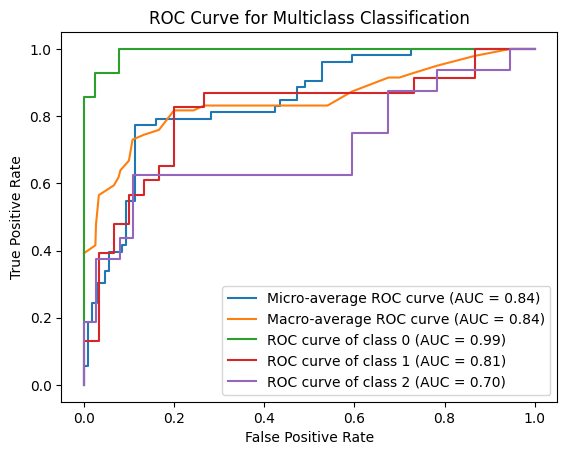

In [ ]:
from sklearn.preprocessing import label_binarize

n_classes= 3

# Binarize the true labels
y_true_binary = label_binarize(Y_test, classes=np.arange(n_classes))

# Compute ROC curve and ROC AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = metrics.roc_curve(y_true_binary[:, i], y_pred[:, i])
    roc_auc[i] = metrics.auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC AUC
fpr_micro, tpr_micro, _ = metrics.roc_curve(y_true_binary.ravel(), y_pred.ravel())
roc_auc_micro = metrics.auc(fpr_micro, tpr_micro)

# Compute macro-average ROC curve and ROC AUC
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr_macro = all_fpr
tpr_macro = mean_tpr
roc_auc_macro = metrics.auc(fpr_macro, tpr_macro)

# Plot micro-average ROC curve
plt.plot(fpr_micro, tpr_micro, label='Micro-average ROC curve (AUC = {:.2f})'.format(roc_auc_micro))

# Plot macro-average ROC curve
plt.plot(fpr_macro, tpr_macro, label='Macro-average ROC curve (AUC = {:.2f})'.format(roc_auc_macro))

# Plot ROC curve for each class
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label='ROC curve of class {} (AUC = {:.2f})'.format(i, roc_auc[i]))

# Add labels and legends
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Multiclass Classification')
plt.legend()
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 89ms/step


  0%|          | 0/174 [00:00<?, ?it/s]

656/656 [==============================] - 1s 2ms/step


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


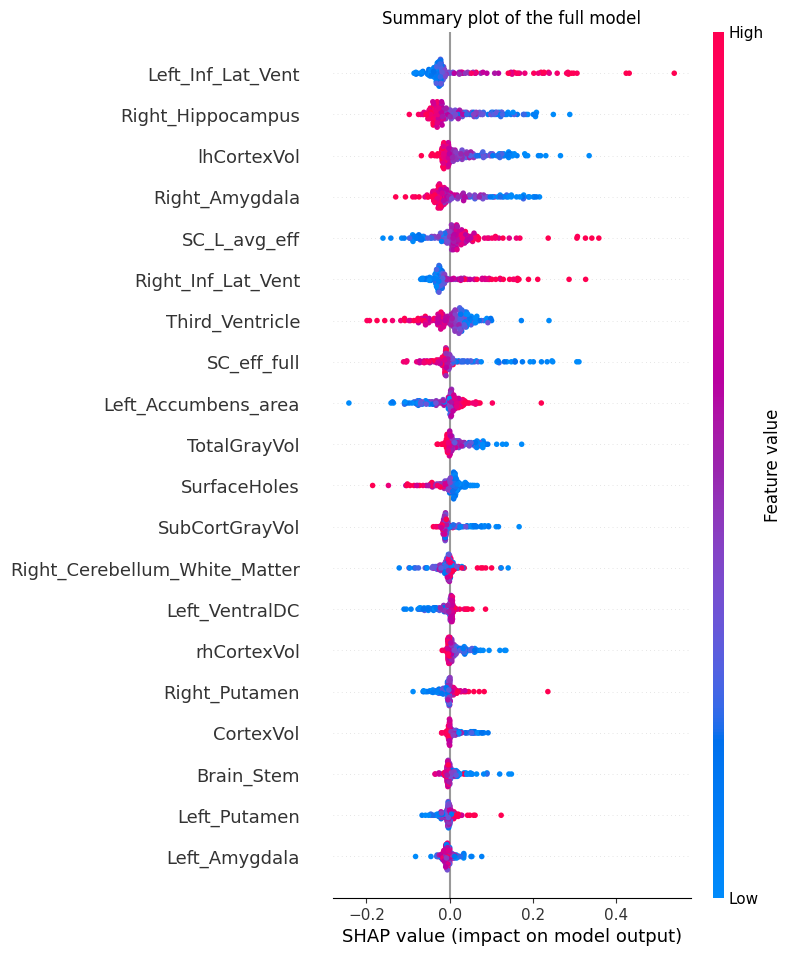

In [ ]:
shap.summary_plot(shap_values[0], X_2, show=False)
plt.title("Summary plot of the full model")
plt.show()

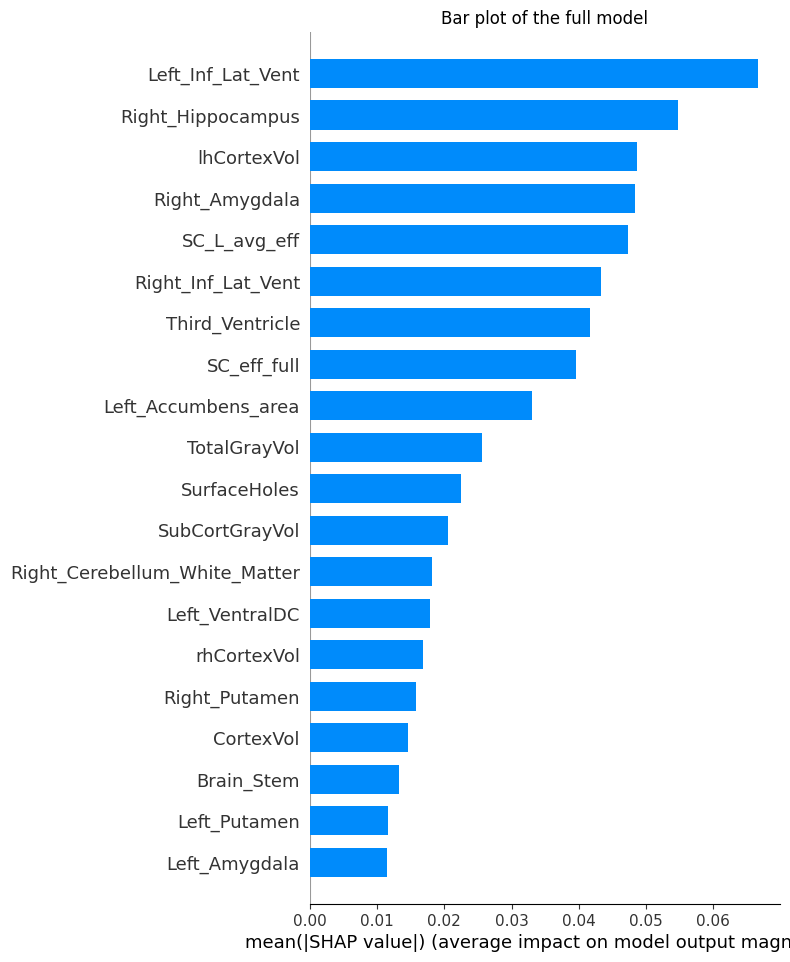

In [ ]:
shap.summary_plot(shap_values[0], X_2, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

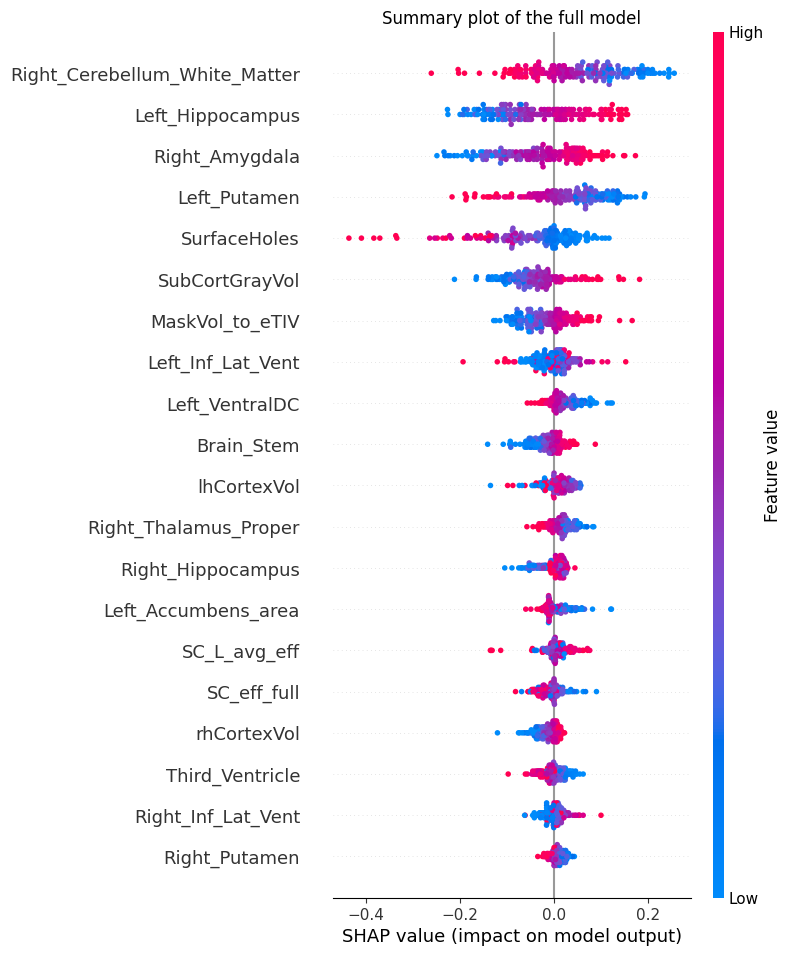

In [ ]:
shap.summary_plot(shap_values[1], X_2, show=False)
plt.title("Summary plot of the full model")
plt.show()

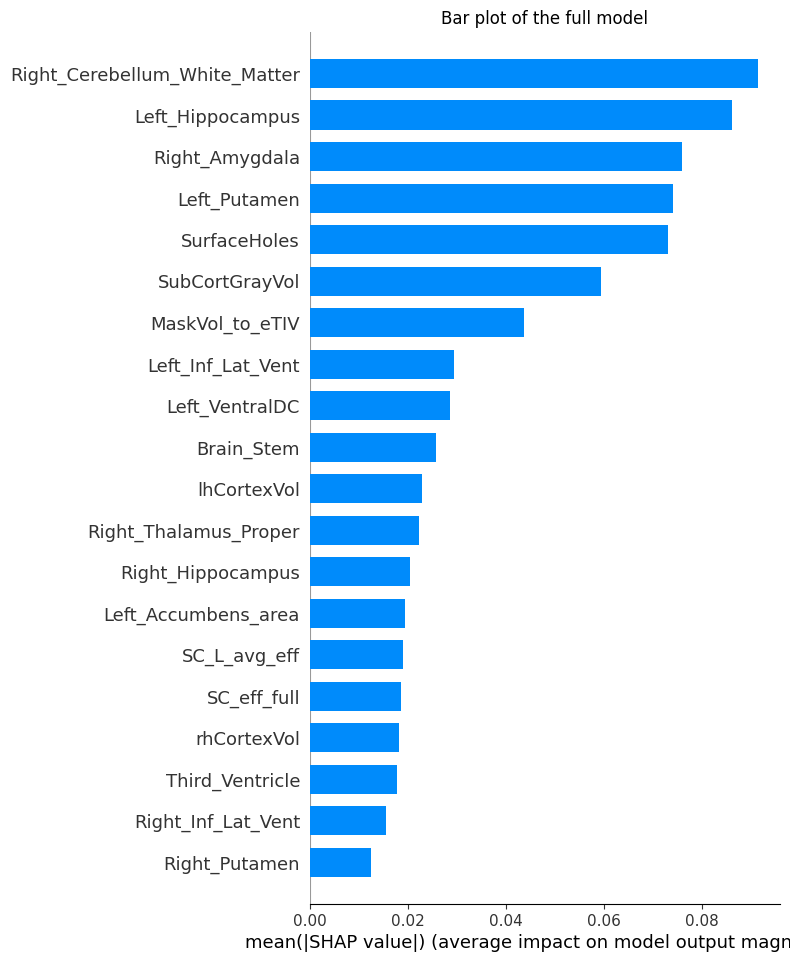

In [ ]:
shap.summary_plot(shap_values[1], X_2, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

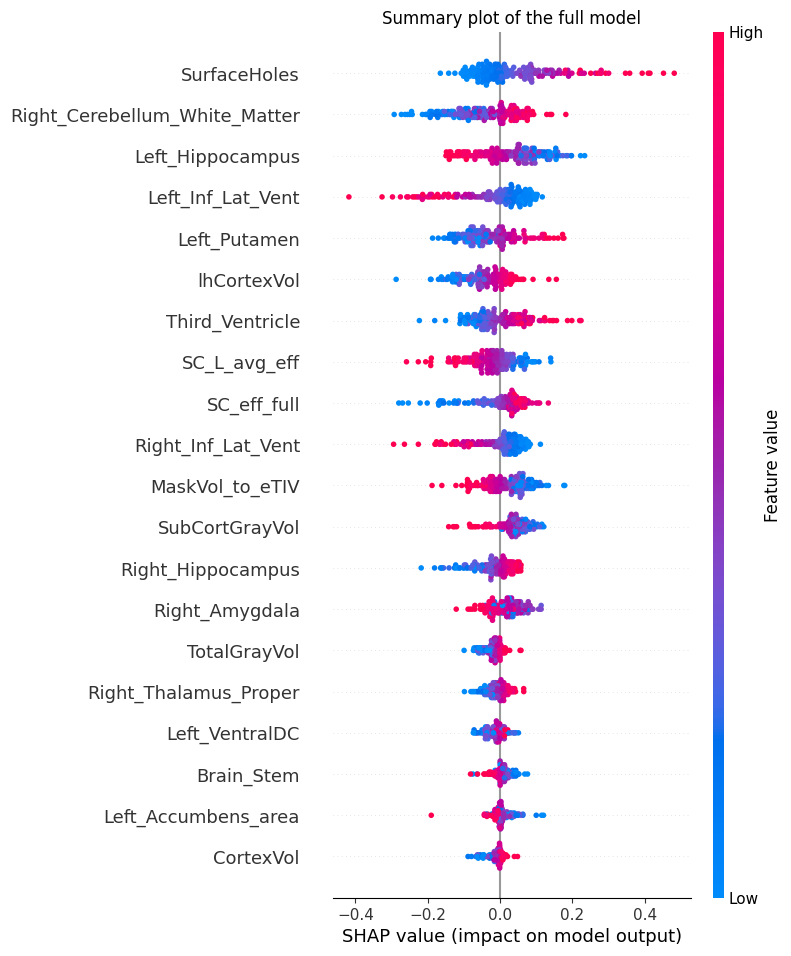

In [ ]:
shap.summary_plot(shap_values[2], X_2, show=False)
plt.title("Summary plot of the full model")
plt.show()

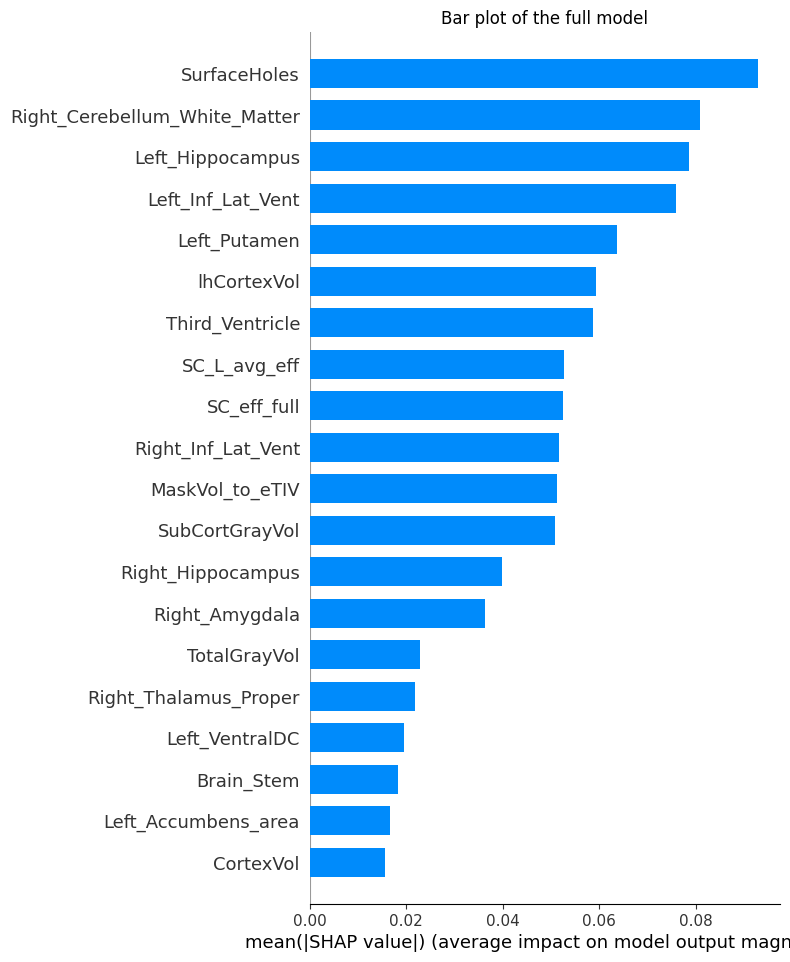

In [ ]:
shap.summary_plot(shap_values[2], X_2, plot_type="bar", show=False)
plt.title("Bar plot of the full model")
plt.show()

##Classification CN-AD with all

###Creation of the datasets

In [ ]:
x = matrices_cn_ad_all.drop(["group", "group_int", "Subject", "Age", "Sex", "Centre"], axis=1)
y = matrices_cn_ad_all[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex", "Centre"]
for i in matrices_cn_ad_all.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(matrices_cn_ad_all.columns)):
  if matrices_cn_ad_all.columns[i] not in not_matrices:
    if importances[j] > 0.09:
      final_columns.append(matrices_cn_ad_all.columns[i])
    j += 1

print(final_columns)

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


['Left_Lateral_Ventricle', 'Left_Inf_Lat_Vent', 'Third_Ventricle', 'Left_Hippocampus', 'Left_Amygdala', 'Right_Lateral_Ventricle', 'Right_Inf_Lat_Vent', 'Right_Thalamus_Proper', 'Right_Putamen', 'Right_Hippocampus', 'Right_Amygdala', 'WM_hypointensities', 'lhCortexVol', 'rhCortexVol', 'CortexVol', 'SubCortGrayVol', 'TotalGrayVol', 'BrainSegVol_to_eTIV', 'SurfaceHoles', 'Comm_ratio', 'SC_L_avg_eff', 'SC_R_avg_spl', 'SC_R_avg_eff', 'SC_avg_eff', 'CC_ratio', 'SC_spl_full', 'SC_eff_full', 'Full_CC']


In [ ]:
# dataset cn vs ad
#x = matrices_cn_ad_all.drop(["group", "group_int", "Subject", "Age", "Sex", "Centre"], axis=1)
x = matrices_cn_ad_all[final_columns]
y = matrices_cn_ad_all[["group_int"]]

x_train, x_test = train_test_split(x, test_size=0.3, random_state=42)
y_train, y_test = train_test_split(y, test_size=0.3, random_state=42)

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

X = X.values
Y = y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

In [ ]:
# dataset mci vs mci-ad
X_matrices_2 = matrices_mci_mciad_all[final_columns]
Y_matrices_2 = matrices_mci_mciad_all[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X_2 = scaler.fit_transform(X_matrices_2)
X_2 = pd.DataFrame(X_2)

X_2 = X_2.values
Y_2 = Y_matrices_2.values

In [ ]:
# dataset cn vs cn-ad
X_matrices_3 = matrices_cn_cnad_cnmci_all[final_columns]
Y_matrices_3 = matrices_cn_cnad_cnmci_all[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X_3 = scaler.fit_transform(X_matrices_3)
X_3 = pd.DataFrame(X_3)

X_3 = X_3.values
Y_3 = Y_matrices_3.values

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)
y_pred_2=xgboost_reg.predict(X_2)
y_pred_3=xgboost_reg.predict(X_3)

####Random Forest Results

In [ ]:
# Confusion Matrix CN-AD
print("Confusion Matrix CN-AD:")
print(confusion_matrix(y_test, y_pred))
print()
print("Classfication Report CN-AD:")
print()
print(classification_report(y_test, y_pred))

Confusion Matrix CN-AD:
[[19  0]
 [ 4  7]]

Classfication Report CN-AD:

              precision    recall  f1-score   support

         0.0       0.83      1.00      0.90        19
         1.0       1.00      0.64      0.78        11

    accuracy                           0.87        30
   macro avg       0.91      0.82      0.84        30
weighted avg       0.89      0.87      0.86        30



In [ ]:
# Confusion Matrix MCI-MCI-AD
print("Confusion Matrix MCI-MCI-AD:")
print(confusion_matrix(Y_2, y_pred_2))
print()
print("Classfication Report MCI-MCI-AD:")
print()
print(classification_report(Y_2, y_pred_2))

Confusion Matrix MCI-MCI-AD:
[[37 25]
 [ 7 15]]

Classfication Report MCI-MCI-AD:

              precision    recall  f1-score   support

         0.0       0.84      0.60      0.70        62
         1.0       0.38      0.68      0.48        22

    accuracy                           0.62        84
   macro avg       0.61      0.64      0.59        84
weighted avg       0.72      0.62      0.64        84



In [ ]:
# Confusion Matrix CN-CN-AD
print("Confusion Matrix CN-CN-AD:")
print(confusion_matrix(Y_3, y_pred_3))
print()
print("Classfication Report CN-CN-AD:")
print()
print(classification_report(Y_3, y_pred_3))

Confusion Matrix CN-CN-AD:
[[47 13]
 [ 9  6]]

Classfication Report CN-CN-AD:

              precision    recall  f1-score   support

         0.0       0.84      0.78      0.81        60
         1.0       0.32      0.40      0.35        15

    accuracy                           0.71        75
   macro avg       0.58      0.59      0.58        75
weighted avg       0.73      0.71      0.72        75



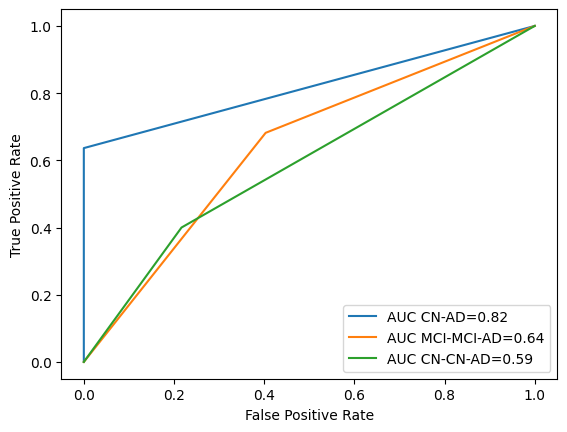

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

fpr_2, tpr_2, _ = metrics.roc_curve(Y_2,  y_pred_2)
auc_2 = metrics.roc_auc_score(Y_2, y_pred_2)

fpr_3, tpr_3, _ = metrics.roc_curve(Y_3,  y_pred_3)
auc_3 = metrics.roc_auc_score(Y_3, y_pred_3)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.plot(fpr_2,tpr_2,label="AUC MCI-MCI-AD="+str(round(auc_2, 2)))
plt.plot(fpr_3,tpr_3,label="AUC CN-CN-AD="+str(round(auc_3, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer=shap.Explainer(xgboost_reg)
shap_values_data=explainer(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


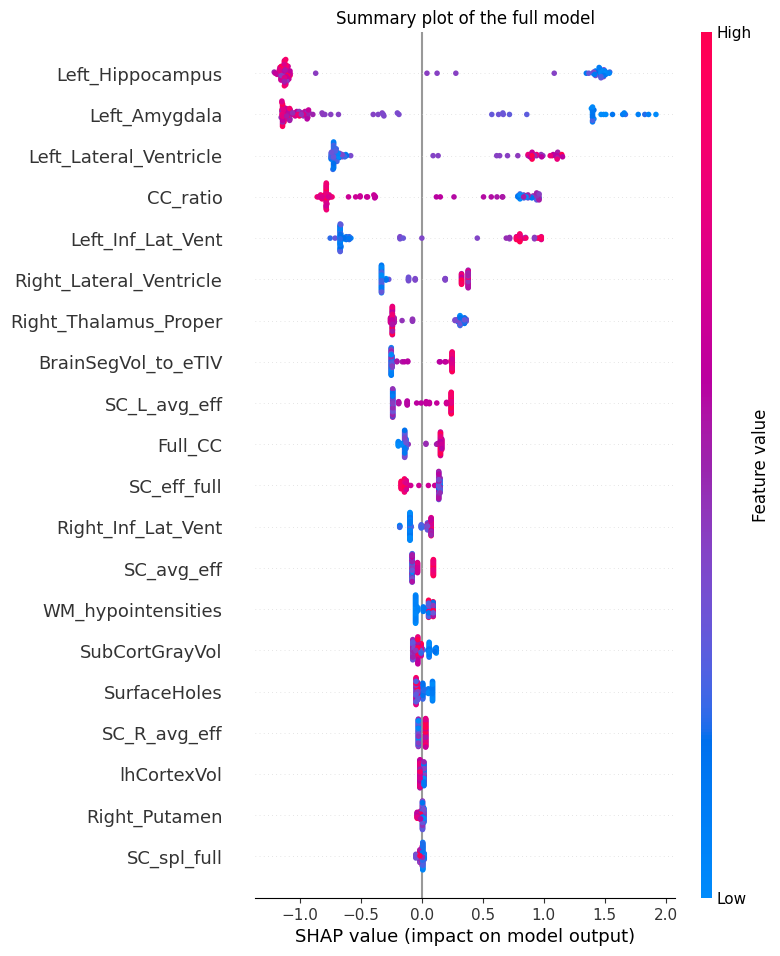

In [ ]:
shap.summary_plot(shap_values_data, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

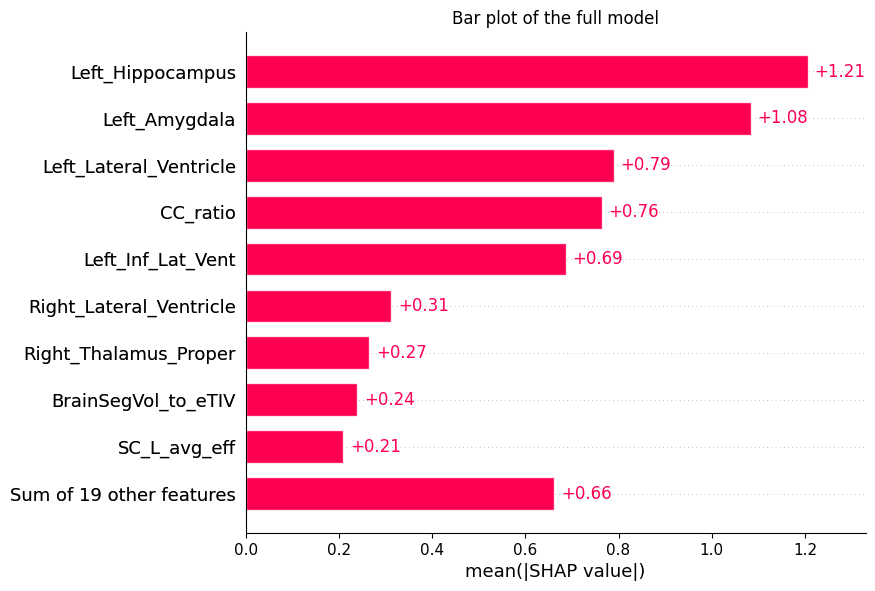

In [ ]:
shap.plots.bar(shap_values_data, show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network Models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(512, input_dim = 28, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001))) # Rectified Linear Unit Activation Function
    model.add(Dense(256, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(4, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(2, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001)))
    model.add(Dense(1, activation = 'sigmoid', kernel_regularizer=keras.regularizers.L1(0.0001),activity_regularizer=keras.regularizers.L2(0.0001))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.0003)
    model.compile(loss = 'binary_crossentropy', optimizer = optimizer, metrics = ['accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group_int"])["group_int"].count()

total = sum(y_distribution)

y_distribution

group_int
0.0    60
1.0    40
Name: group_int, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution[0]/(total)),
                1: 1/(y_distribution[1]/(total))}

model.fit(X_train, Y_train,
          batch_size=80,
          epochs=5000,
          verbose=1,
          callbacks=[callback],
          #class_weight=class_weight,
          validation_data=(X_test, Y_test))


Epoch 1/5000
1/1 [==============================] - 4s 4s/step - loss: 1.6655 - accuracy: 0.6000 - val_loss: 1.6600 - val_accuracy: 0.6333
Epoch 2/5000
1/1 [==============================] - 0s 89ms/step - loss: 1.6600 - accuracy: 0.5857 - val_loss: 1.6544 - val_accuracy: 0.6333
Epoch 3/5000
1/1 [==============================] - 0s 77ms/step - loss: 1.6544 - accuracy: 0.5857 - val_loss: 1.6488 - val_accuracy: 0.6333
Epoch 4/5000
1/1 [==============================] - 0s 75ms/step - loss: 1.6489 - accuracy: 0.5857 - val_loss: 1.6433 - val_accuracy: 0.6333
Epoch 5/5000
1/1 [==============================] - 0s 62ms/step - loss: 1.6434 - accuracy: 0.5857 - val_loss: 1.6377 - val_accuracy: 0.6333
Epoch 6/5000
1/1 [==============================] - 0s 60ms/step - loss: 1.6378 - accuracy: 0.5857 - val_loss: 1.6322 - val_accuracy: 0.6333
Epoch 7/5000
1/1 [==============================] - 0s 87ms/step - loss: 1.6323 - accuracy: 0.5857 - val_loss: 1.6267 - val_accuracy: 0.6333
Epoch 8/5000
1/

KeyboardInterrupt: ignored

In [ ]:
y_pred = model.predict(X_test)
y_pred_2 = model.predict(X_2)
y_pred_3 = model.predict(X_3)

3/3 [==============================] - 0s 4ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix CN-AD:")
print(confusion_matrix(Y_test, np.round(y_pred)))
print()
print("Classfication Report CN-AD:")
print()
print(classification_report(Y_test, np.round(y_pred)))

Confusion Matrix CN-AD:
[[18  1]
 [ 1 10]]

Classfication Report CN-AD:

              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95        19
         1.0       0.91      0.91      0.91        11

    accuracy                           0.93        30
   macro avg       0.93      0.93      0.93        30
weighted avg       0.93      0.93      0.93        30



In [ ]:
print("Confusion Matrix MCI-MCI-AD:")
print(confusion_matrix(Y_2, np.round(y_pred_2)))
print()
print("Classfication Report MCI-MCI-AD:")
print()
print(classification_report(Y_2, np.round(y_pred_2)))

Confusion Matrix MCI-MCI-AD:
[[34 28]
 [ 1 21]]

Classfication Report MCI-MCI-AD:

              precision    recall  f1-score   support

         0.0       0.97      0.55      0.70        62
         1.0       0.43      0.95      0.59        22

    accuracy                           0.65        84
   macro avg       0.70      0.75      0.65        84
weighted avg       0.83      0.65      0.67        84



In [ ]:
print("Confusion Matrix CN-CN-AD:")
print(confusion_matrix(Y_3, np.round(y_pred_3)))
print()
print("Classfication Report CN-CN-AD:")
print()
print(classification_report(Y_3, np.round(y_pred_3)))

Confusion Matrix CN-CN-AD:
[[45 15]
 [ 8  7]]

Classfication Report CN-CN-AD:

              precision    recall  f1-score   support

         0.0       0.85      0.75      0.80        60
         1.0       0.32      0.47      0.38        15

    accuracy                           0.69        75
   macro avg       0.58      0.61      0.59        75
weighted avg       0.74      0.69      0.71        75



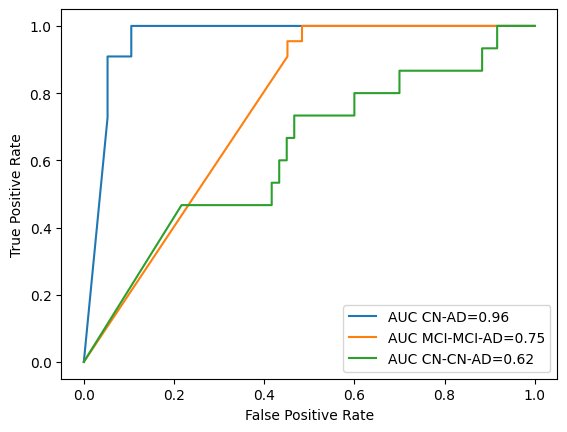

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

fpr_2, tpr_2, _ = metrics.roc_curve(Y_2,  y_pred_2)
auc_2 = metrics.roc_auc_score(Y_2, y_pred_2)

fpr_3, tpr_3, _ = metrics.roc_curve(Y_3,  y_pred_3)
auc_3 = metrics.roc_auc_score(Y_3, y_pred_3)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.plot(fpr_2,tpr_2,label="AUC MCI-MCI-AD="+str(round(auc_2, 2)))
plt.plot(fpr_3,tpr_3,label="AUC CN-CN-AD="+str(round(auc_3, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

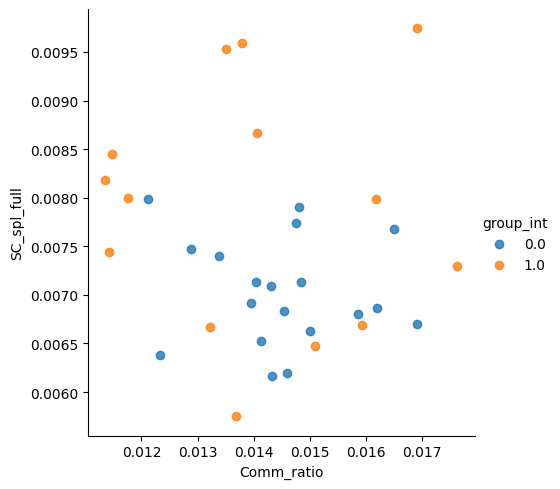

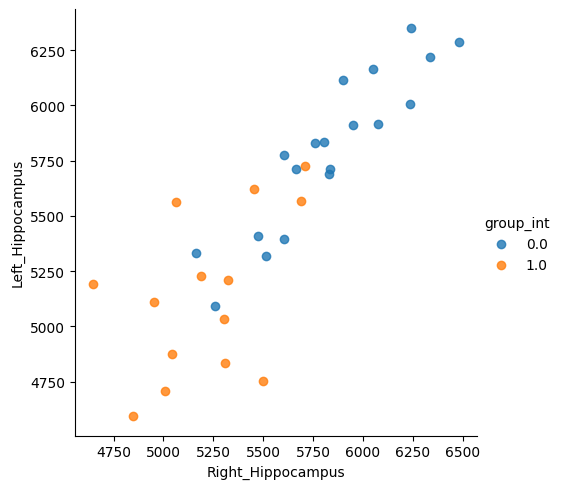

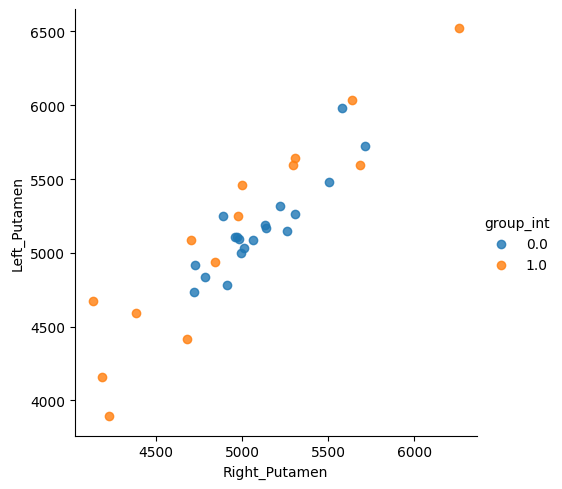

In [ ]:
result = pd.concat([x_test, y_test], axis=1)

sns.lmplot(x="Comm_ratio", y="SC_spl_full", data=result, hue='group_int', fit_reg=False)
plt.show()
sns.lmplot(x="Right_Hippocampus", y="Left_Hippocampus", data=result, hue='group_int', fit_reg=False)
plt.show()
sns.lmplot(x="Right_Putamen", y="Left_Putamen", data=result, hue='group_int', fit_reg=False)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 33ms/step


  0%|          | 0/100 [00:00<?, ?it/s]

658/658 [==============================] - 2s 3ms/step


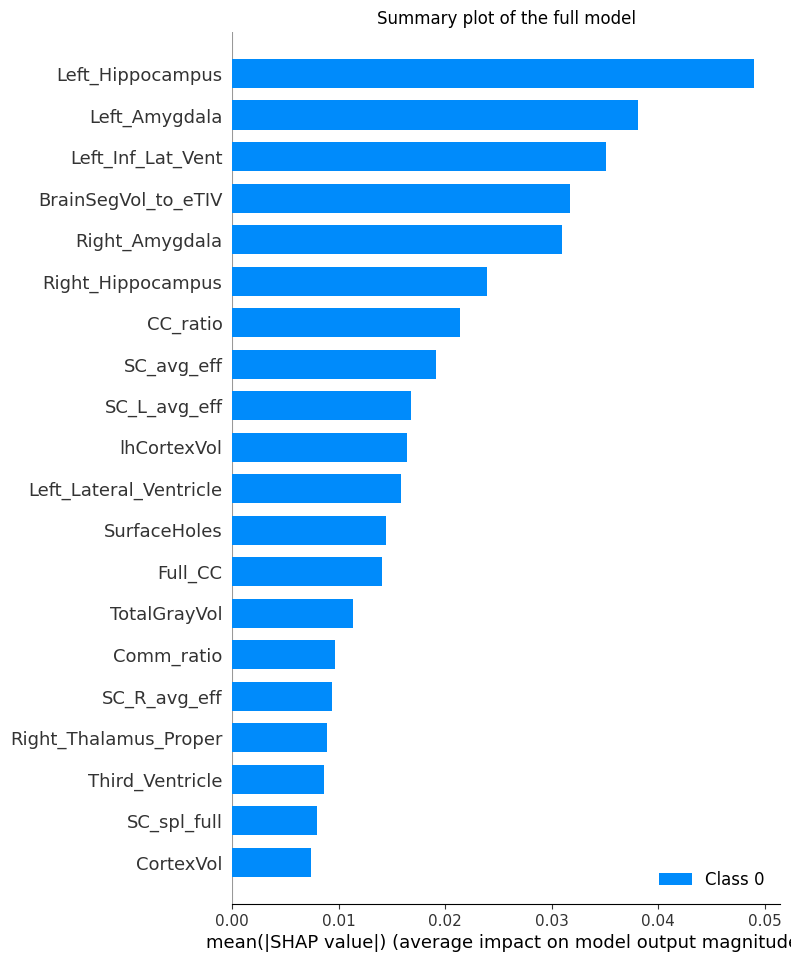

In [ ]:
shap.summary_plot(shap_values, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

##Classification with CN CN-MCI with all

###Creation of datasets

In [ ]:
x = matrices_cn_cnad_cnmci_all.drop(["group", "group_int", "Subject", "Age", "Sex", "Centre"], axis=1)
y = matrices_cn_cnad_cnmci_all[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex", "Centre"]
for i in matrices_cn_cnad_cnmci_all.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(matrices_cn_cnad_cnmci_all.columns)):
  if matrices_cn_cnad_cnmci_all.columns[i] not in not_matrices:
    if importances[j] > 0.04:
      final_columns.append(matrices_cn_cnad_cnmci_all.columns[i])
    j += 1

print(final_columns)

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


['Left_Pallidum', 'CSF', 'Left_Accumbens_area', 'Right_Inf_Lat_Vent', 'Right_Cerebellum_White_Matter', 'Right_Thalamus_Proper', 'Right_Putamen', 'Right_VentralDC', 'CortexVol', 'SubCortGrayVol', 'MaskVol_to_eTIV', 'lhSurfaceHoles', 'Comm_ratio', 'SC_avg_eff', 'CC_Sag_area', 'CC_Central', 'CC_Mid_Anterior', 'SC_eff_full', 'Full_CC', 'CC_Sag_area_sqrt']


In [ ]:
x = matrices_cn_cnad_cnmci_all[final_columns]
y = matrices_cn_cnad_cnmci_all[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
y_train, y_test = train_test_split(y, test_size=0.3, random_state=42)

X = X.values
Y = y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)

####Random Forest Results

In [ ]:
# Confusion Matrix CN-CN-MCI-CN-AD
print("Confusion Matrix:")
print(confusion_matrix(Y_test, y_pred))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, y_pred))

Confusion Matrix:
[[18  2]
 [ 1  3]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.95      0.90      0.92        20
         1.0       0.60      0.75      0.67         4

    accuracy                           0.88        24
   macro avg       0.77      0.82      0.79        24
weighted avg       0.89      0.88      0.88        24



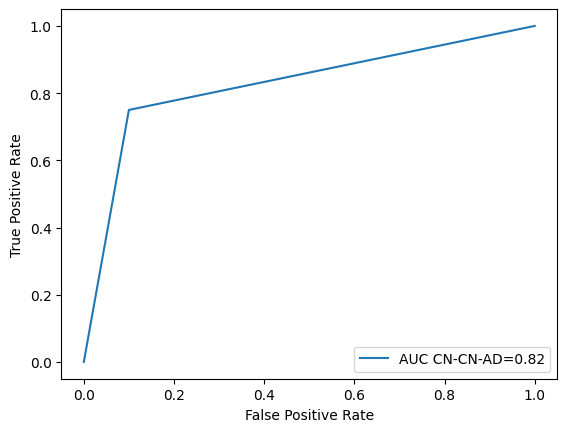

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-CN-AD="+str(round(auc, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer=shap.Explainer(xgboost_reg)
shap_values_data=explainer(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


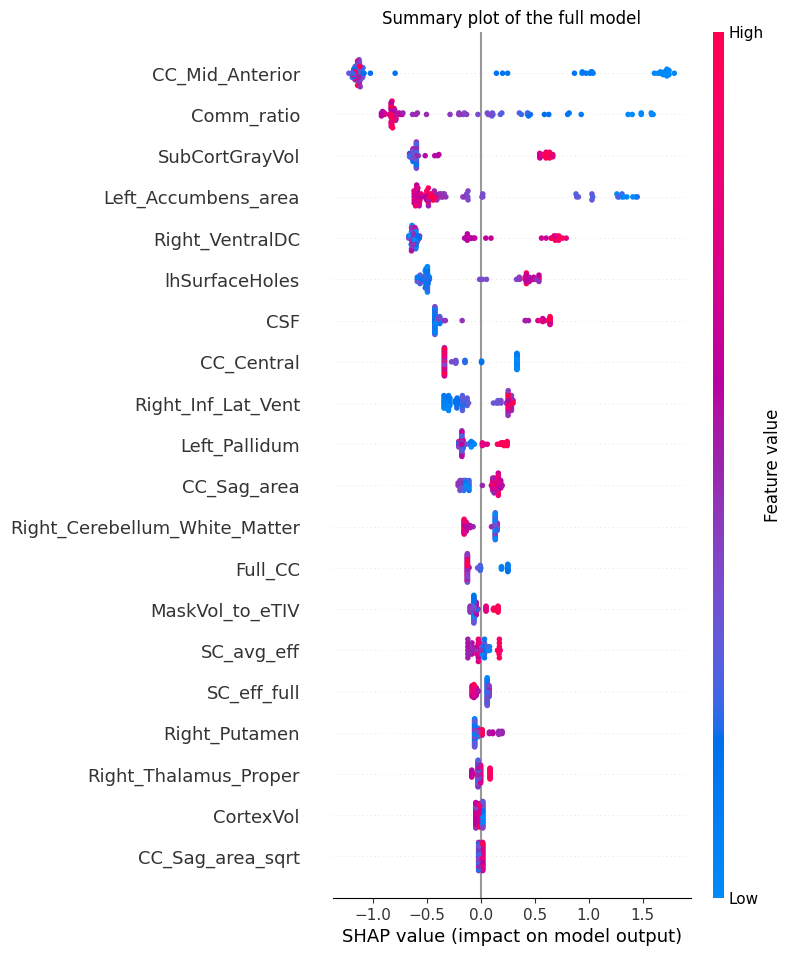

In [ ]:
shap.summary_plot(shap_values_data, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

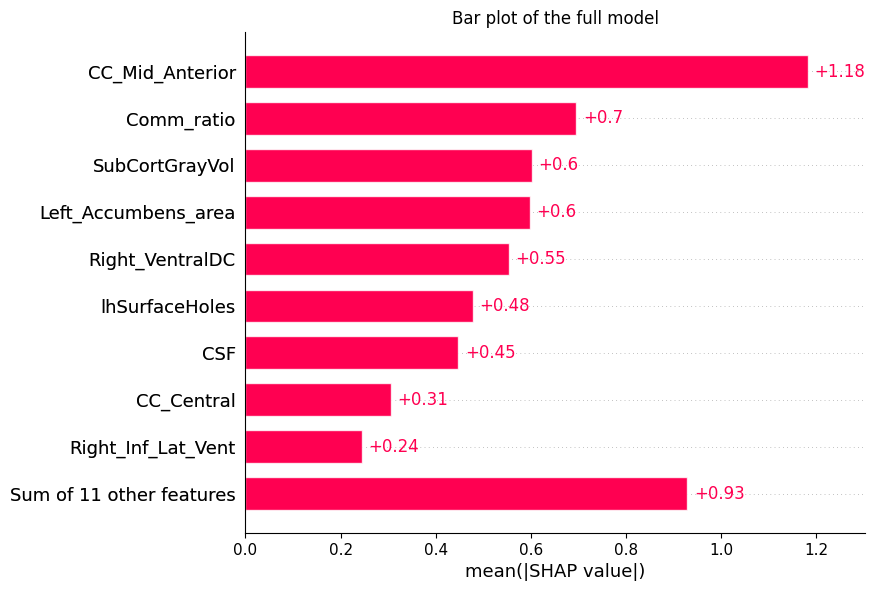

In [ ]:
shap.plots.bar(shap_values_data, show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(256, input_dim = 22, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006))) # Rectified Linear Unit Activation Function
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(4, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(2, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006)))
    model.add(Dense(1, activation = 'sigmoid', kernel_regularizer=keras.regularizers.L1(0.0006),activity_regularizer=keras.regularizers.L2(0.0006))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.00008)
    model.compile(loss = 'binary_crossentropy', optimizer = optimizer, metrics = ['accuracy'])
    return model

In [ ]:
y_distribution = y_train.groupby(["group_int"])["group_int"].count()

total = sum(y_distribution)

y_distribution

group_int
0.0    43
1.0    11
Name: group_int, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution[0]/(total)),
                1: 1/(y_distribution[1]/(total))}

model.fit(X_train, Y_train,
          batch_size=40,
          epochs=5000,
          verbose=1,
          callbacks=[callback],
          class_weight=class_weight,
          validation_data=(X_test, Y_test))


Se han truncado las últimas 5000 líneas del flujo de salida.
2/2 [==============================] - 0s 43ms/step - loss: 1.9619 - accuracy: 1.0000 - val_loss: 1.6209 - val_accuracy: 0.8333
Epoch 398/5000
2/2 [==============================] - 0s 48ms/step - loss: 1.9600 - accuracy: 1.0000 - val_loss: 1.6188 - val_accuracy: 0.8333
Epoch 399/5000
2/2 [==============================] - 0s 61ms/step - loss: 1.9584 - accuracy: 1.0000 - val_loss: 1.6165 - val_accuracy: 0.8333
Epoch 400/5000
2/2 [==============================] - 0s 47ms/step - loss: 1.9564 - accuracy: 1.0000 - val_loss: 1.6140 - val_accuracy: 0.8333
Epoch 401/5000
2/2 [==============================] - 0s 63ms/step - loss: 1.9539 - accuracy: 1.0000 - val_loss: 1.6122 - val_accuracy: 0.8333
Epoch 402/5000
2/2 [==============================] - 0s 80ms/step - loss: 1.9519 - accuracy: 1.0000 - val_loss: 1.6108 - val_accuracy: 0.8333
Epoch 403/5000
2/2 [==============================] - 0s 43ms/step - loss: 1.9500 - accuracy: 1.

In [ ]:
y_prediction = model.predict(X_test)

1/1 [==============================] - 0s 168ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(Y_test, np.round(y_prediction)))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, np.round(y_prediction)))

Confusion Matrix:
[[19  1]
 [ 2  2]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.90      0.95      0.93        20
         1.0       0.67      0.50      0.57         4

    accuracy                           0.88        24
   macro avg       0.79      0.72      0.75        24
weighted avg       0.87      0.88      0.87        24



In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(Y_test, np.round(y_prediction)))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, np.round(y_prediction)))

Confusion Matrix:
[[17  3]
 [ 2  2]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.89      0.85      0.87        20
         1.0       0.40      0.50      0.44         4

    accuracy                           0.79        24
   macro avg       0.65      0.68      0.66        24
weighted avg       0.81      0.79      0.80        24



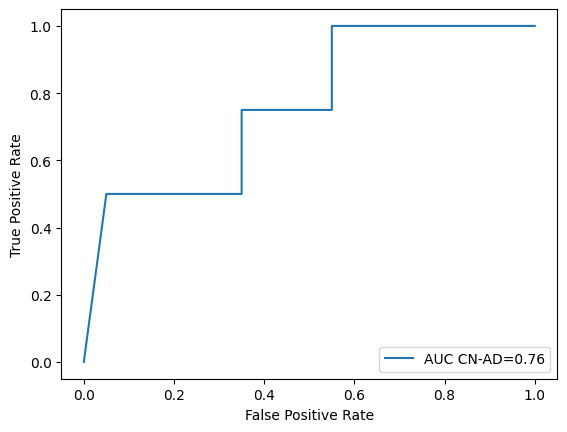

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_prediction)
auc = metrics.roc_auc_score(Y_test, y_prediction)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 35ms/step


  0%|          | 0/78 [00:00<?, ?it/s]

653/653 [==============================] - 1s 2ms/step


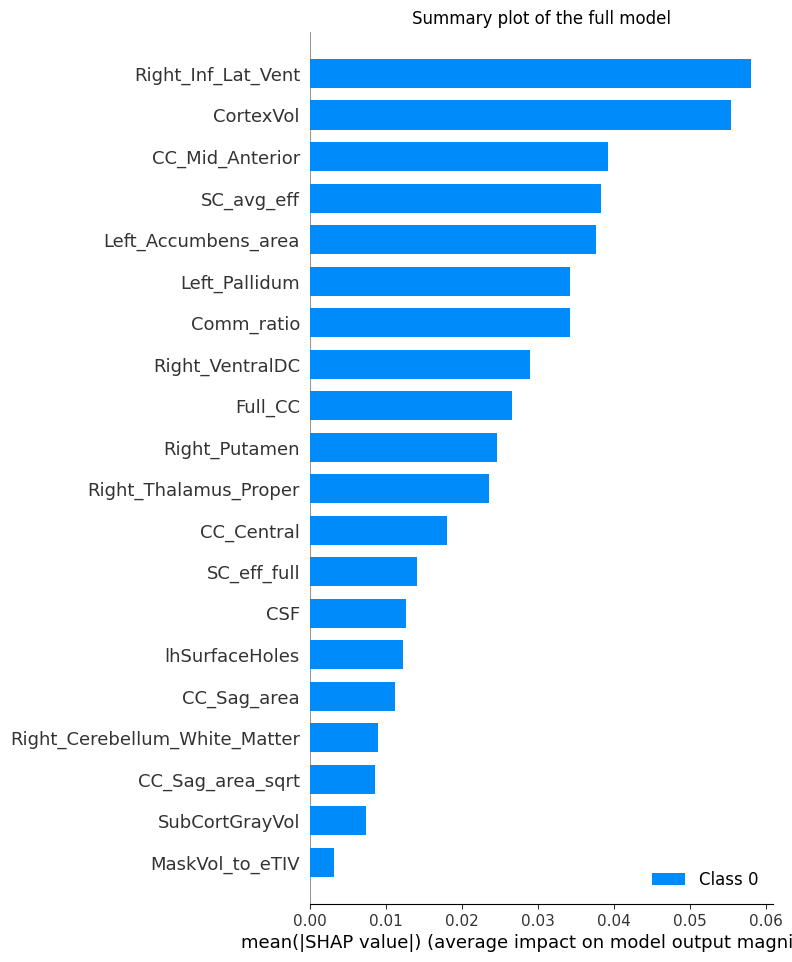

In [ ]:
shap.summary_plot(shap_values, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

##Classification with MCI MCI-AD with all


###Creation of datasets

In [ ]:
x = matrices_mci_mciad_all.drop(["group", "group_int", "Subject", "Age", "Sex", "Centre"], axis=1)
y = matrices_mci_mciad_all[["group"]]

columns = []
not_matrices = ["group", "group_int", "Subject", "Age", "Sex", "Centre"]
for i in matrices_mci_mciad_all.columns:
  if i not in not_matrices:
    columns.append(i)

importances = mutual_info_classif(x, y)

final_columns = []
j = 0

for i in range(0, len(matrices_mci_mciad_all.columns)):
  if matrices_mci_mciad_all.columns[i] not in not_matrices:
    if importances[j] > 0.07:
      final_columns.append(matrices_mci_mciad_all.columns[i])
    j += 1

print(final_columns)

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


['Left_Putamen', 'Brain_Stem', 'Left_Hippocampus', 'Right_Pallidum', 'Right_Hippocampus', 'Right_Amygdala', 'WM_hypointensities', 'lhCortexVol', 'rhCortexVol', 'rhCerebralWhiteMatterVol', 'TotalGrayVol', 'SupraTentorialVolNotVent', 'SupraTentorialVolNotVentVox', 'MaskVol', 'lhSurfaceHoles', 'rhSurfaceHoles', 'SC_avg_spl']


In [ ]:
x = matrices_mci_mciad_all[final_columns]
y = matrices_mci_mciad_all[["group_int"]]

scaler = MinMaxScaler(feature_range=(0, 1))
X = scaler.fit_transform(x)
X = pd.DataFrame(X)

X = X.values
Y = y.values

X_train, X_test = train_test_split(X, test_size=0.3, random_state=42)
Y_train, Y_test = train_test_split(Y, test_size=0.3, random_state=42)

X = pd.DataFrame(X)
X.columns = x.columns

###Random Forest

####Random Forest Models

In [ ]:
xgboost_reg = XGBClassifier(n_estimators=10000, max_depth=5, eta=0.1, subsample=0.7, colsample_bytree=0.8)
xgboost_reg.fit(X_train, Y_train)

y_pred=xgboost_reg.predict(X_test)

####Random Forest Results

In [ ]:
# Confusion Matrix CN-CN-MCI-CN-AD
print("Confusion Matrix:")
print(confusion_matrix(Y_test, y_pred))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, y_pred))

Confusion Matrix:
[[17  3]
 [ 3  3]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.85      0.85      0.85        20
         1.0       0.50      0.50      0.50         6

    accuracy                           0.77        26
   macro avg       0.68      0.68      0.68        26
weighted avg       0.77      0.77      0.77        26



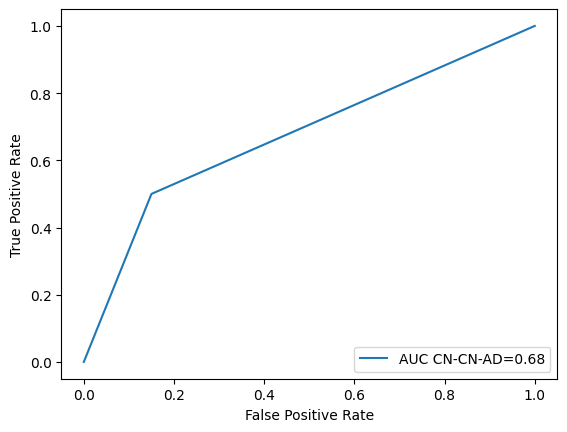

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_pred)
auc = metrics.roc_auc_score(Y_test, y_pred)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-CN-AD="+str(round(auc, 2)))

plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer=shap.Explainer(xgboost_reg)
shap_values_data=explainer(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


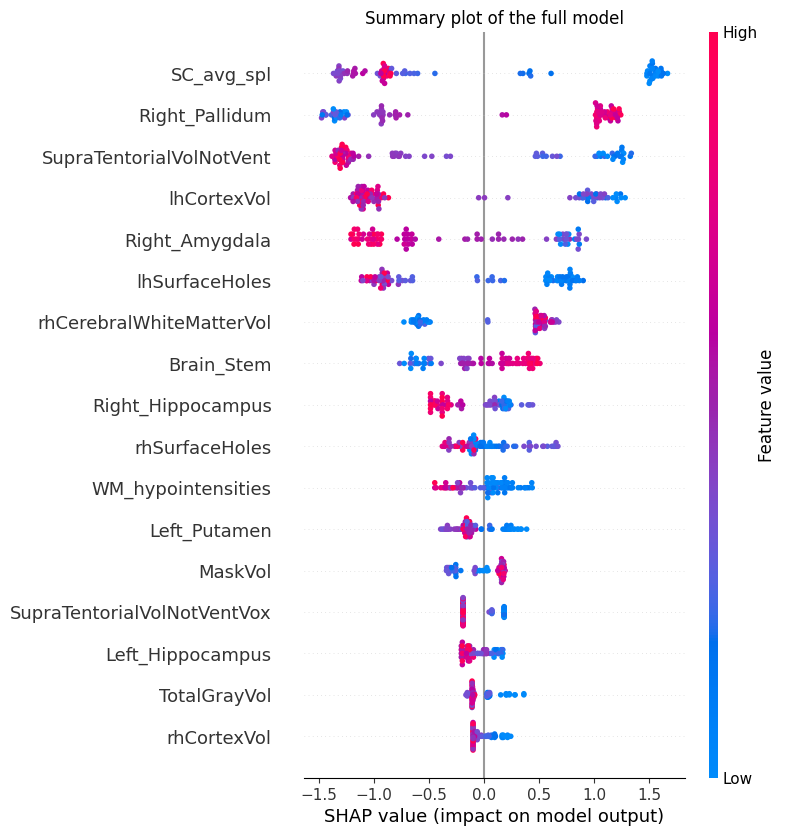

In [ ]:
shap.summary_plot(shap_values_data, X, show=False)
plt.title("Summary plot of the full model")
plt.show()

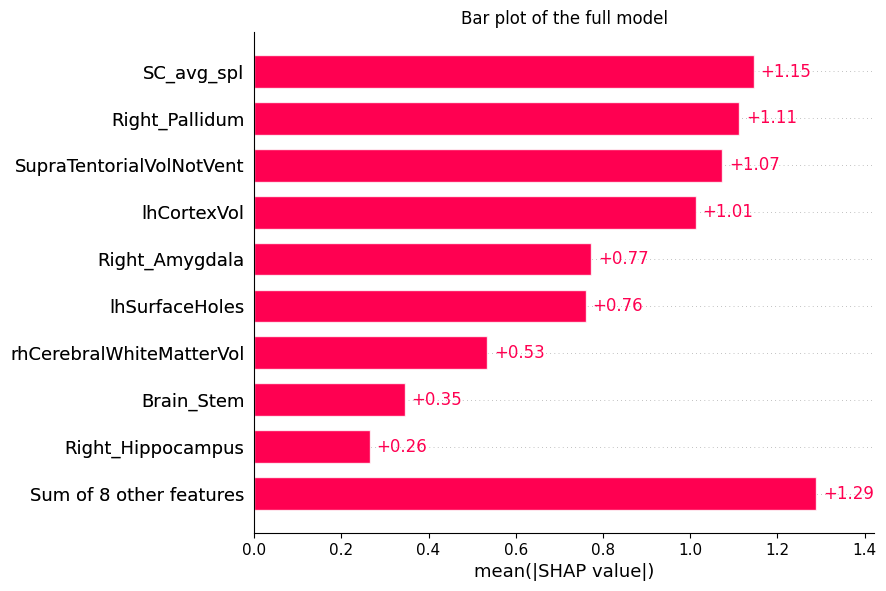

In [ ]:
shap.plots.bar(shap_values_data, show=False)
plt.title("Bar plot of the full model")
plt.show()

###Neural Network

####Neural Network models

In [ ]:
def baseline_model():
    # Create model here
    model = Sequential()
    model.add(Dense(256, input_dim = 17, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003))) # Rectified Linear Unit Activation Function
    model.add(Dense(128, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(64, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(32, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(16, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(8, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(4, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(2, activation = 'relu', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003)))
    model.add(Dense(1, activation = 'sigmoid', kernel_regularizer=keras.regularizers.L1(0.0003),activity_regularizer=keras.regularizers.L2(0.0003))) # Softmax for multi-class classification
    # Compile model here
    optimizer = keras.optimizers.Adam(learning_rate=0.00009)
    model.compile(loss = 'binary_crossentropy', optimizer = optimizer, metrics = ['accuracy'])
    return model

In [ ]:
y_distribution = y.groupby(["group_int"])["group_int"].count()

total = sum(y_distribution)

y_distribution

group_int
0.0    62
1.0    22
Name: group_int, dtype: int64

In [ ]:
model = baseline_model()

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

class_weight = {0: 1/(y_distribution[0]/(total)),
                1: 1/(y_distribution[1]/(total))}

model.fit(X_train, Y_train,
          batch_size=40,
          epochs=900,
          verbose=1,
          callbacks=[callback],
          #class_weight=class_weight,
          validation_data=(X_test, Y_test))


Epoch 1/900
2/2 [==============================] - 2s 344ms/step - loss: 1.7440 - accuracy: 0.2586 - val_loss: 1.7419 - val_accuracy: 0.1923
Epoch 2/900
2/2 [==============================] - 0s 31ms/step - loss: 1.7413 - accuracy: 0.2759 - val_loss: 1.7392 - val_accuracy: 0.1923
Epoch 3/900
2/2 [==============================] - 0s 49ms/step - loss: 1.7387 - accuracy: 0.2759 - val_loss: 1.7366 - val_accuracy: 0.2308
Epoch 4/900
2/2 [==============================] - 0s 34ms/step - loss: 1.7360 - accuracy: 0.2586 - val_loss: 1.7340 - val_accuracy: 0.2308
Epoch 5/900
2/2 [==============================] - 0s 31ms/step - loss: 1.7334 - accuracy: 0.3793 - val_loss: 1.7313 - val_accuracy: 0.4231
Epoch 6/900
2/2 [==============================] - 0s 41ms/step - loss: 1.7307 - accuracy: 0.5172 - val_loss: 1.7287 - val_accuracy: 0.6538
Epoch 7/900
2/2 [==============================] - 0s 32ms/step - loss: 1.7281 - accuracy: 0.5172 - val_loss: 1.7261 - val_accuracy: 0.6923
Epoch 8/900
2/2 [==

In [ ]:
y_prediction = model.predict(X_test)

1/1 [==============================] - 0s 151ms/step


####Neural Network Results

In [ ]:
print("Confusion Matrix:")
print(confusion_matrix(Y_test, np.round(y_prediction)))
print()
print("Classfication Report:")
print()
print(classification_report(Y_test, np.round(y_prediction)))

Confusion Matrix:
[[20  0]
 [ 2  4]]

Classfication Report:

              precision    recall  f1-score   support

         0.0       0.91      1.00      0.95        20
         1.0       1.00      0.67      0.80         6

    accuracy                           0.92        26
   macro avg       0.95      0.83      0.88        26
weighted avg       0.93      0.92      0.92        26



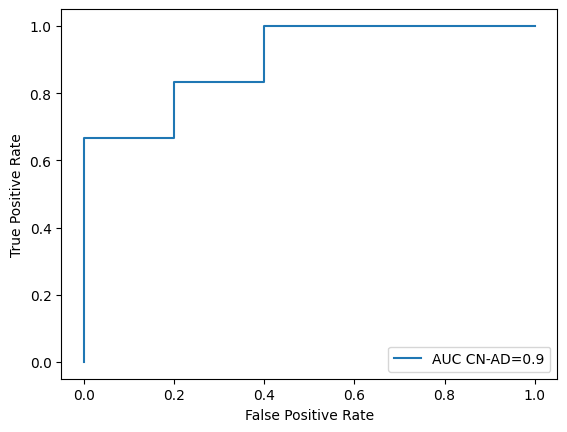

In [ ]:
fpr, tpr, _ = metrics.roc_curve(Y_test,  y_prediction)
auc = metrics.roc_auc_score(Y_test, y_prediction)

#create ROC curve
plt.plot(fpr,tpr,label="AUC CN-AD="+str(round(auc, 2)))
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

####Shap Values

In [ ]:
shap.initjs()
explainer = shap.KernelExplainer(model.predict, shap.sample(X, 10))
shap_values = explainer.shap_values(X)

1/1 [==============================] - 0s 27ms/step


  0%|          | 0/84 [00:00<?, ?it/s]

651/651 [==============================] - 1s 1ms/step


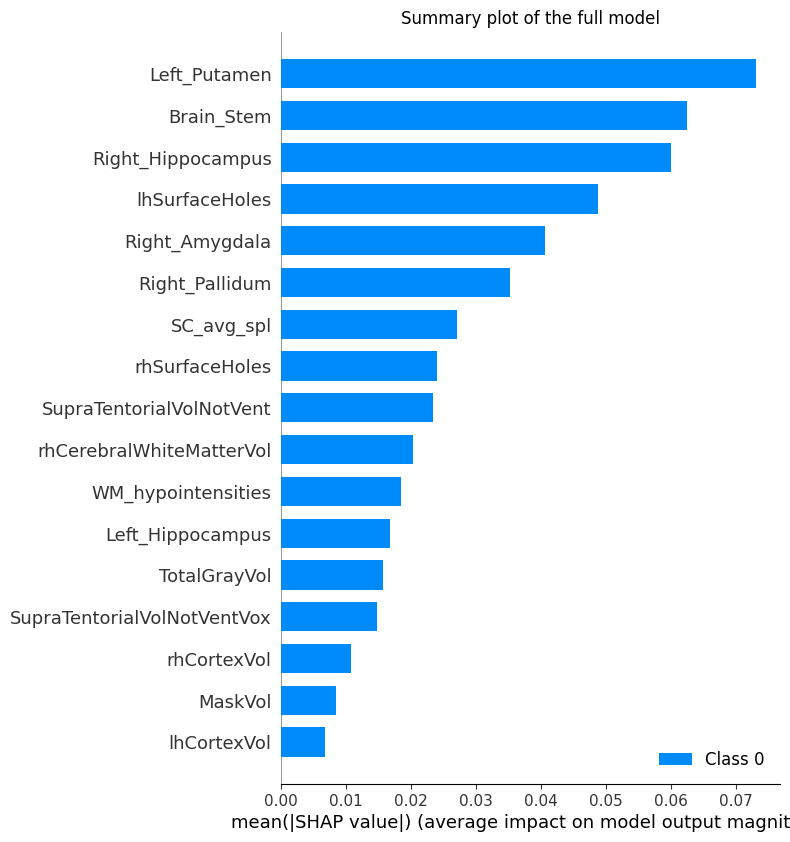

In [ ]:
shap.summary_plot(shap_values, X, show=False)
plt.title("Summary plot of the full model")
plt.show()